In [1]:
%pylab inline
import pandas as pd
import scipy.stats as stats
import glob as glob
import scipy.cluster.hierarchy as clust
import scipy.stats as stats
import os as os
rcParams['pdf.fonttype']=42
rcParams['font.size']=14

Populating the interactive namespace from numpy and matplotlib


In [2]:
bf = pd.read_csv('../Avana20Q2_data_with_CCLE_IDs.txt', index_col=0, sep="\t")

In [3]:
bf.shape

(18111, 659)

In [4]:
bf.head()

,CALU1_LUNG,HUCCT1_BILIARY_TRACT,KMRC20_KIDNEY,253J_URINARY_TRACT,RAJI_HAEMATOPOIETIC_AND_LYMPHOID_TISSUE,HCC2429_LUNG,YD38_UPPER_AERODIGESTIVE_TRACT,MHHNB11_AUTONOMIC_GANGLIA,ESS1_ENDOMETRIUM,TFK1_BILIARY_TRACT,...,UACC257_SKIN,AU565_BREAST,HEC1_ENDOMETRIUM,MEC1_HAEMATOPOIETIC_AND_LYMPHOID_TISSUE,NCIH522_LUNG,DOTC24510_CERVIX,MERO82_PLEURA,MEL290_UVEA,ICC106_BILIARY_TRACT,PECAPJ41CLONED2_UPPER_AERODIGESTIVE_TRACT
A1BG,-22.015,-16.591,-21.307,-15.856,-16.258,-14.497,-15.352,-18.578,-10.537,-25.080,...,-3.556,-8.869,-19.276,-17.635,-2.854,-26.693,-9.323,-25.026,-26.251,-17.701
A1CF,-47.060,-18.895,-26.172,-12.448,-17.446,-8.172,-11.898,-24.322,-16.476,-34.396,...,-8.674,-13.703,-20.240,-22.125,-8.422,-25.009,-7.187,-20.434,-24.472,-11.012
A2M,-19.829,-11.047,-17.706,-8.766,-15.336,-8.104,-10.438,-7.648,-16.074,-23.963,...,-4.219,-2.800,-19.603,-18.759,-4.591,-26.254,-4.848,-26.913,-21.061,-8.956
A2ML1,-28.154,-23.691,-25.717,-15.747,-23.090,-9.030,-11.832,-16.182,-23.864,-30.493,...,-8.031,-16.233,-22.813,-9.454,-6.728,-35.078,-6.486,-21.051,-31.189,-16.949
A3GALT2,-32.328,-31.929,-26.826,-11.024,-21.150,-12.258,-15.324,-24.551,-18.677,-28.148,...,-9.354,-20.133,-17.622,-14.150,-9.620,-26.834,-3.331,-16.657,-28.814,-12.737


In [5]:
transposed_bf=bf.T
tissues = dict()
for cell_line in transposed_bf.index:
    if cell_line.split("_",1)[1] not in tissues:
        tissues[cell_line.split("_",1)[1]]=list()
    tissues[cell_line.split("_",1)[1]].append(cell_line)

In [6]:
for i in tissues.keys():
    print(str(i) +":"+ str(len(tissues[i])))

LUNG:88
BILIARY_TRACT:24
KIDNEY:18
URINARY_TRACT:25
HAEMATOPOIETIC_AND_LYMPHOID_TISSUE:65
UPPER_AERODIGESTIVE_TRACT:25
AUTONOMIC_GANGLIA:12
ENDOMETRIUM:19
CENTRAL_NERVOUS_SYSTEM:54
PANCREAS:32
PLEURA:8
LIVER:22
OESOPHAGUS:24
CERVIX:11
SKIN:45
LARGE_INTESTINE:25
OVARY:37
STOMACH:24
SOFT_TISSUE:33
BONE:22
BREAST:29
THYROID:7
SKIN_CJ2_RESISTANT:1
PLACENTA:2
SALIVARY_GLAND:2
UVEA:3
SKIN_CJ3_RESISTANT:1
SKIN_CJ1_RESISTANT:1


In [7]:
for i in tissues.keys():
    if len(tissues[i])>=16:
        print(str(i) +":"+ str(len(tissues[i])))

LUNG:88
BILIARY_TRACT:24
KIDNEY:18
URINARY_TRACT:25
HAEMATOPOIETIC_AND_LYMPHOID_TISSUE:65
UPPER_AERODIGESTIVE_TRACT:25
ENDOMETRIUM:19
CENTRAL_NERVOUS_SYSTEM:54
PANCREAS:32
LIVER:22
OESOPHAGUS:24
SKIN:45
LARGE_INTESTINE:25
OVARY:37
STOMACH:24
SOFT_TISSUE:33
BONE:22
BREAST:29


## Take 18 tissues with more than 16 cell lines

In [8]:
tissue_names=['BILIARY_TRACT', 'SOFT_TISSUE', 'URINARY_TRACT', 'PANCREAS', 'SKIN',
             'CENTRAL_NERVOUS_SYSTEM', 'BREAST', 'LUNG', 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE',
             'BONE', 'OVARY', 'OESOPHAGUS', 'LIVER','UPPER_AERODIGESTIVE_TRACT',
             'LARGE_INTESTINE', 'ENDOMETRIUM', 'STOMACH', 'KIDNEY']

              

In [9]:
len(tissue_names)

18

In [10]:
for i in tissue_names:
    globals()[i]=bf[tissues[i]]

In [11]:
def plot_cumulative_ess(bootstrapped_samples):
    

    ess_per_screen={}
    
    bootstrapped_samples1=bootstrapped_samples.copy()   
    bootstrapped_samples1[bootstrapped_samples1>=10]=10
    bootstrapped_samples1[bootstrapped_samples1<10]=0
    bootstrapped_samples1[bootstrapped_samples1>0]=1
    essential_count = bootstrapped_samples1.sum(1)
    numhits_per_screen = bootstrapped_samples1.sum(0)

    ess_per_screen= pd.DataFrame( index=bootstrapped_samples1.columns.values)
    ess_per_screen['Number_of_Hits_At_BF10']=numhits_per_screen

    #ess_per_screen.sort_values('Number_of_Hits_At_BF10', ascending=False,inplace=True) #ERROR HERE! We should not rank
    cumulative_essentials = {}

    numSamples, numCols = ess_per_screen.shape

    cumulative_essentials_count = zeros(numSamples)
    hits_per_screen=dict()
    for k in range(numSamples):
        s = ess_per_screen.index.values[k]
        hits = (bf.loc[:,s][bf.loc[:,s]>=10]).index
        hits_per_screen[s]=hits # get hits per screen
        for h in hits:
            cumulative_essentials[h] = 1
        cumulative_essentials_count[k] = len(cumulative_essentials.keys())
    
    

    return cumulative_essentials_count, ess_per_screen

In [15]:
#get only cumulative essentials by bootstrapping from all screens
bf_samples=pd.Series(bf.dtypes.index)
bf_data=bf.copy()
bootst=dict()
bootst_bf=dict()
bf_cumul_ess_count=dict()
bf_ess_per_sc=dict()

for i in range(100): # for 100 iterations 
    bootst[i] = bf_samples.sample(replace=False, n=8) #sample 16
    bootst_bf[i]=bf[bootst[i]]
              
        
    bf_cumul_ess_count[i]= (plot_cumulative_ess (bootst_bf[i])[0])
    bf_ess_per_sc[i]= (plot_cumulative_ess (bootst_bf[i])[1])
    
    
    
    

In [16]:
bf_cumulatives  = numpy.array([arr.tolist() for arr in bf_cumul_ess_count.values()])

### we had determined from previous ipynb (Fig1_code.ipynb) that 1287 was the avg num of essentials across Avana screens

In [28]:
import string
import random
import secrets
csprng = random.SystemRandom()
from sklearn.metrics import mean_squared_error
from math import sqrt

In [29]:
#1) create random genes
def random_string( len = 6, charsets = string.ascii_uppercase+ string.digits):
    #return ''.join(csprng.choices(charsets, k = len))
    return ''.join(random.choice(charsets) for x in range(len)) 





In [30]:
#2) create a synthetic genome of N genes with n number of essentials and with precision but 
#sample fixed at sample_num genes (mean num of screens in top 8) 
def synthetic_gen_precision_tissue_sample(N, n, precision, sample_num): 
    synthetic_genome = [random_string() for _ in range(N)]
    synthetic_genome=pd.DataFrame(synthetic_genome)
    synthetic_genome.columns=(['GENE'])
    synthetic_genome=synthetic_genome.set_index(['GENE'])
    essentials= n * [1] # 1 means essential
    nonessentials= (N-n) * [2] #2 means non essential
    synthetic_genome['Essentiality']= essentials + nonessentials
    
    k=round(sample_num) # we will sample X genes out every time; some will be sampled from ess some noness
    
    sample_synthetic=dict()
    ess=round((precision)* sample_num)
    non_ess=round((sample_num) * (1-precision))

    for i in range(0,8): 
        if ess <= n :
            randsam_es=random.sample(set(synthetic_genome[synthetic_genome['Essentiality']==1].index), ess)
            randsam_nones=random.sample(set(synthetic_genome[synthetic_genome['Essentiality']==2].index), non_ess)
            randtotal= randsam_es + randsam_nones
            sample_synthetic[i]=randtotal
        else:
            random_es=list (synthetic_genome[synthetic_genome['Essentiality']==1].index) + random.sample(set(synthetic_genome[synthetic_genome['Essentiality']==2].index), (round(sample_num*precision)-n))
            random_nones=random.sample(set(synthetic_genome[synthetic_genome['Essentiality']==2].index), non_ess)
            randtotal=random_nones + random_es #sample from this instead of from es and nones
        
            sample_synthetic[i]=randtotal


    
    
    
    return sample_synthetic
    

In [31]:
def cumulative_essential_genes_8_screens (gene_dictionary):
    sample_synthetic_cumulative_essentials = {}
    numSamples, numCols = (8,1) 

    sample_synthetic_cumulative_essentials_count = zeros(numSamples)

    
    for i in range(0,numSamples):
        s= gene_dictionary[i] # list of genes
        hits= s #which are the hits
        for h in hits:
            sample_synthetic_cumulative_essentials[h] = 1
        sample_synthetic_cumulative_essentials_count[i] = len(sample_synthetic_cumulative_essentials.keys())
    return sample_synthetic_cumulative_essentials_count



In [32]:
def cumulative_plot_zoomed_8_screens(numSamples, cumulative_counts, labels):
    numSamples=arange(numSamples)
    figure( figsize(5,5))
    for i, j in zip(cumulative_counts,labels):
        plot( arange(1,9), i , label= j, marker='o', markersize=3) 
    plt.errorbar(arange(1,9), breast_cumulatives.mean(axis=0), yerr=breast_cumulatives.std(axis=0),  color='r', marker='o', lw=1, capsize=3, capthick=1, ecolor='red', label='Breast Cumulative Essentials')
    #plot( numSamples, breast_cumulatives.mean(axis=0) , color= 'r', marker='o', markersize=2, label='Avana Top 8 Screens') #bu eklendi
    #title('BREAST', size=16)
    xlim(0,9)
    
    xticks(arange(1,9),[1,2,3,4,5,6,7,8],size=14)
   
    ylim(1000,3500) 
    yticks(size=14)
    xlabel('Screen rank', size=16) 
    ylabel('Cumulative essentials', size=16) 
    #title('Cumulative essentials with FDR 10%')
    
    legend()
    
    show()

In [33]:
def get_rmse_from_beginning_8_screens(num_genome, num_essential, list_of_precision, sample_num):
    
    list_cumulatives=list()
    labelss=list()
    names=list()
    
    for i in list_of_precision:
        #synthetic_genome_test = synthetic_gen_precision(num_genome, num_essential)
        list_cumulatives.append(cumulative_essential_genes_8_screens(synthetic_gen_precision_tissue_sample(num_genome, num_essential, i, sample_num))) #make list of cumul. essentials
        labelss.append(i)
        
        rms=dict()
        names.append(i)
        
        
        for j,k in zip(list(list_cumulatives), names):
            rmse=dict()
            
            for l in our_data:
                
                rmse[l]=sqrt(mean_squared_error(j, our_data[l]))
            rms[k]=rmse   
        
    #print (cumulative_plot_all(276, list_cumulatives, labelss))
    print (cumulative_plot_zoomed_8_screens(8, list_cumulatives, labelss))
    return rms

In [34]:
def get_rmse_from_beginning_8_screens_MEAN(num_genome, num_essential, list_of_precision, sample_num):
    
    list_cumulatives=list()
    labelss=list()
    names=list()
    
    for i in list_of_precision:
        #synthetic_genome_test = synthetic_gen_precision(num_genome, num_essential)
        list_cumulatives.append(cumulative_essential_genes_8_screens(synthetic_gen_precision_tissue_sample(num_genome, num_essential, i, sample_num))) #make list of cumul. essentials
        labelss.append(i)
        
        rms=dict()
        names.append(i)
        
        our_data_mean=breast_cumulatives.mean(axis=0)
        for j,k in zip(list(list_cumulatives), names):
            rmse=sqrt(mean_squared_error(j, our_data_mean))
            rms[k]=rmse   
        
    #print (cumulative_plot_all(276, list_cumulatives, labelss))
    print (cumulative_plot_zoomed_8_screens(8, list_cumulatives, labelss))
    return rms

In [35]:
bf_tissues=[BILIARY_TRACT, ENDOMETRIUM, BREAST, LUNG, HAEMATOPOIETIC_AND_LYMPHOID_TISSUE, OESOPHAGUS,
             UPPER_AERODIGESTIVE_TRACT,URINARY_TRACT,SOFT_TISSUE, PANCREAS, SKIN, OVARY,
             LARGE_INTESTINE, BONE,CENTRAL_NERVOUS_SYSTEM, LIVER]

In [36]:
# get cumulative essentials per tissue with bootstrapping

In [37]:
for i in tissue_names:
    
    globals()['%s_samples' % i]=pd.Series(globals()['%s' % i].dtypes.index)
    globals()['%s_data' % i]=bf[tissues[i]]
    globals()['bootst_sam_%s' % i]=dict()
    globals()['bootst_%s' % i]=dict()
    globals()['%s_cumul_ess_count' % i]=dict()
    

    for j in range(100): # for 100 iterations 
        globals()['bootst_sam_%s' % i][j] = globals()['%s_samples' % i].sample(replace=False, n=8) #sample 16
        globals()['bootst_%s' % i][j]=globals()['%s_data' % i][globals()['bootst_sam_%s' % i][j]]
              
        
        globals()['%s_cumul_ess_count' % i][j]= (plot_cumulative_ess (globals()['bootst_%s' % i][j])[0])
   

In [38]:
for i in tissue_names:
    globals()['%s_cumulatives' % i]=numpy.array([arr.tolist() for arr in globals()['%s_cumul_ess_count' % i].values()])
    globals()['%s_cumulatives_means' % i]=globals()['%s_cumulatives' % i].mean(axis=0)
    globals()['%s_cumulatives_stds' % i]=globals()['%s_cumulatives' % i].std(axis=0)
    

In [39]:
#saves image
def cumulative_plot_zoomed_8_screens_TISSUES(numSamples, cumulative_counts, labels, tissue_names):
    
    numSamples=arange(numSamples)
    figure( figsize(5,5))
    for i, j in zip(cumulative_counts,labels):
        plot( arange(1,9), i , label= j, marker='o', markersize=3) 
    plt.errorbar(arange(1,9), globals()['%s_cumulatives_means' % tissue_names], yerr=globals()['%s_cumulatives_stds' % tissue_names],  color='r', marker='o', lw=1, capsize=3, capthick=1, ecolor='red', label=tissue_names + " Cumulative Essentials")
    #plot( numSamples, breast_cumulatives.mean(axis=0) , color= 'r', marker='o', markersize=2, label='Avana Top 8 Screens') #bu eklendi
    title("BF10_" + tissue_names , size=16)
    xlim(0,9)
    
    xticks(arange(1,9),[1,2,3,4,5,6,7,8],size=14)
   
    ylim(1000,3500) 
    yticks(size=14)
    xlabel('Screen rank', size=16) 
    ylabel('Cumulative essentials', size=16) 
    #title('Cumulative essentials with FDR 10%')
    
    legend()
    savefig("./model_figs_FIG1/BF10_" + tissue_names+ ".png", format='png', dpi=350, bbox_inches='tight')
    savefig( "./model_figs_FIG1/BF10_" + tissue_names+ ".pdf", format='pdf', bbox_inches='tight')
    show()



In [40]:
def get_rmse_from_beginning_8_screens_MEAN_tissues(num_genome, num_essential, list_of_precision, tissue_names, sample_num):
    
    list_cumulatives=list()
    labelss=list()
    names=list()
    
    for i in list_of_precision:
        #synthetic_genome_test = synthetic_gen_precision(num_genome, num_essential)
        list_cumulatives.append(cumulative_essential_genes_8_screens(synthetic_gen_precision_tissue_sample(num_genome, num_essential, i, sample_num))) #make list of cumul. essentials
        labelss.append(i)
        
        rms=dict()
        names.append(i)
        
        our_data_mean=globals()['%s_cumulatives_means' % tissue_names]
        for j,k in zip(list(list_cumulatives), names):
            rmse=sqrt(mean_squared_error(j, our_data_mean))
            rms[k]=rmse   
        
    #print (cumulative_plot_all(276, list_cumulatives, labelss))
    print (cumulative_plot_zoomed_8_screens_TISSUES(8, list_cumulatives, labelss, tissue_names))
    return rms

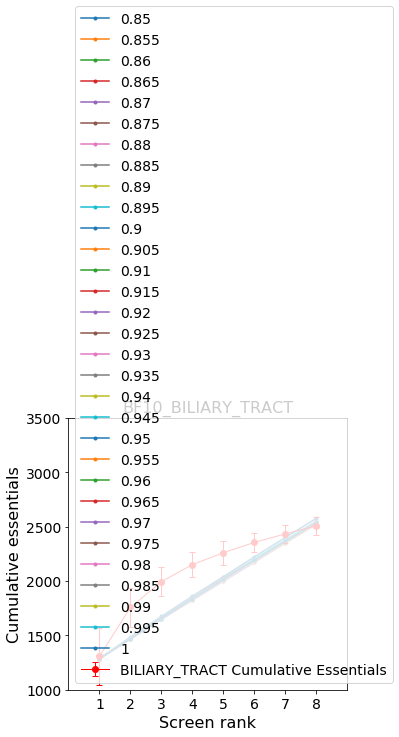

None


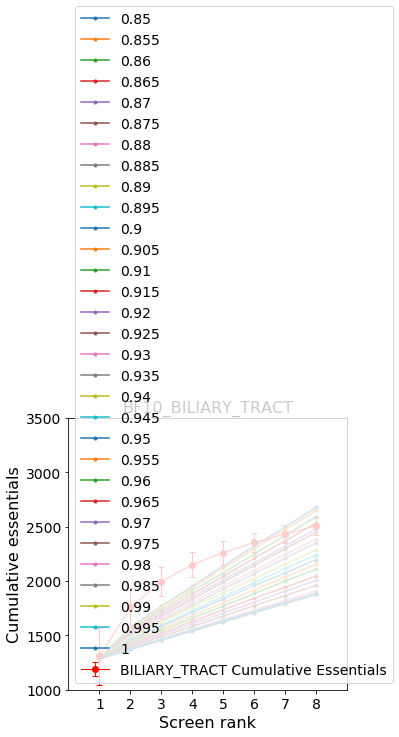

None


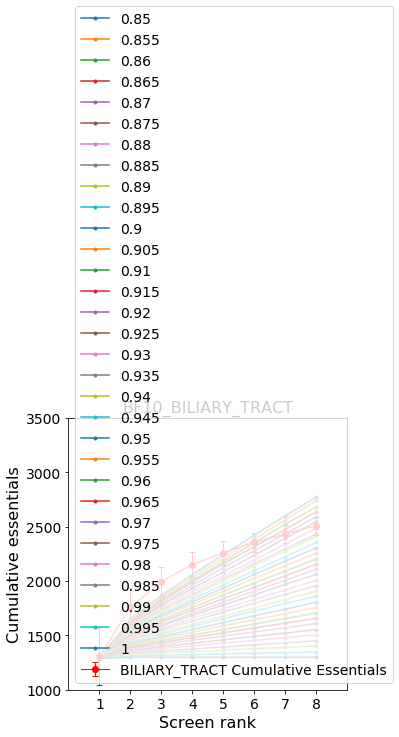

None


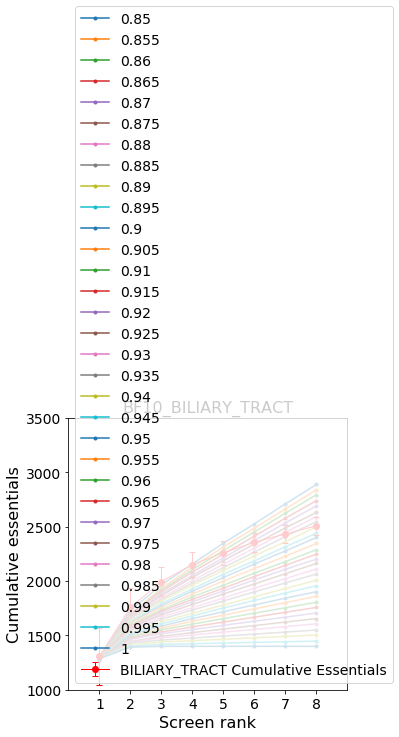

None


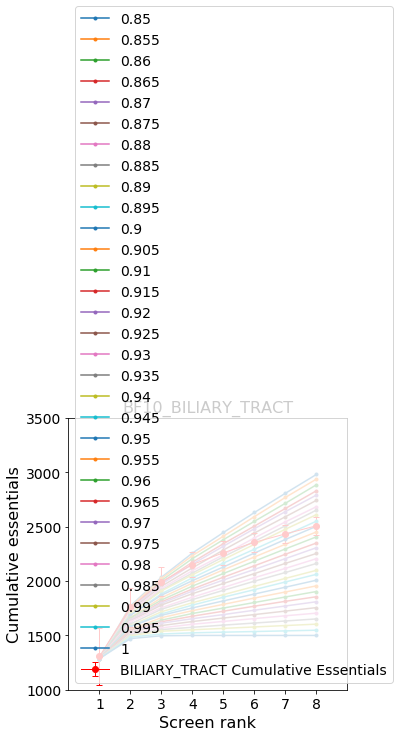

None


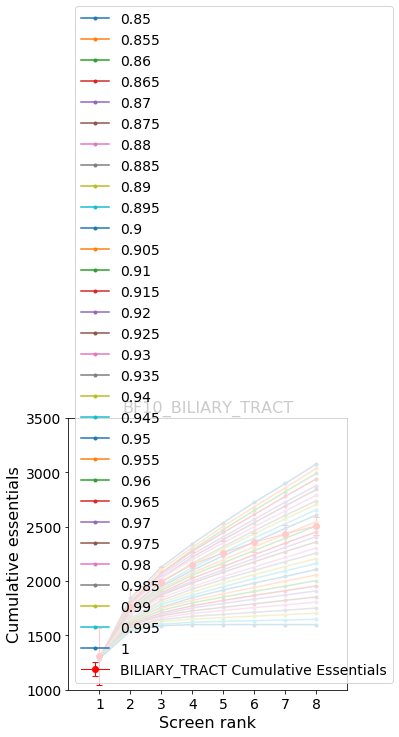

None


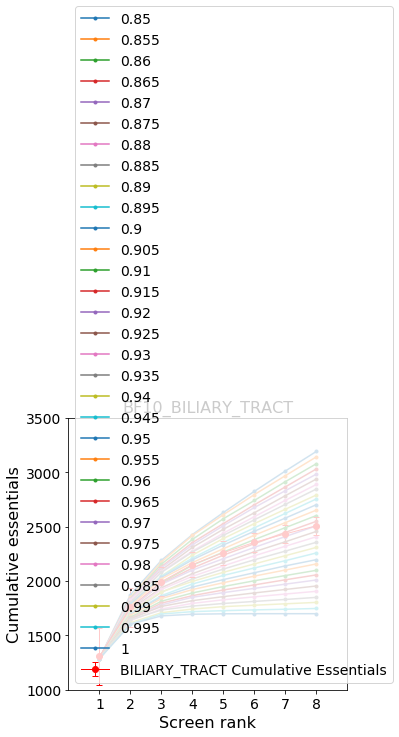

None


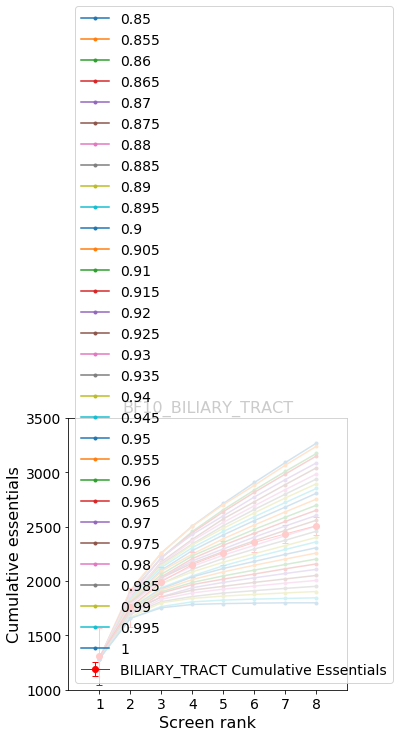

None


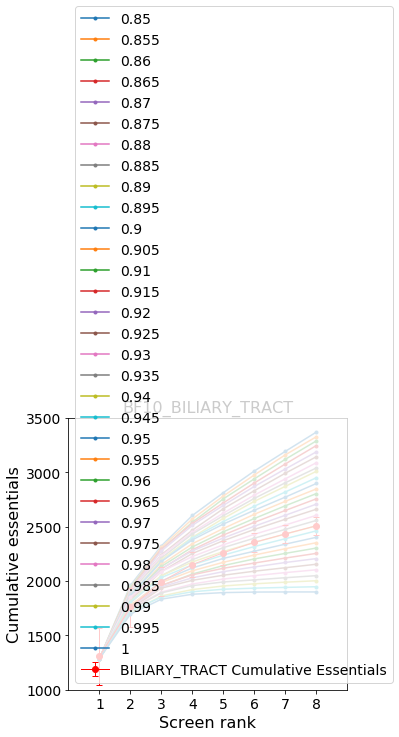

None


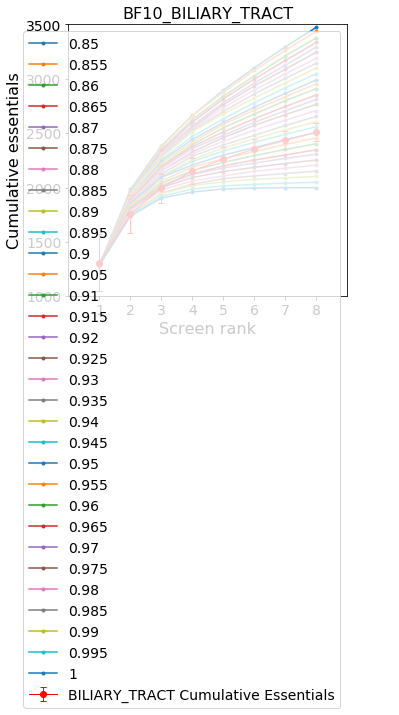

None


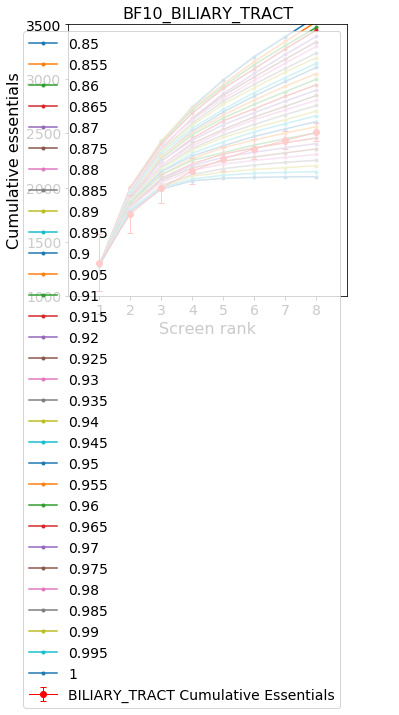

None


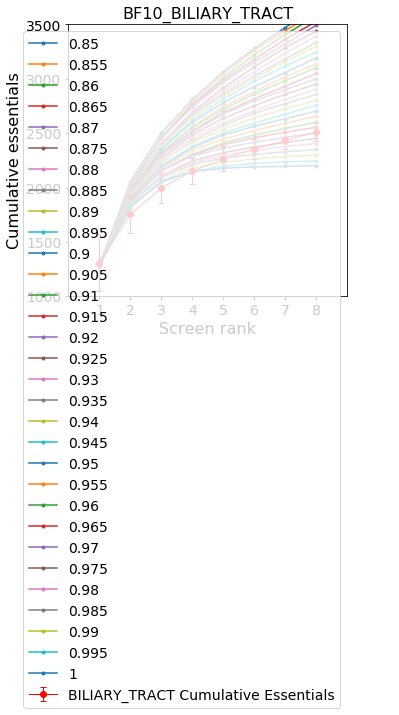

None


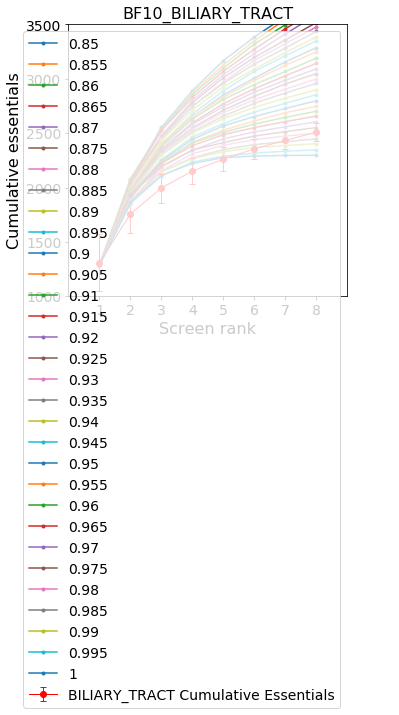

None


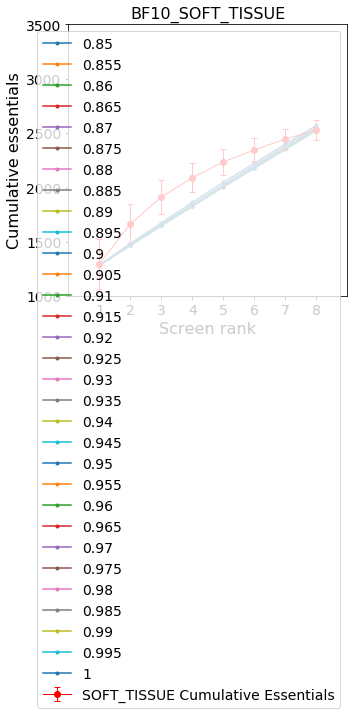

None


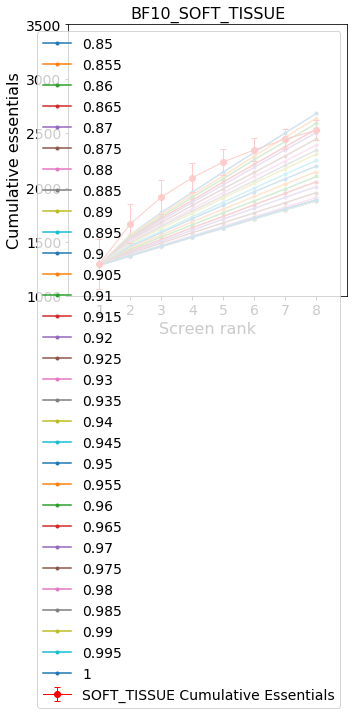

None


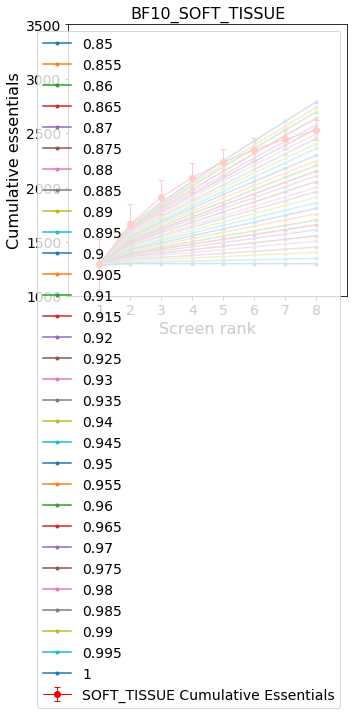

None


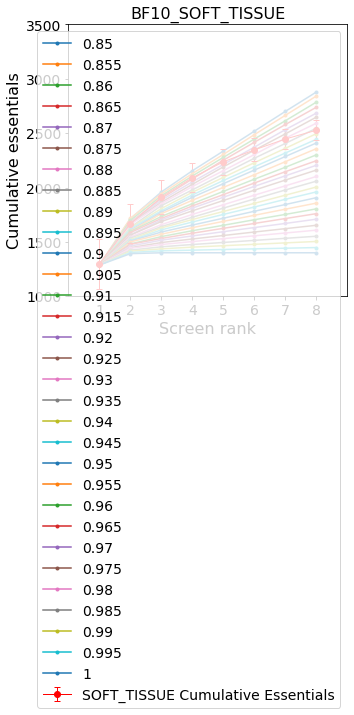

None


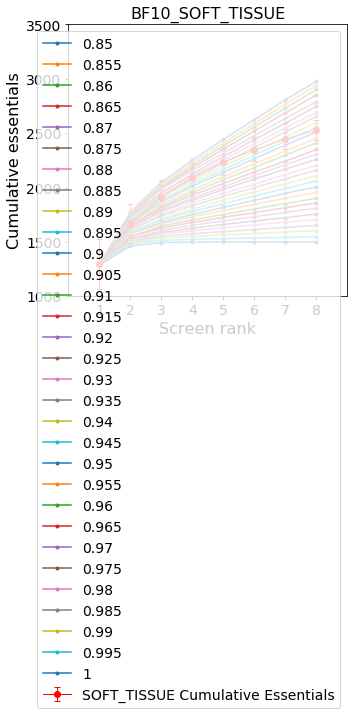

None


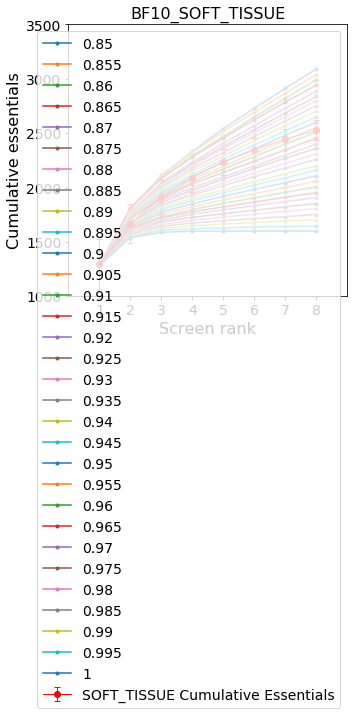

None


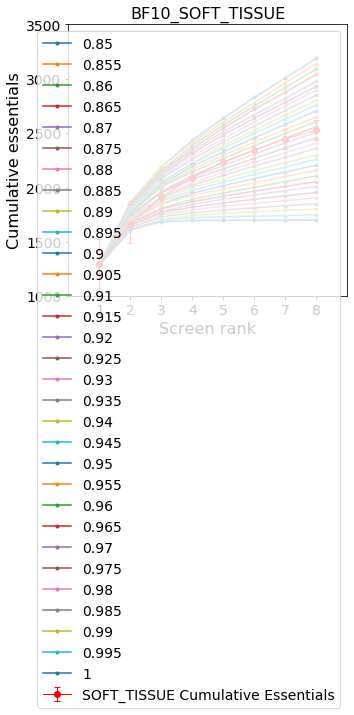

None


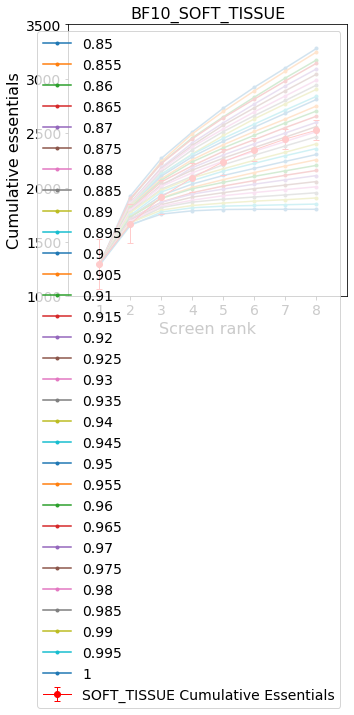

None


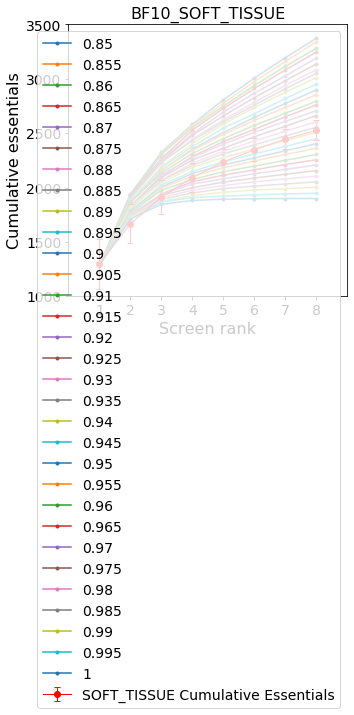

None


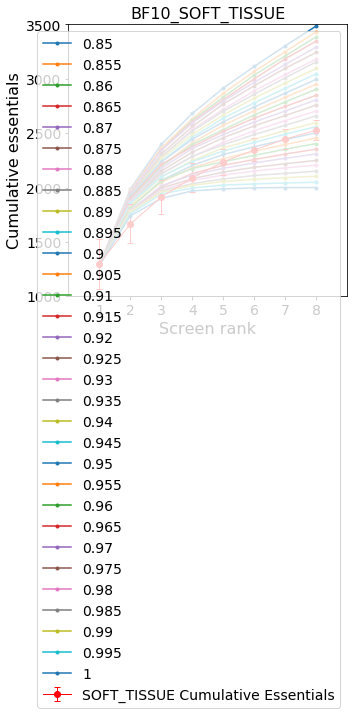

None


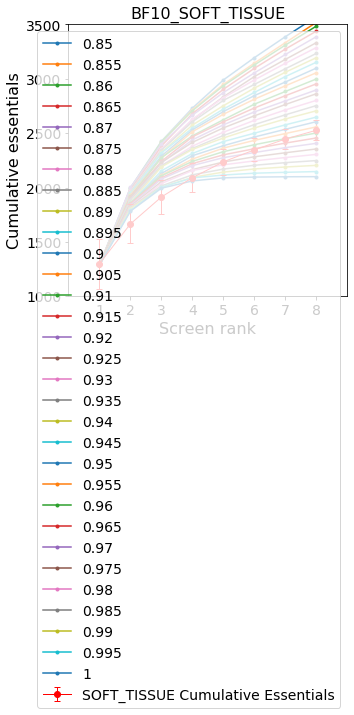

None


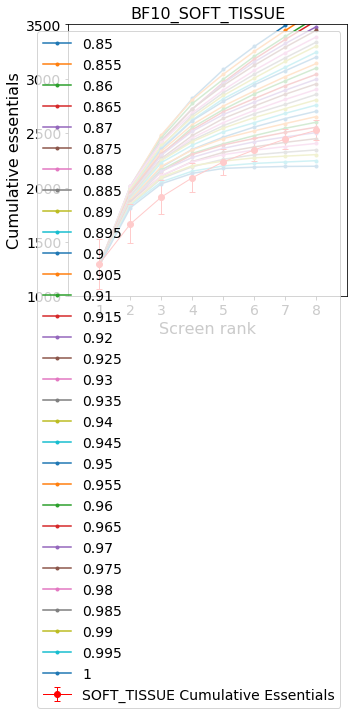

None


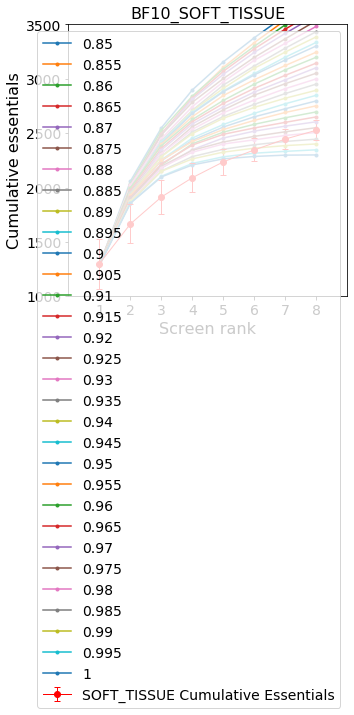

None


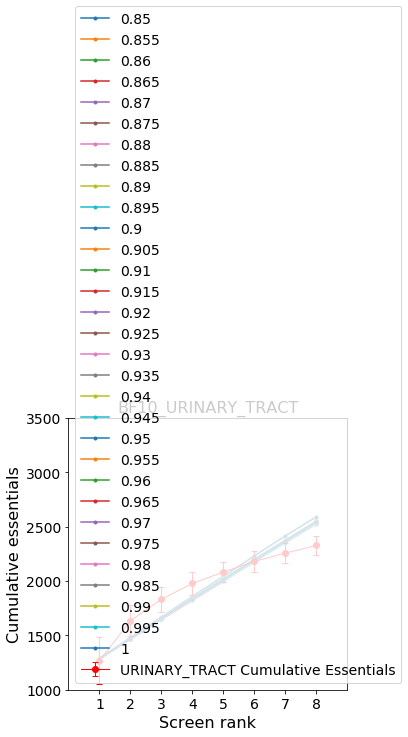

None


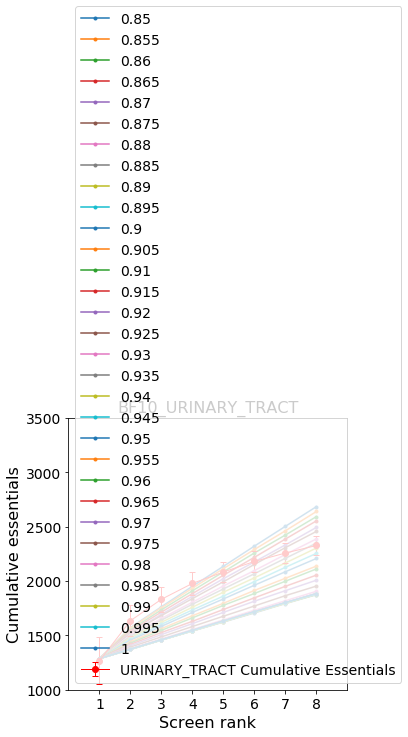

None


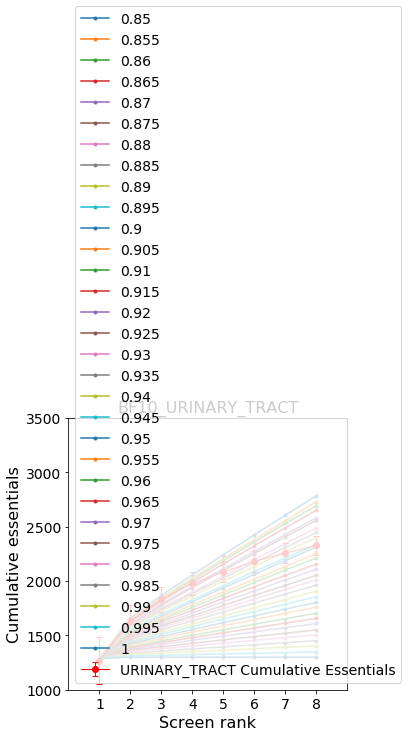

None


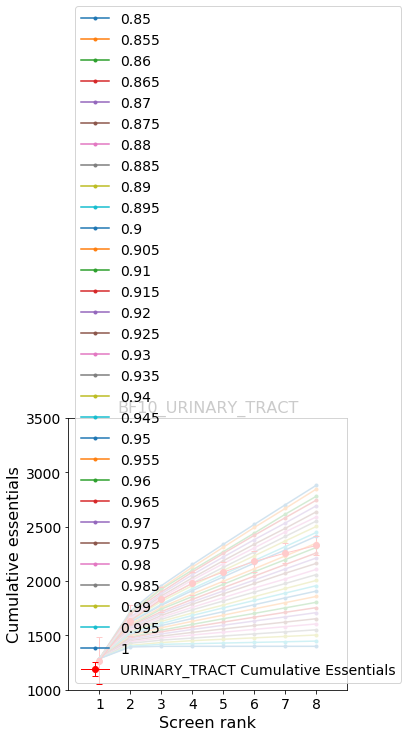

None


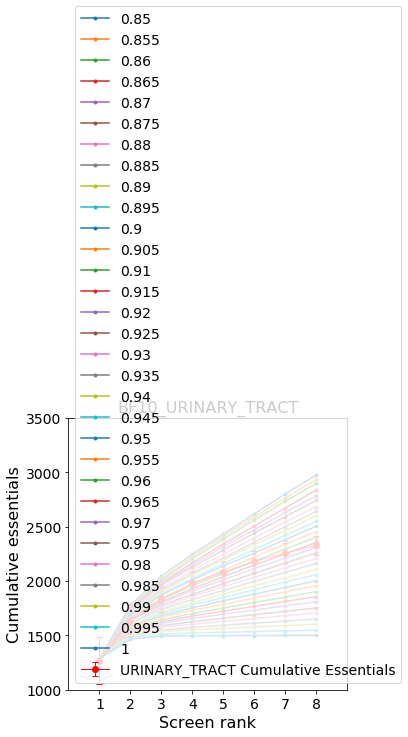

None


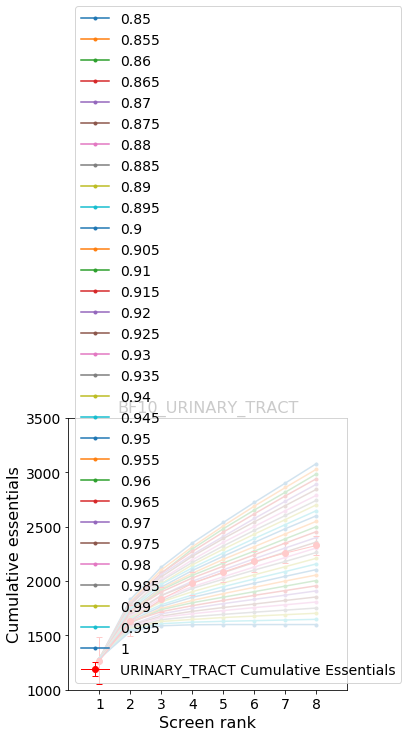

None


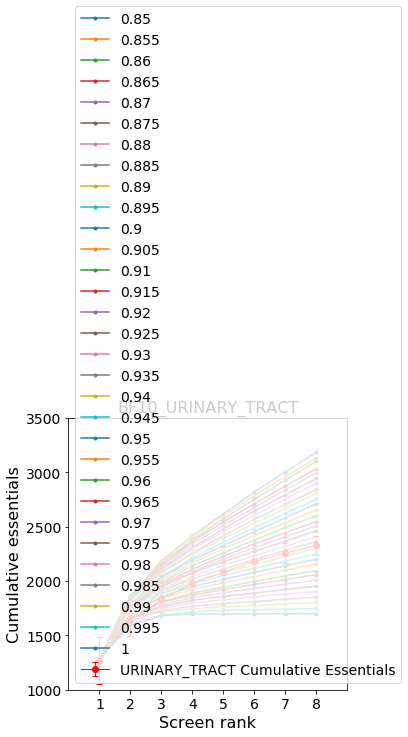

None


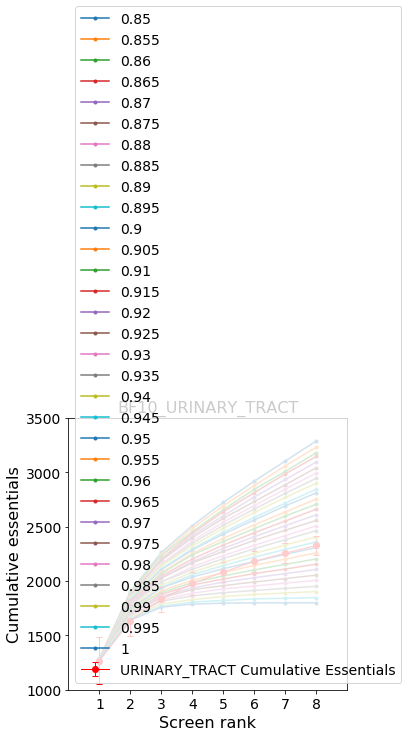

None


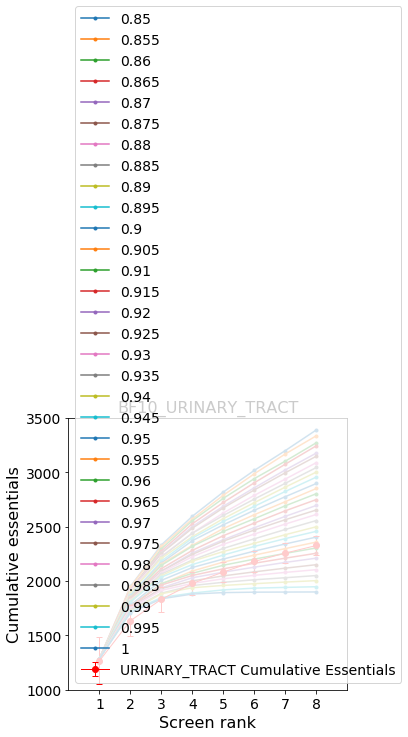

None


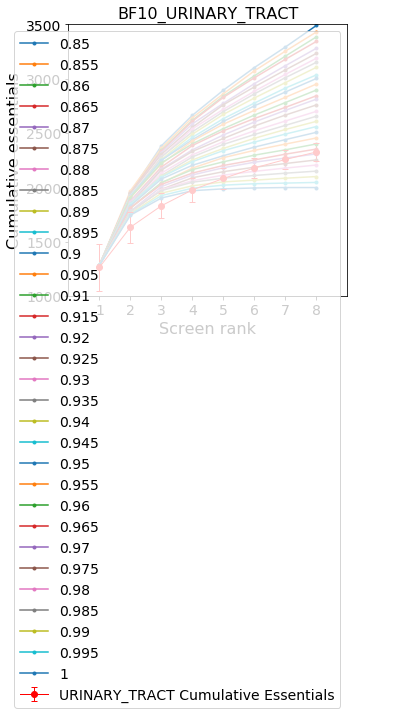

None


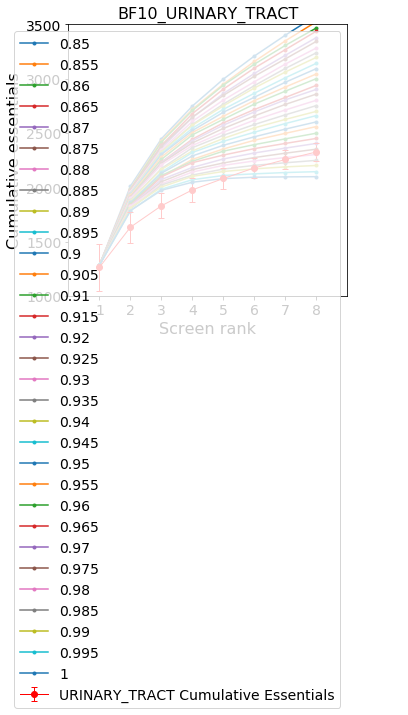

None


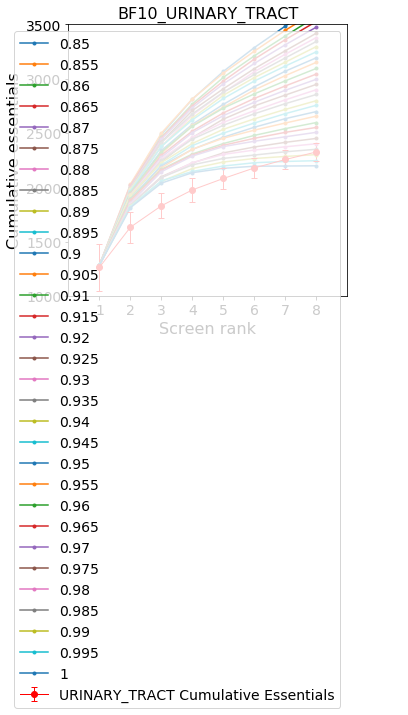

None


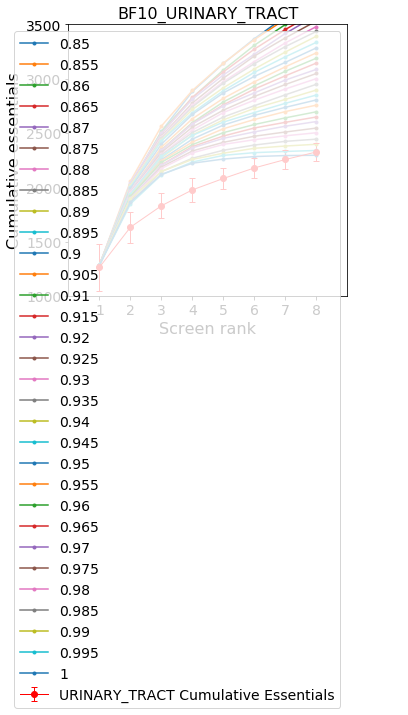

None


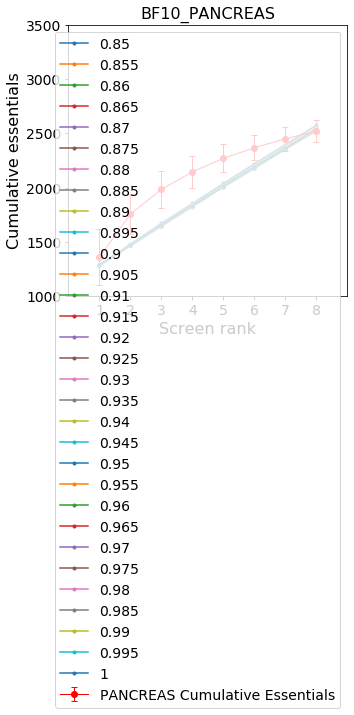

None


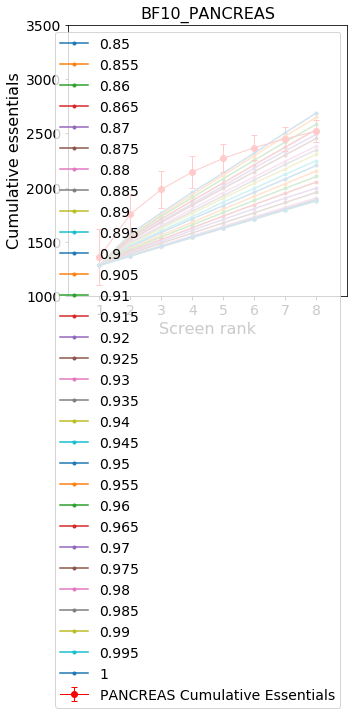

None


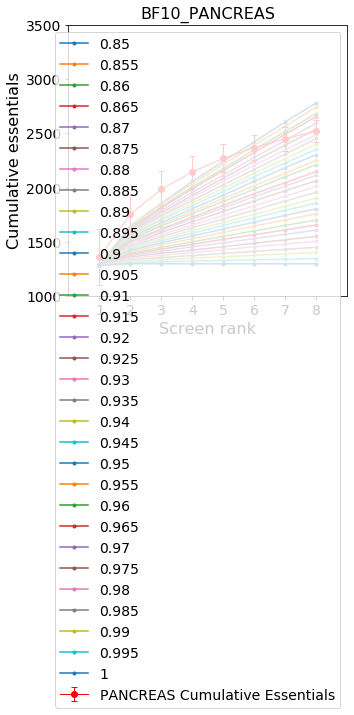

None


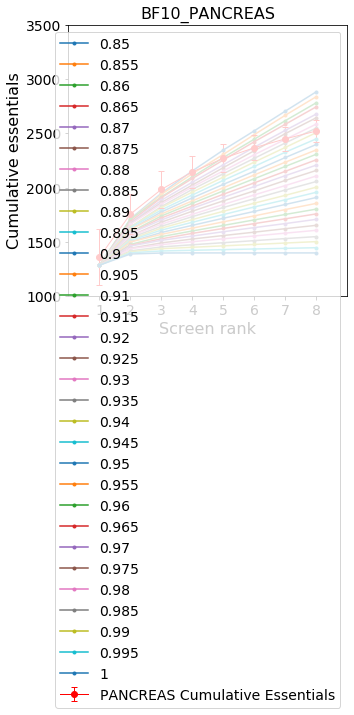

None


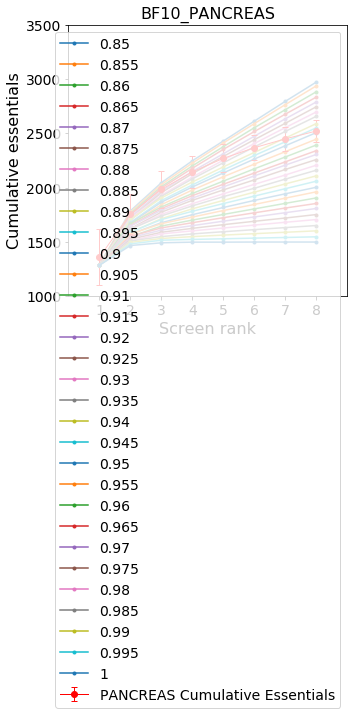

None


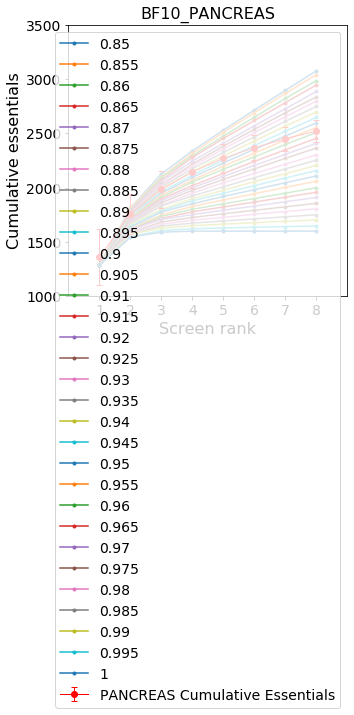

None


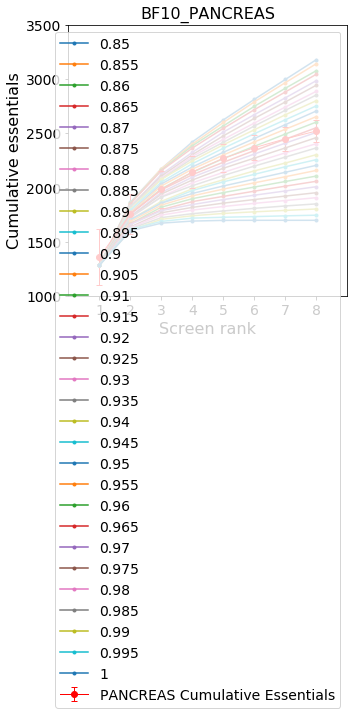

None


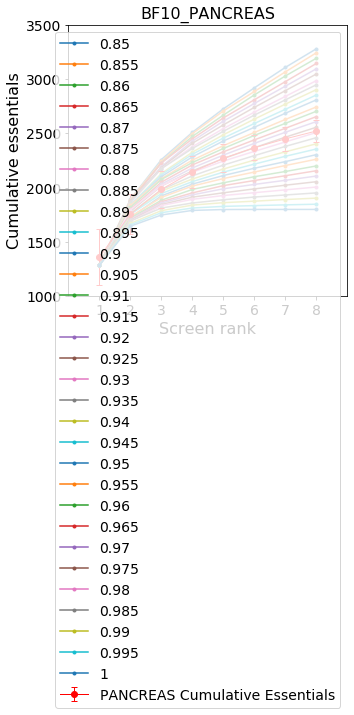

None


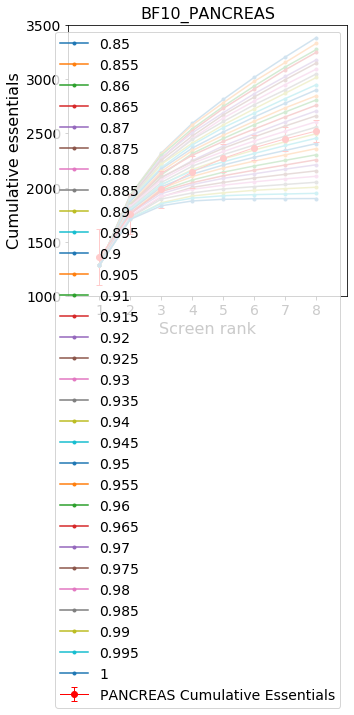

None


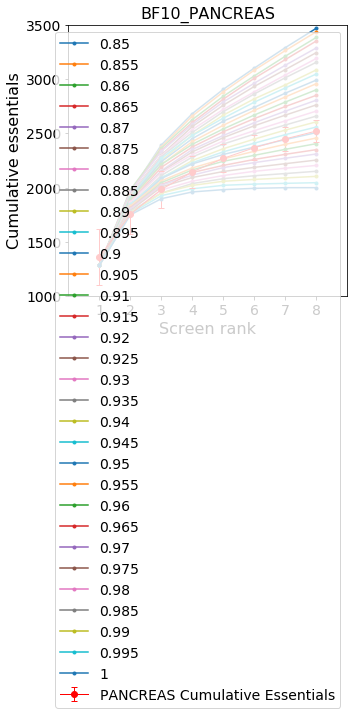

None


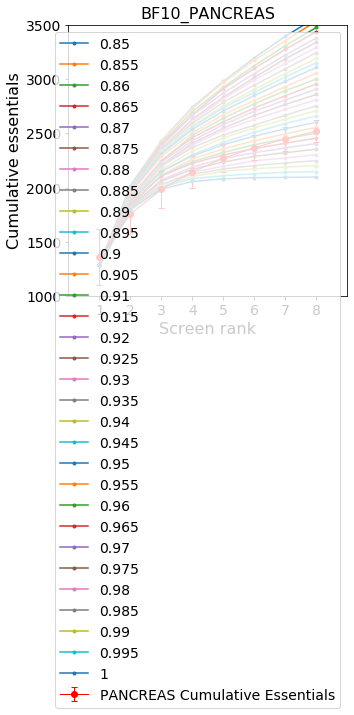

None


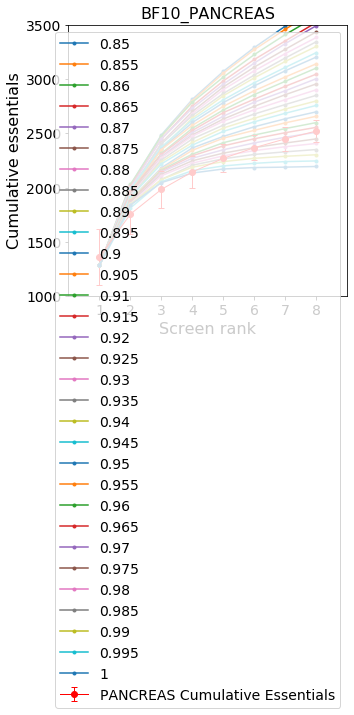

None


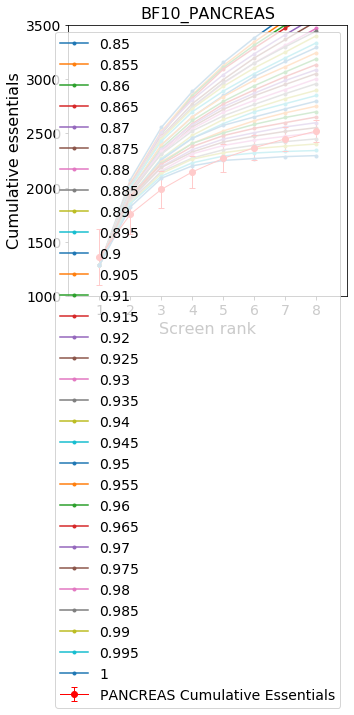

None


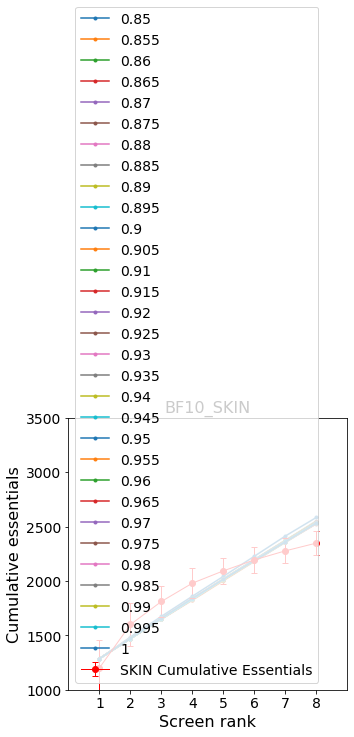

None


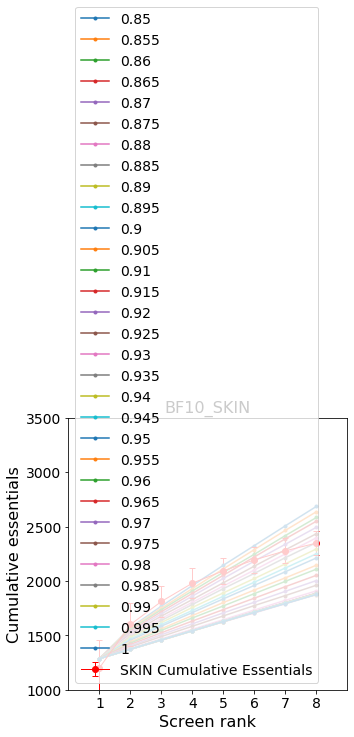

None


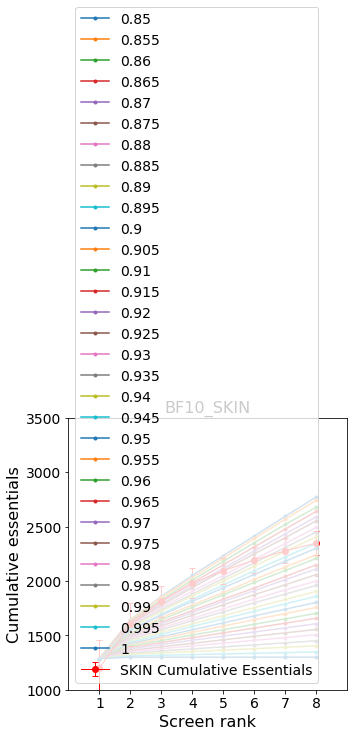

None


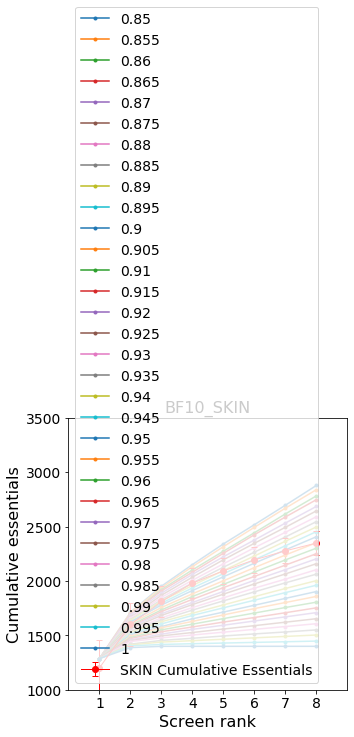

None


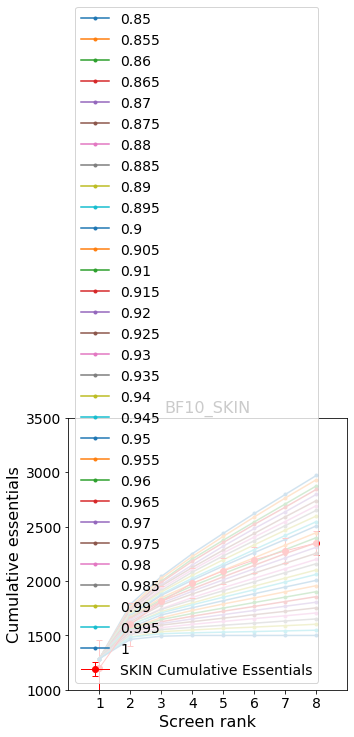

None


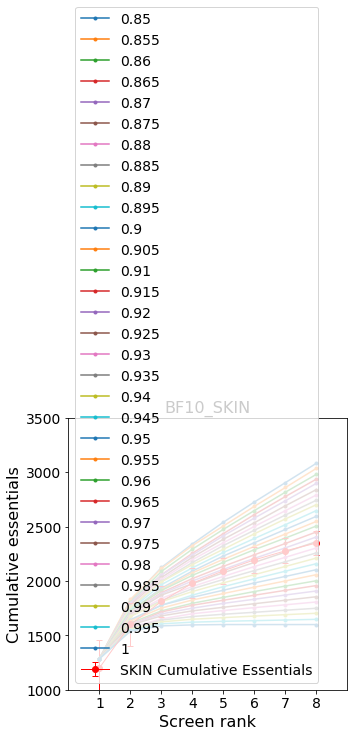

None


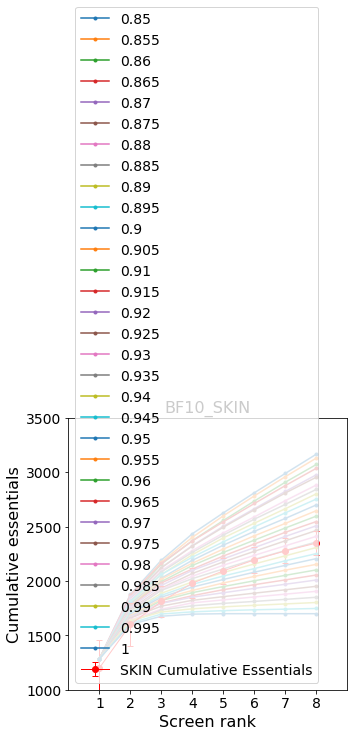

None


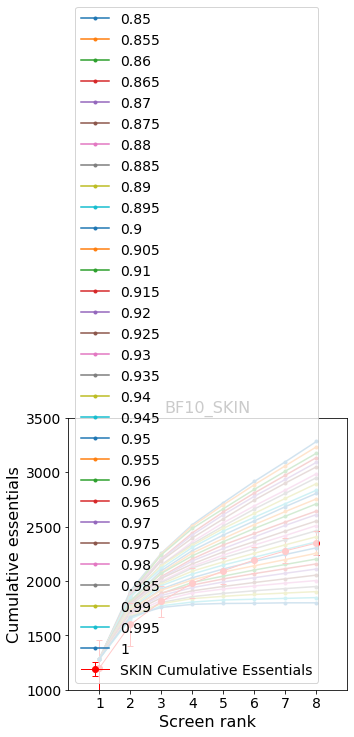

None


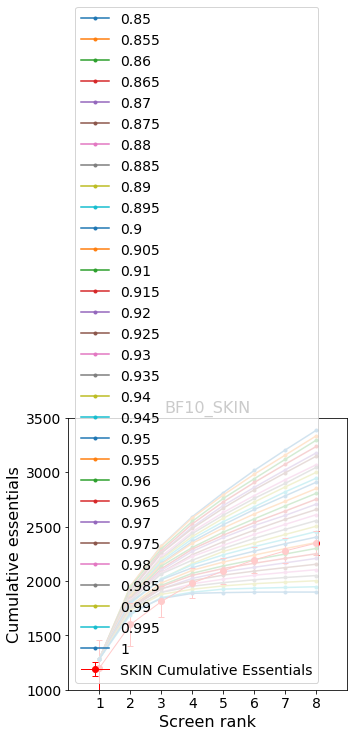

None


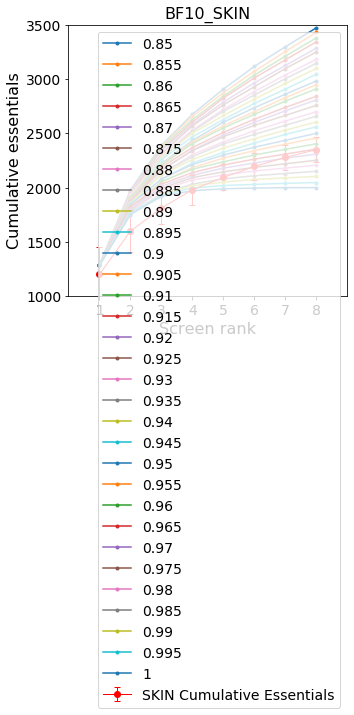

None


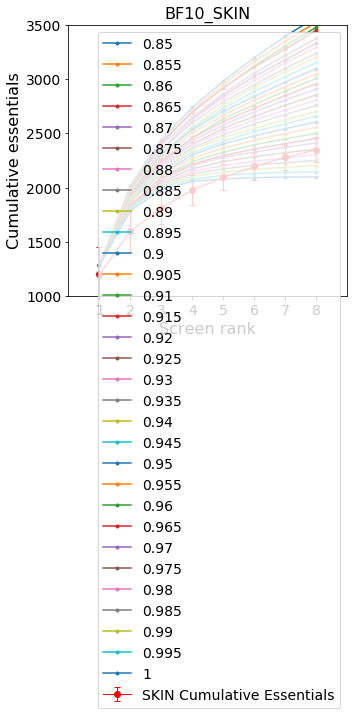

None


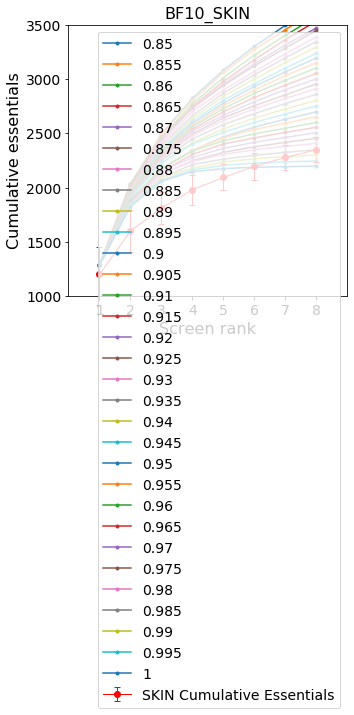

None


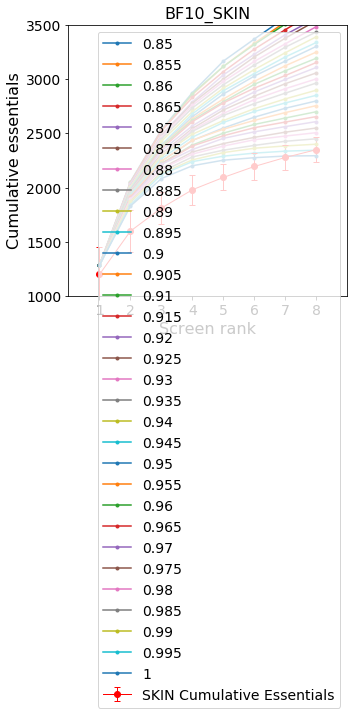

None


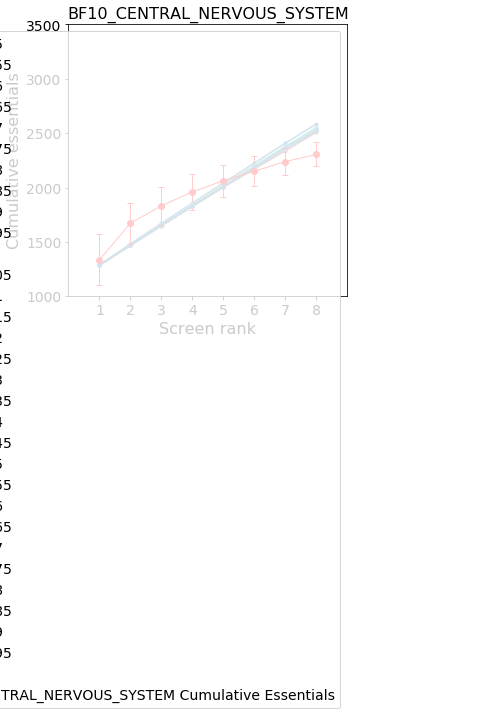

None


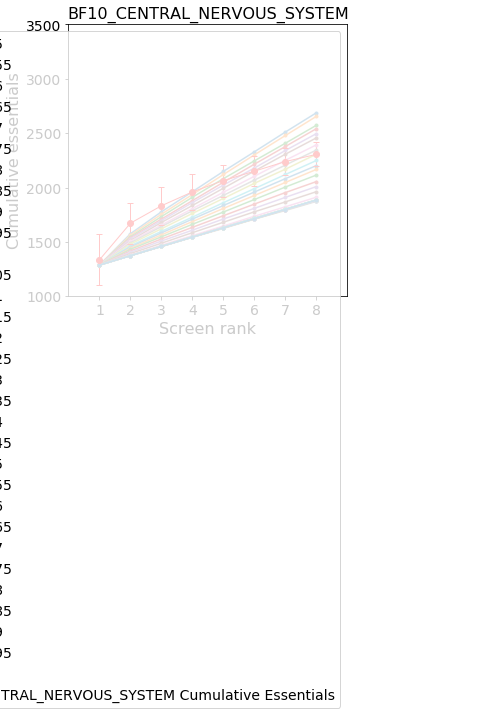

None


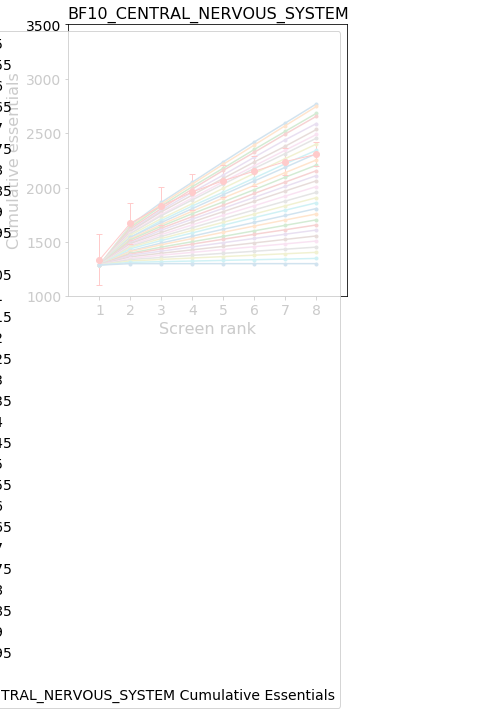

None


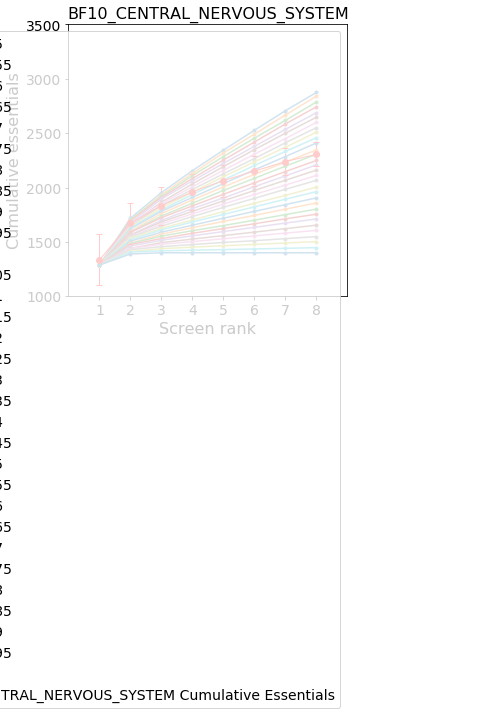

None


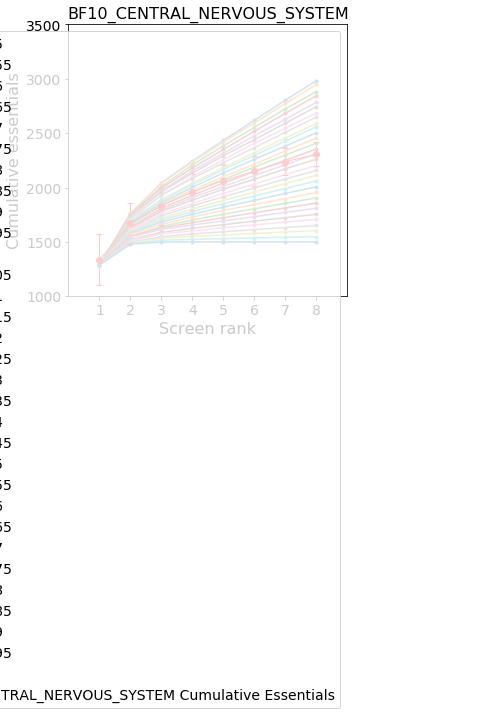

None


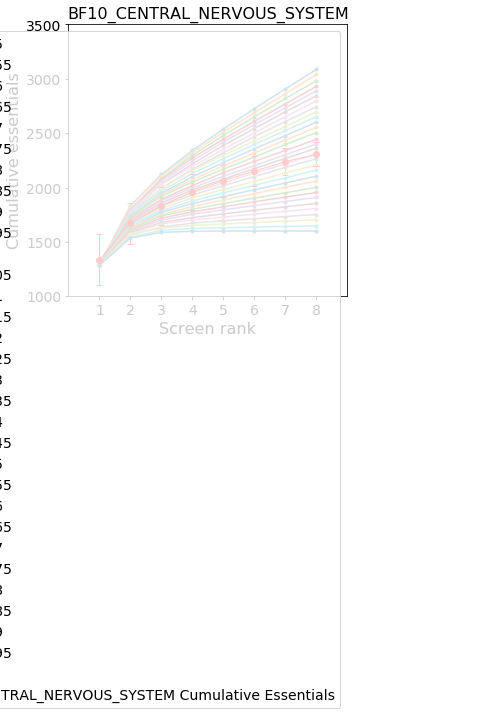

None


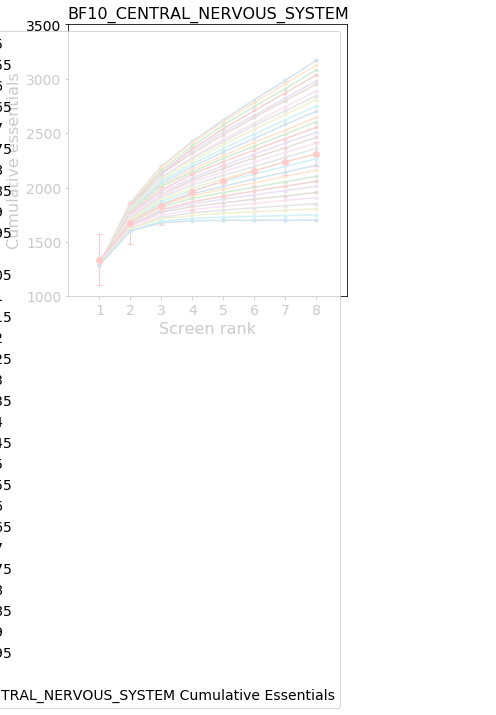

None


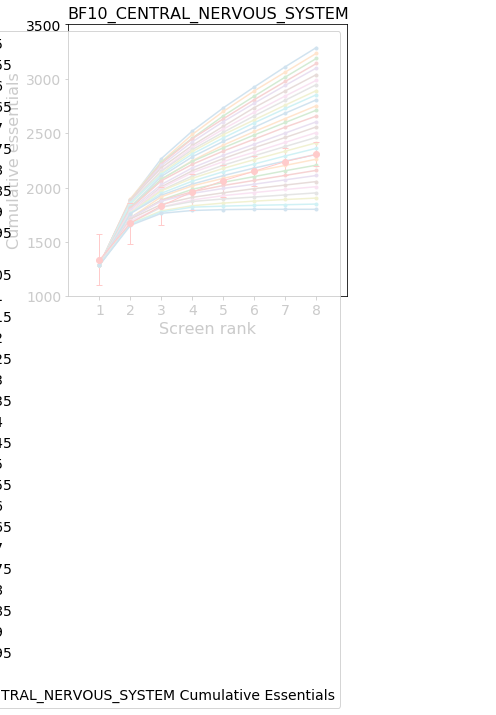

None


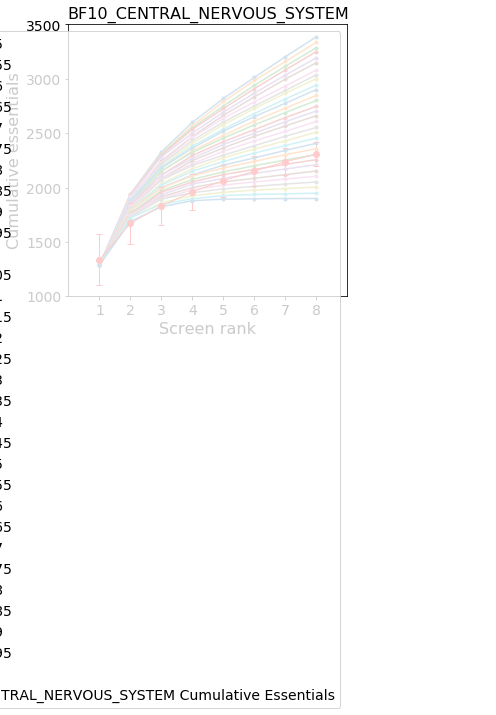

None


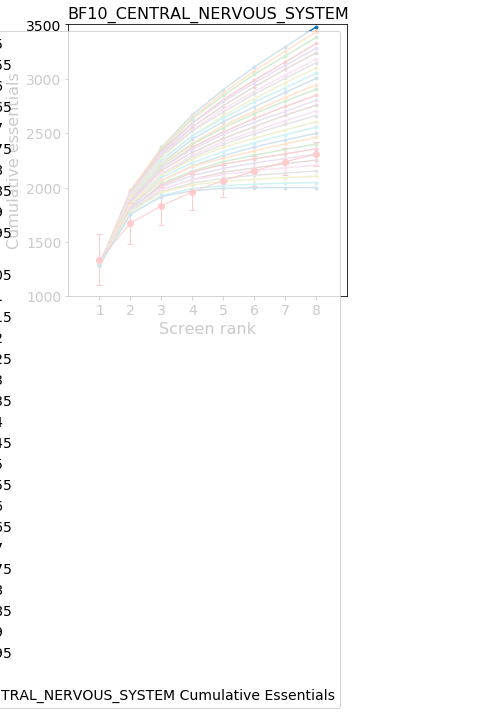

None


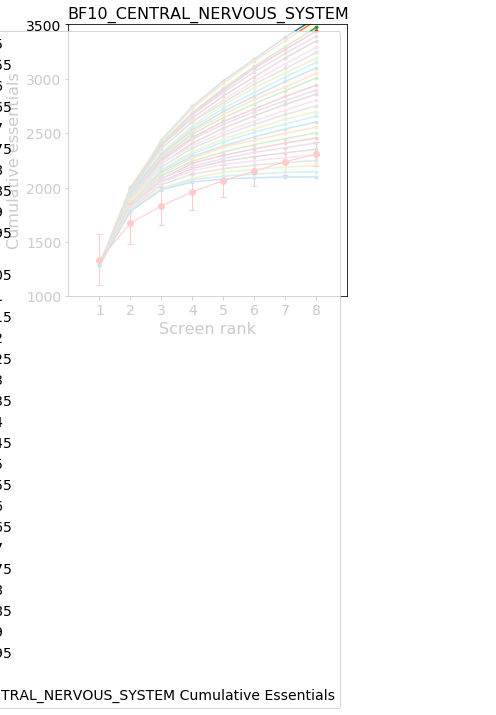

None


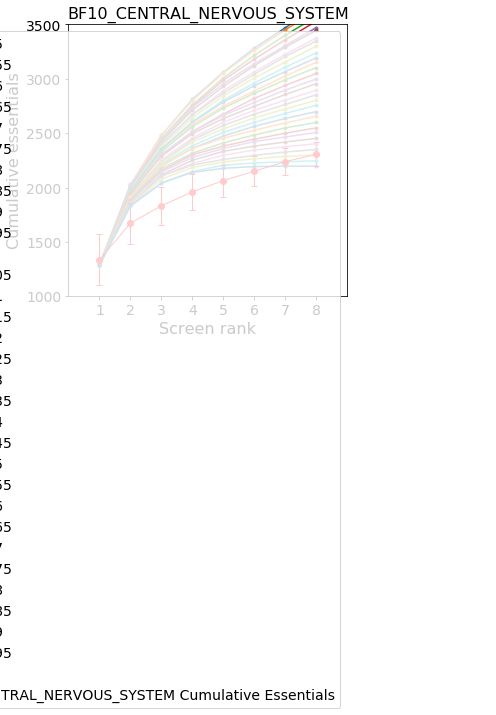

None


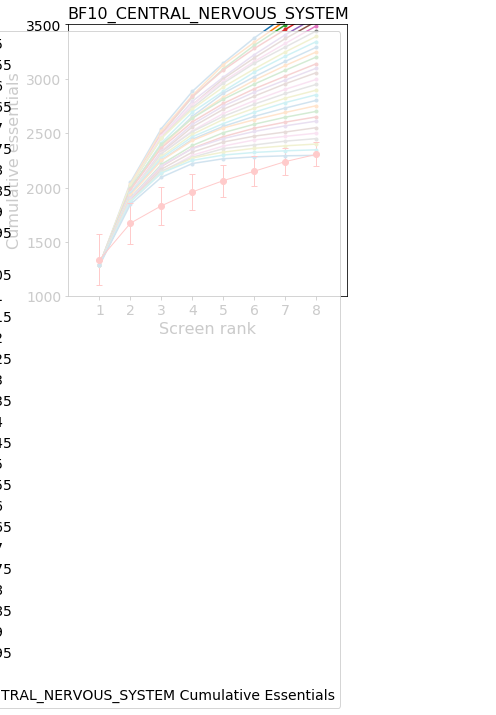

None


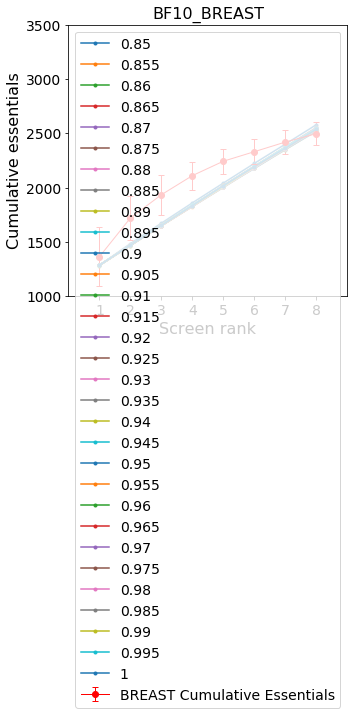

None


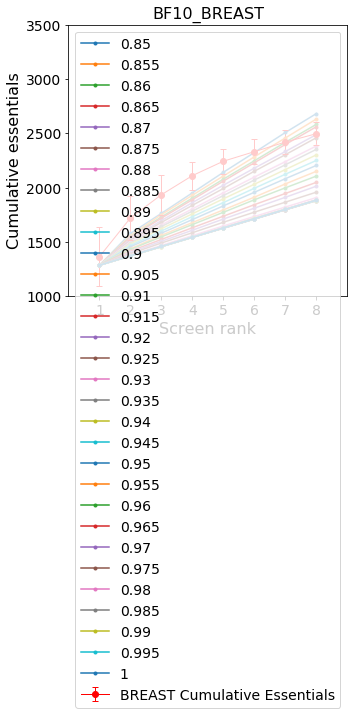

None


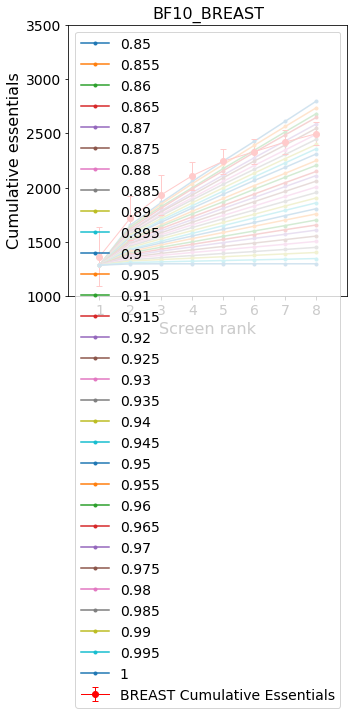

None


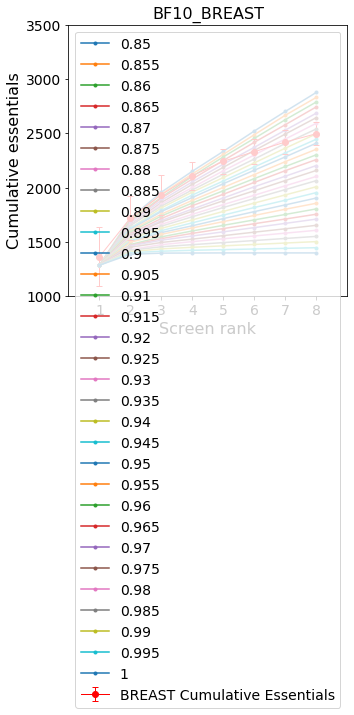

None


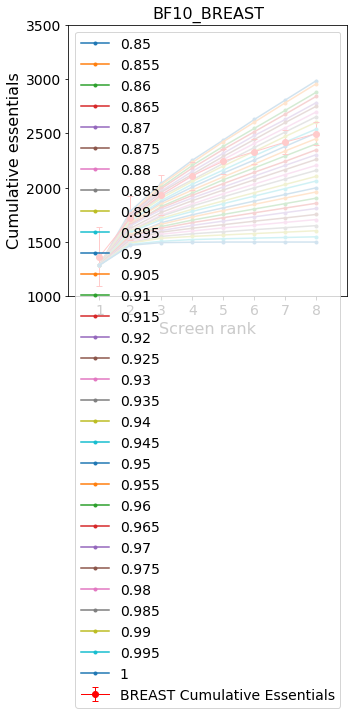

None


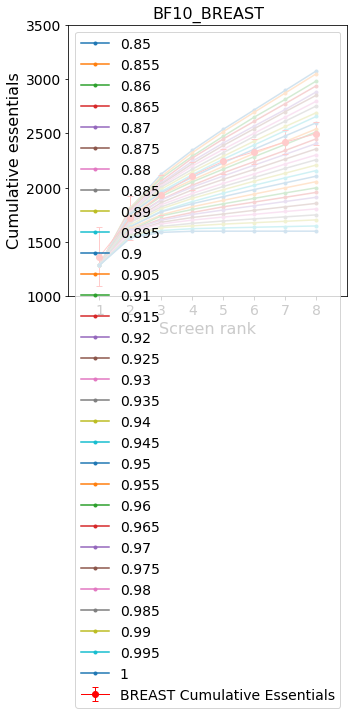

None


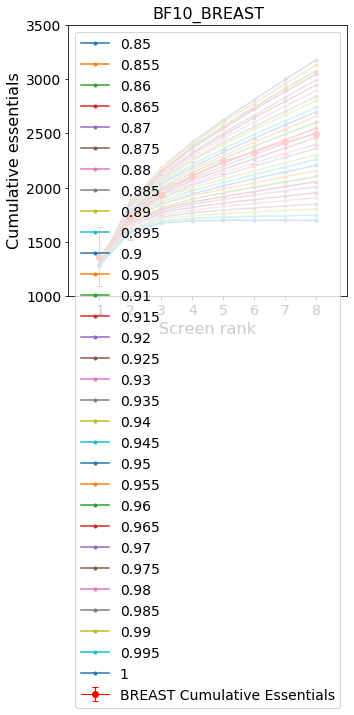

None


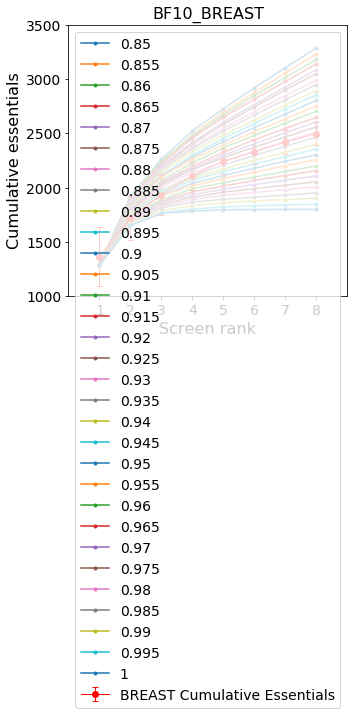

None


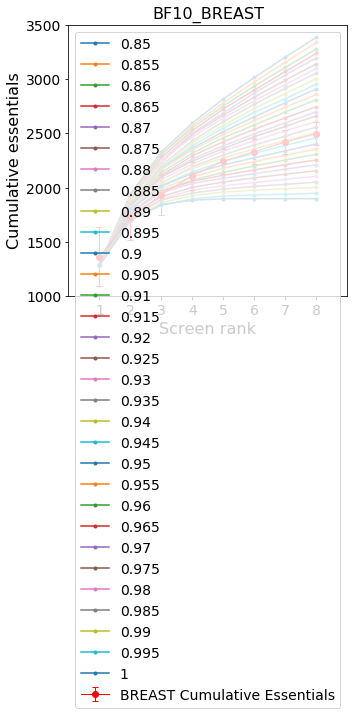

None


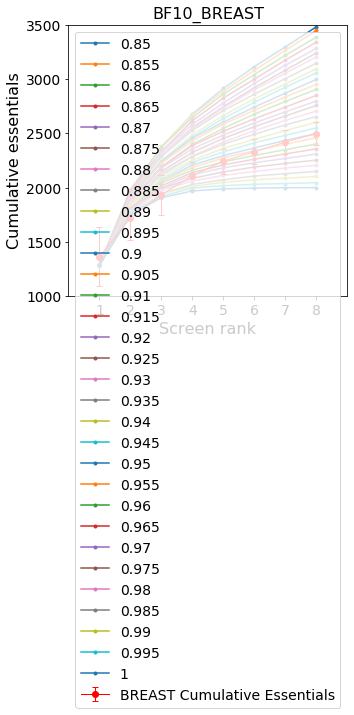

None


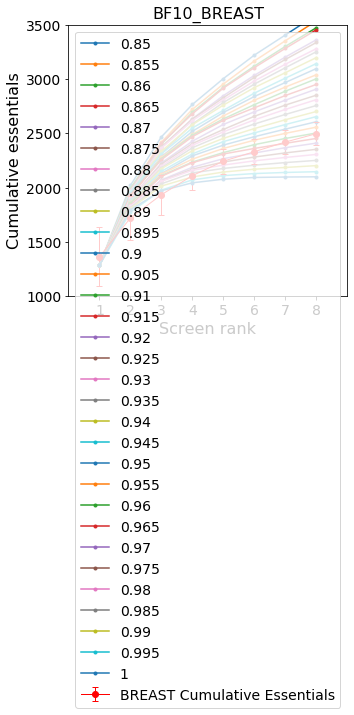

None


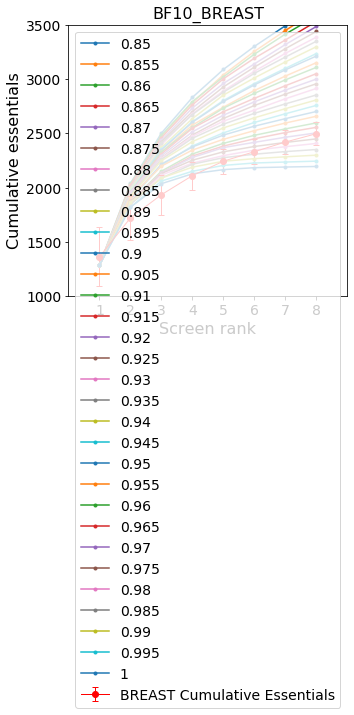

None


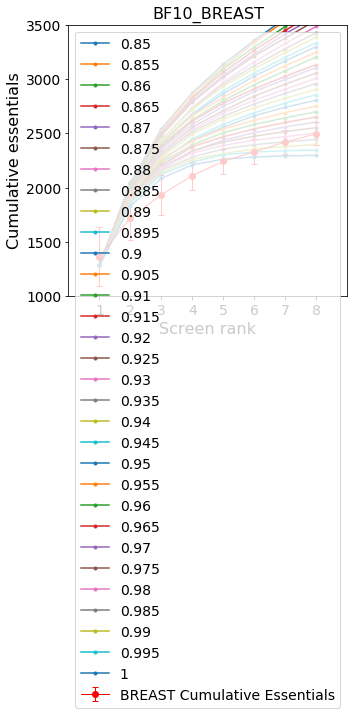

None


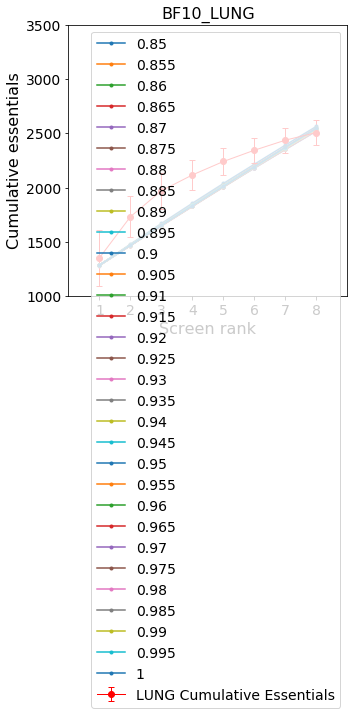

None


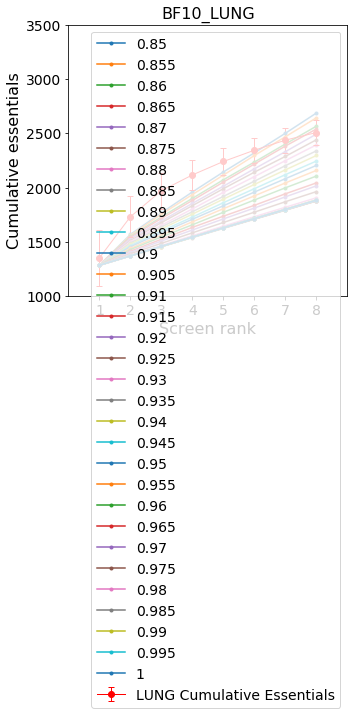

None


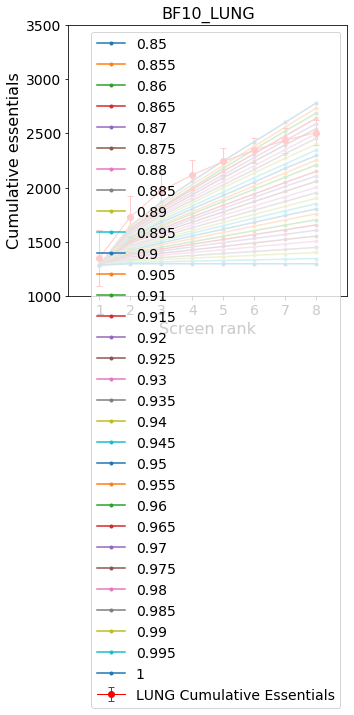

None


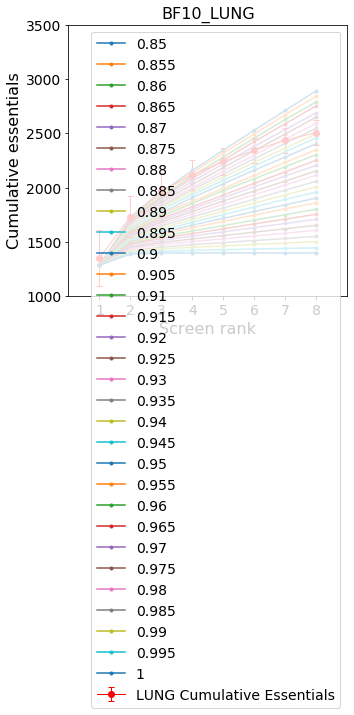

None


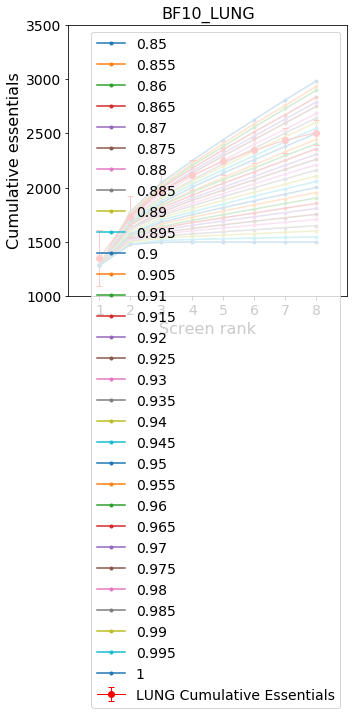

None


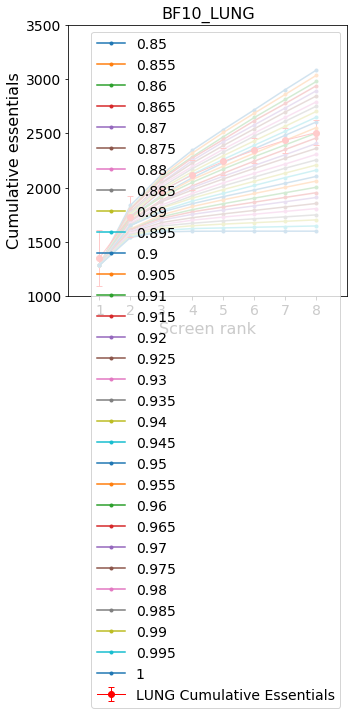

None


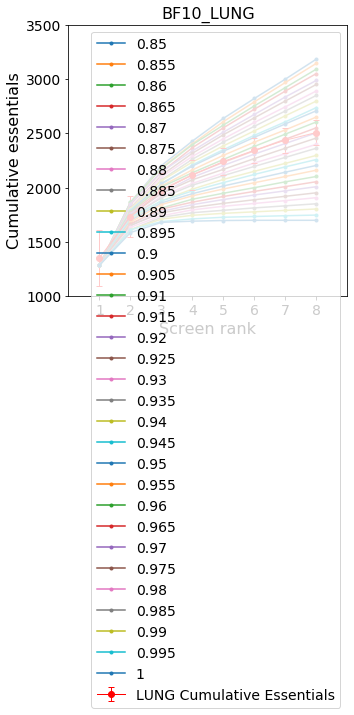

None


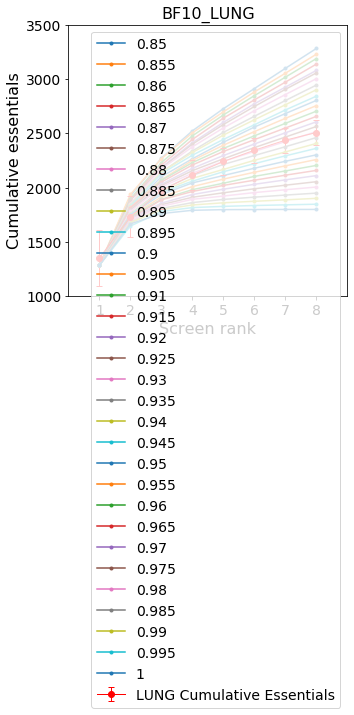

None


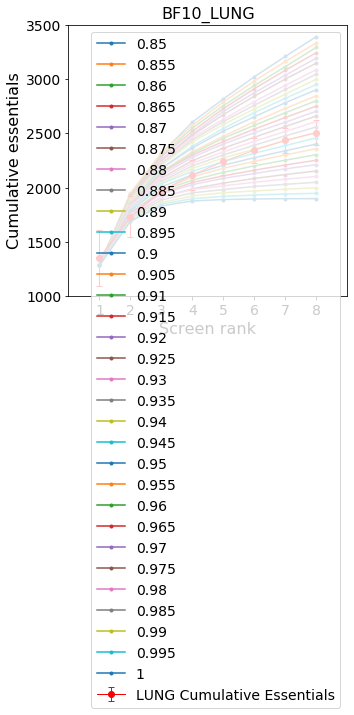

None


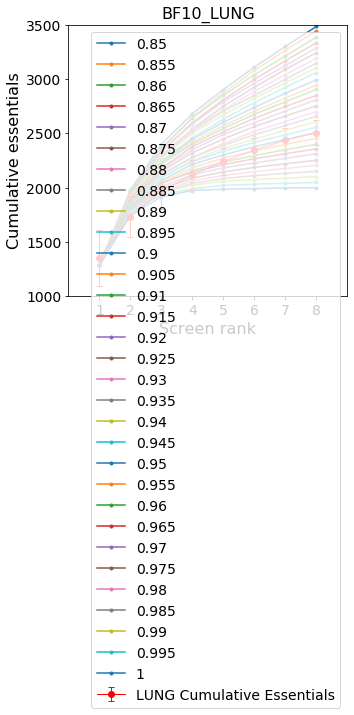

None


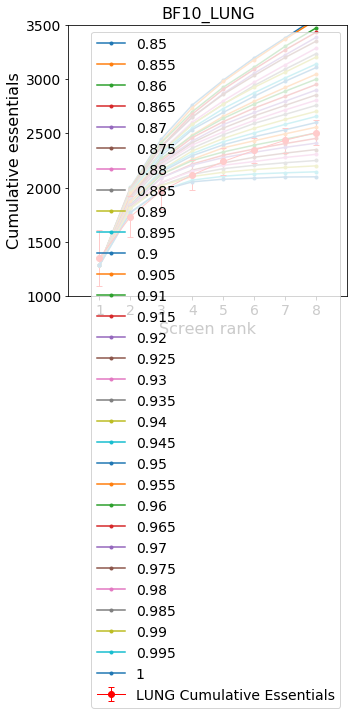

None


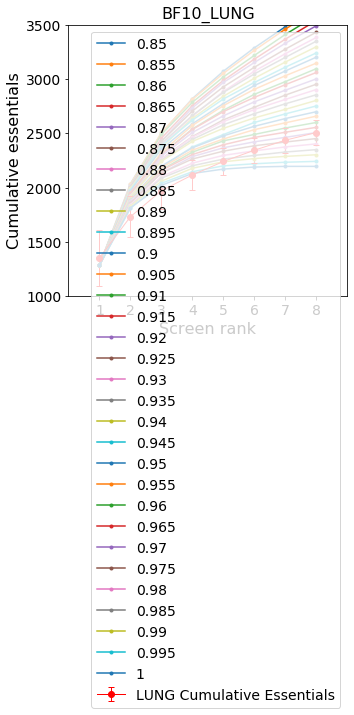

None


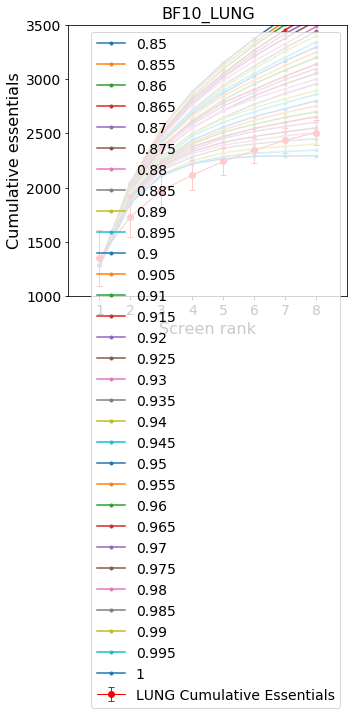

None


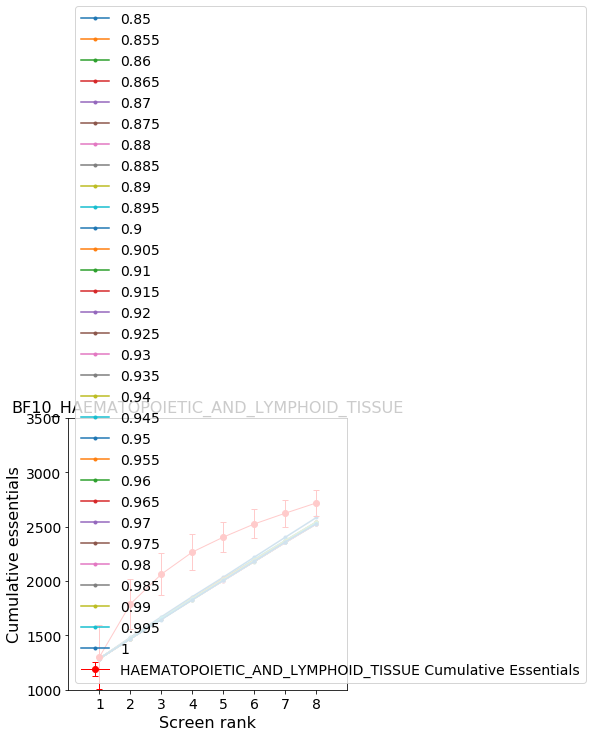

None


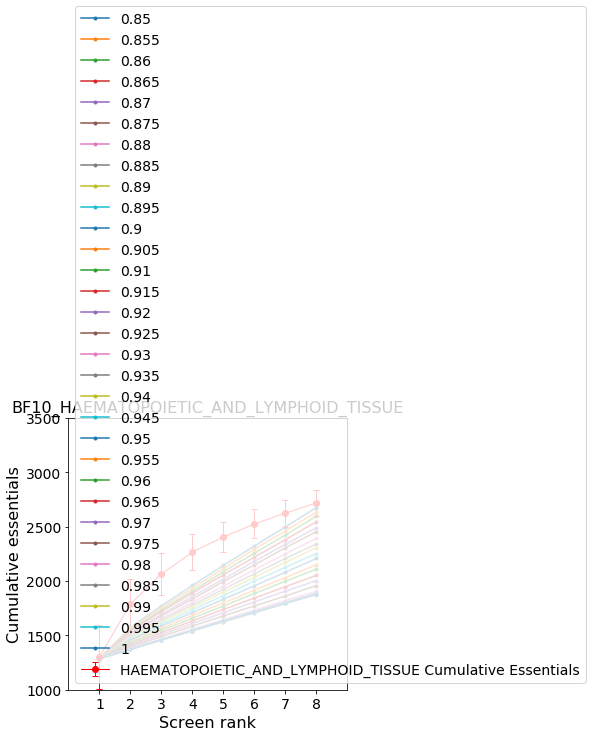

None


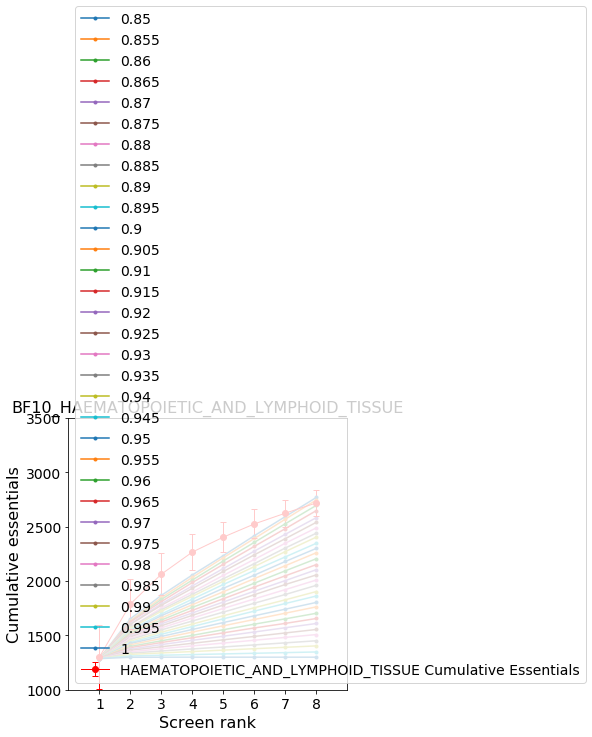

None


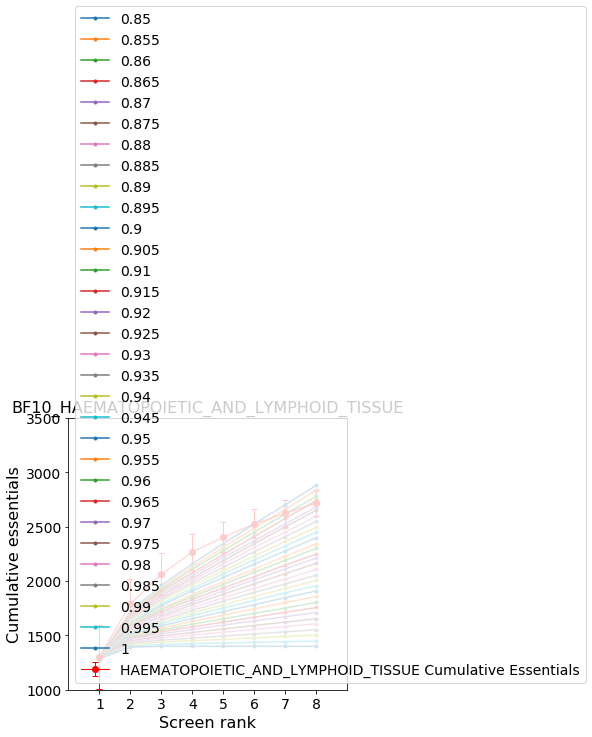

None


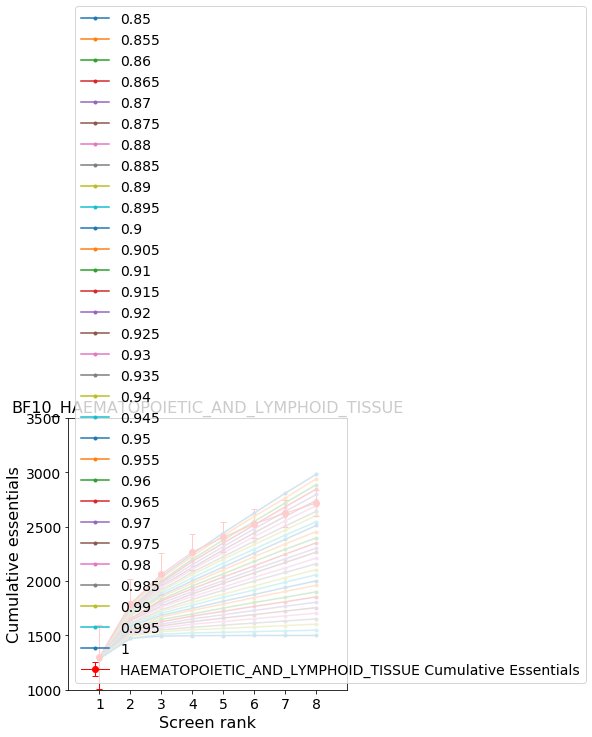

None


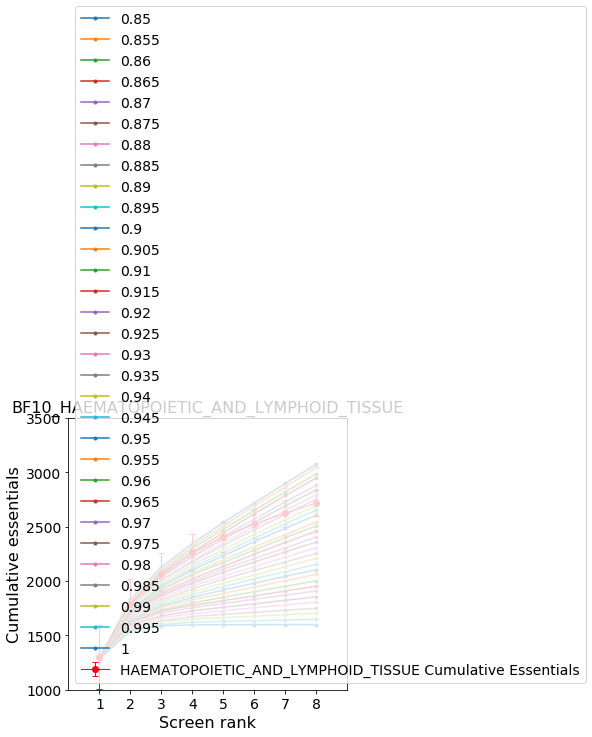

None


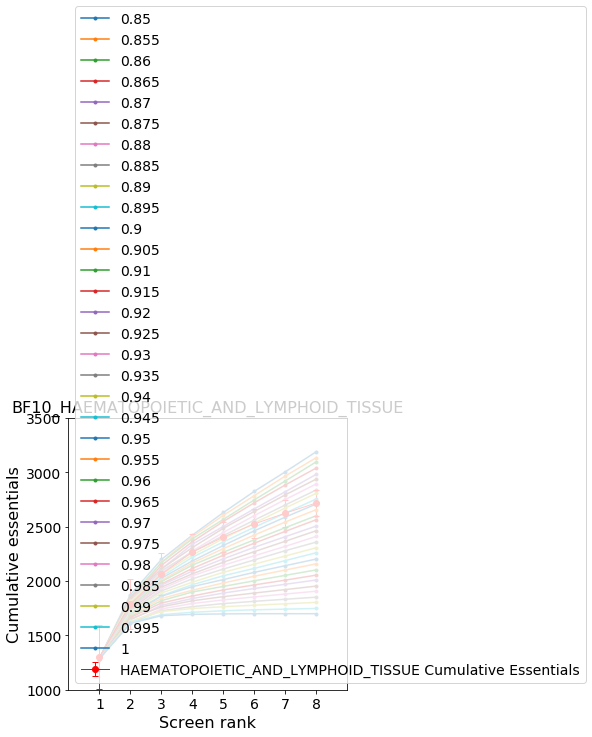

None


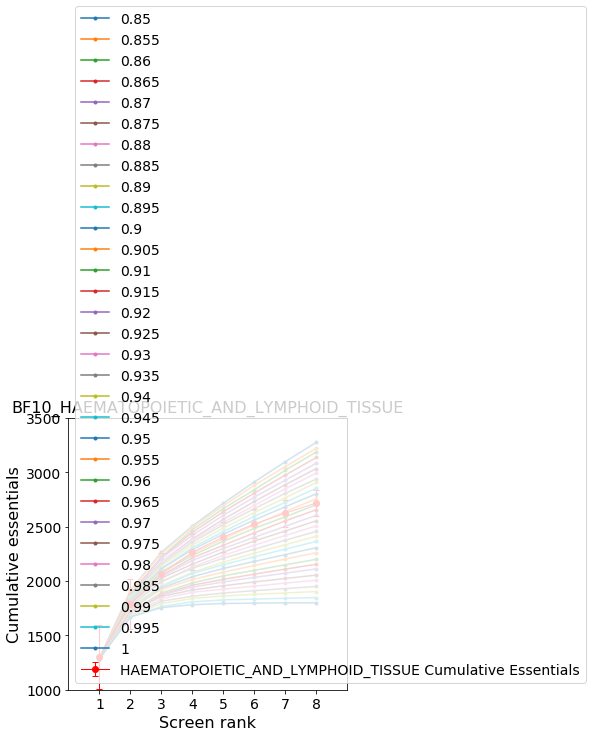

None


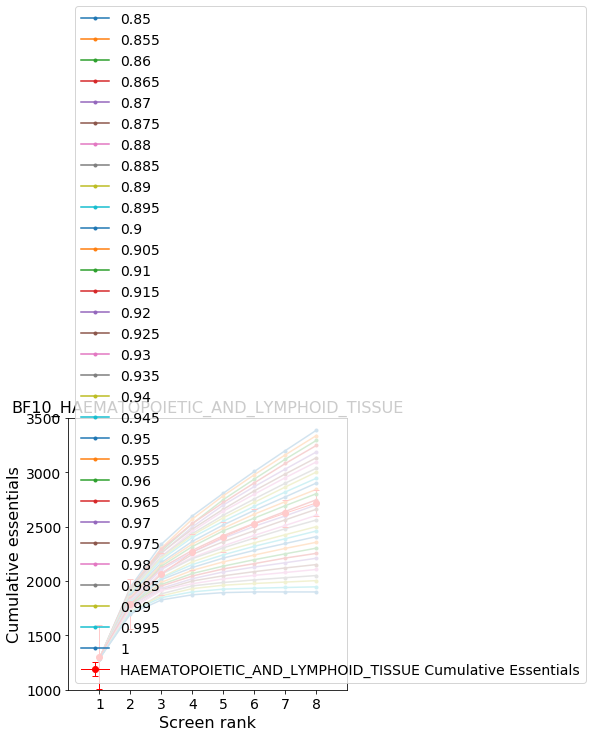

None


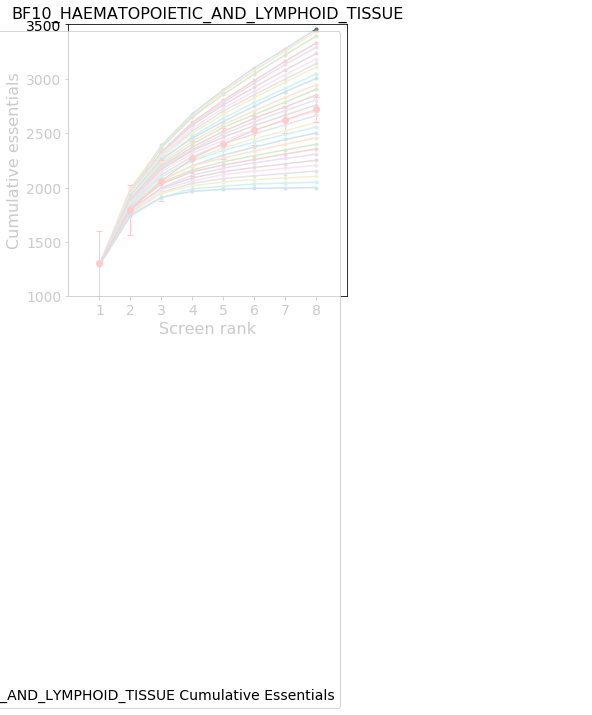

None


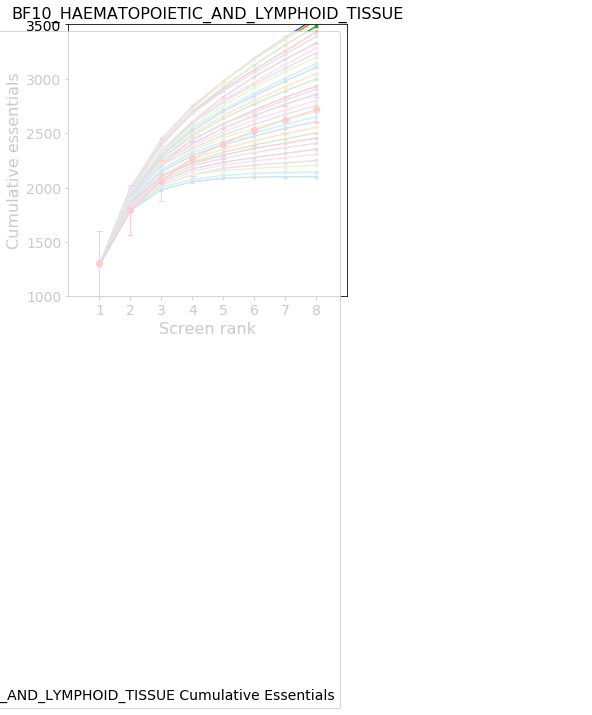

None


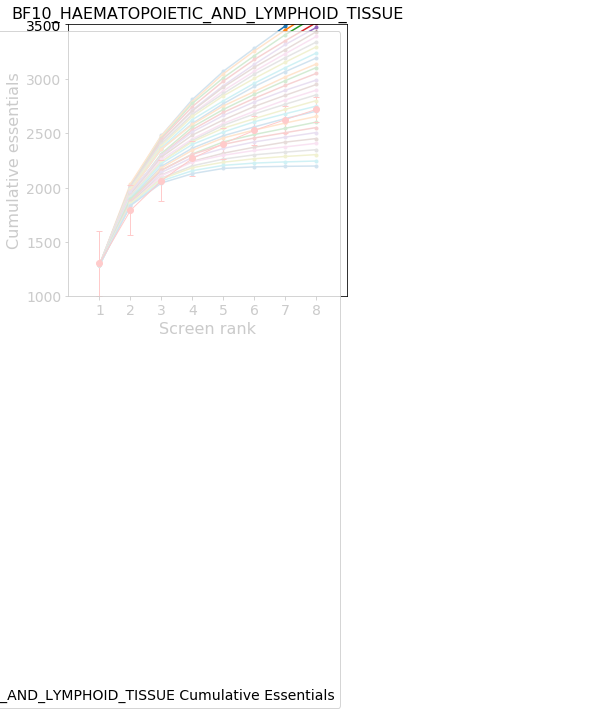

None


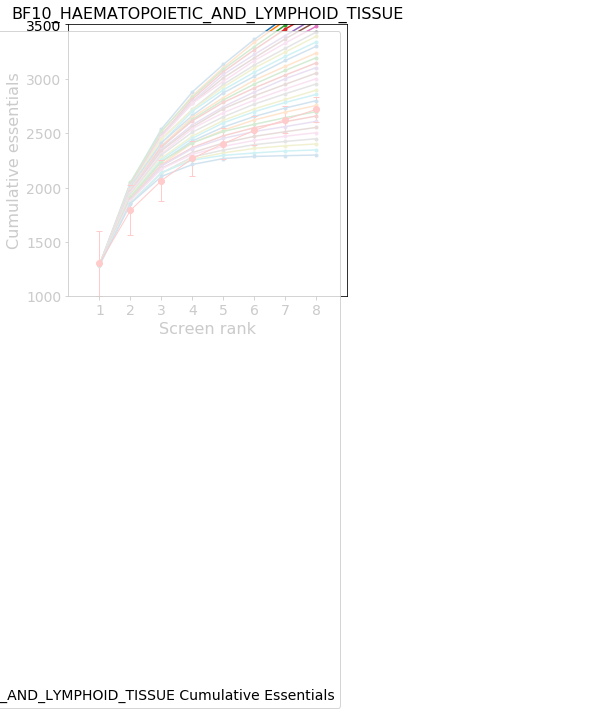

None


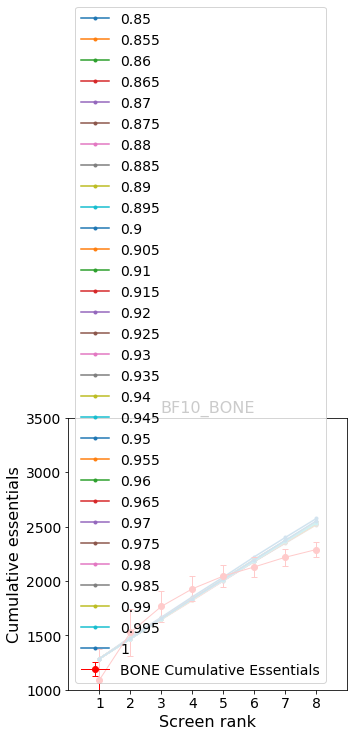

None


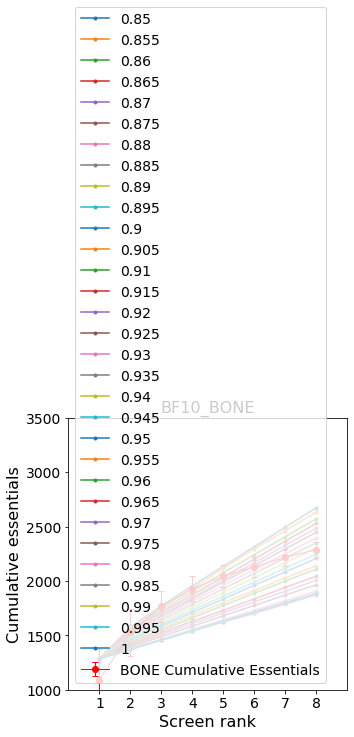

None


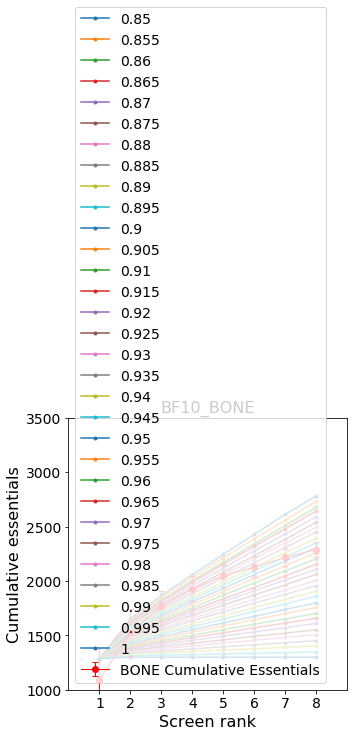

None


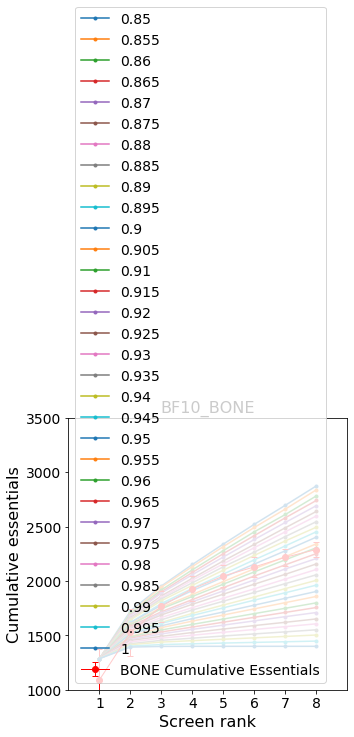

None


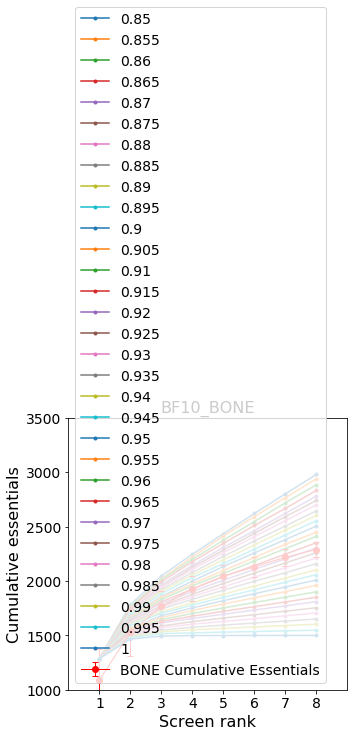

None


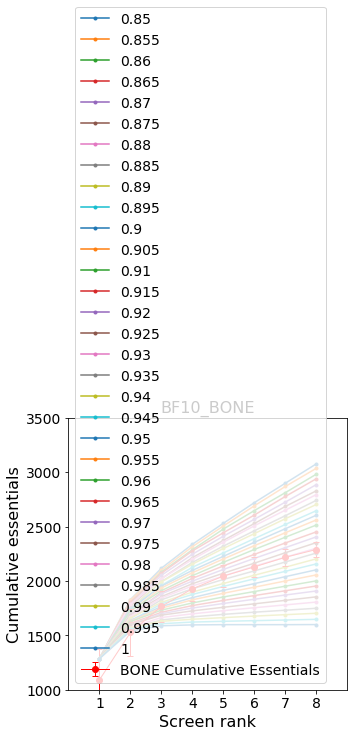

None


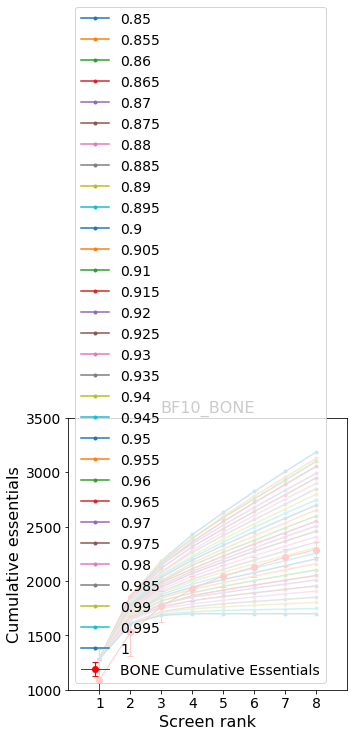

None


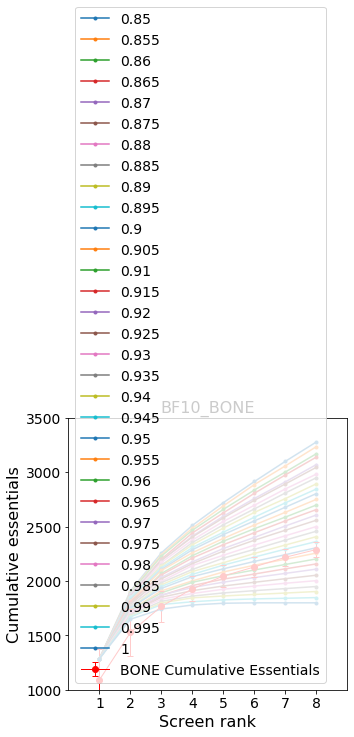

None


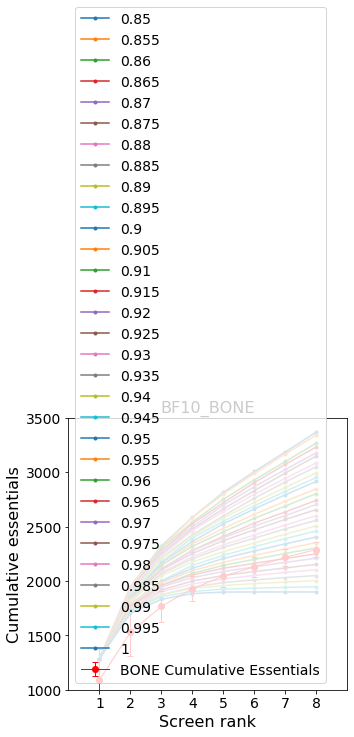

None


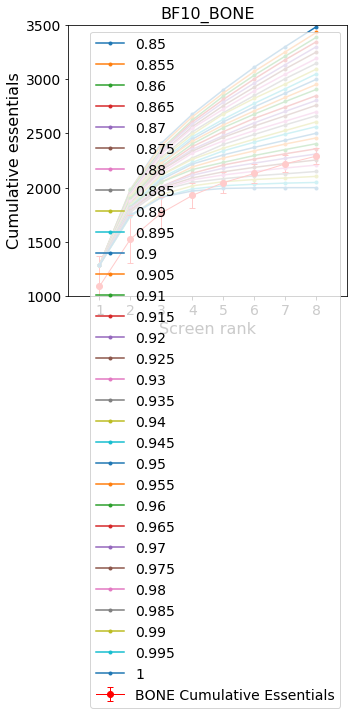

None


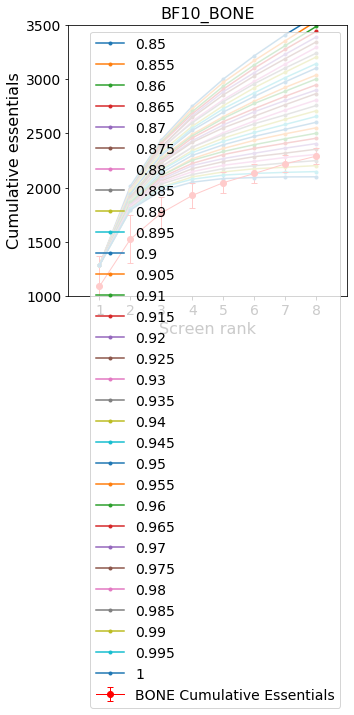

None


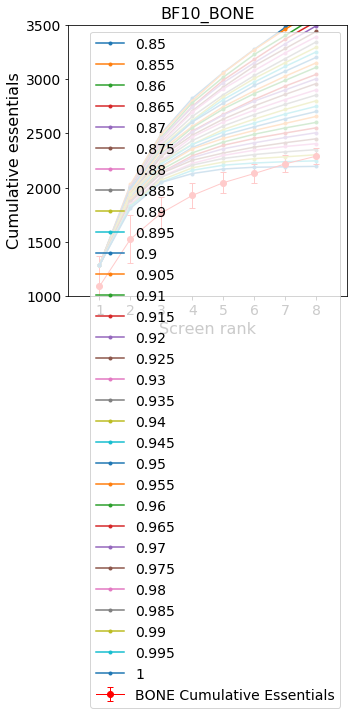

None


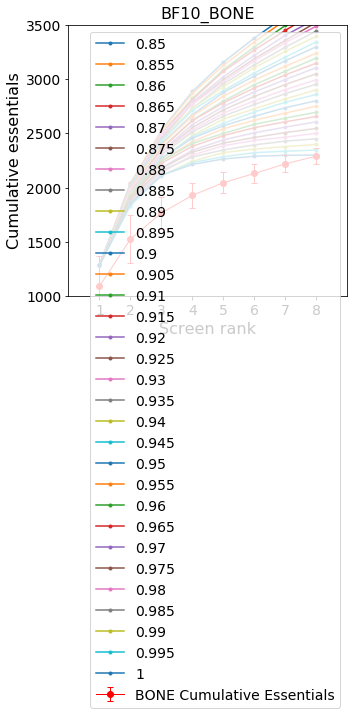

None


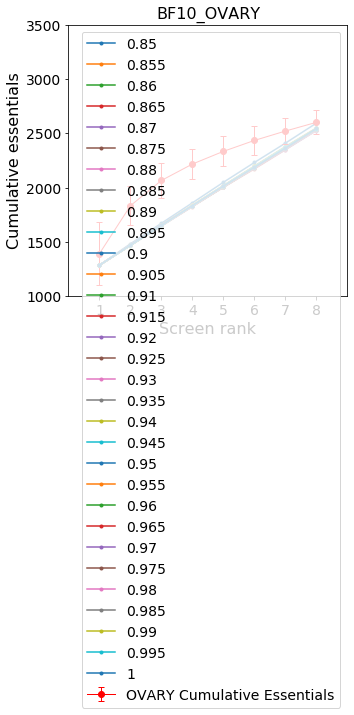

None


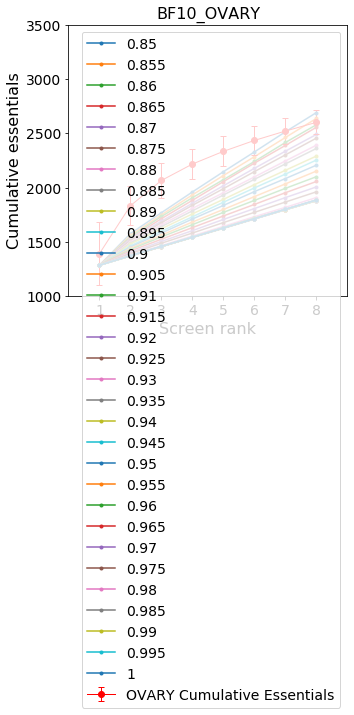

None


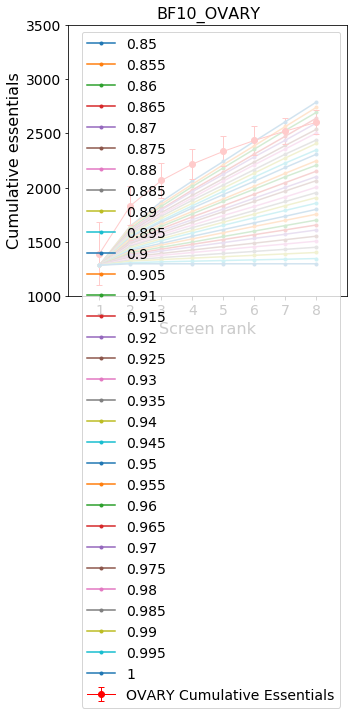

None


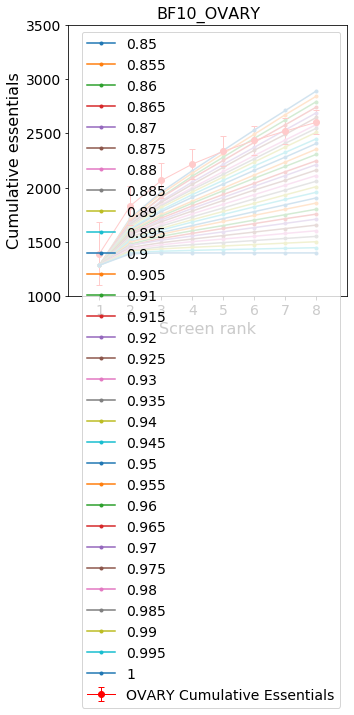

None


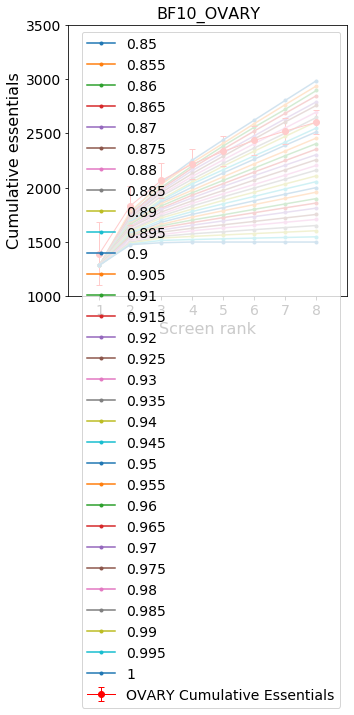

None


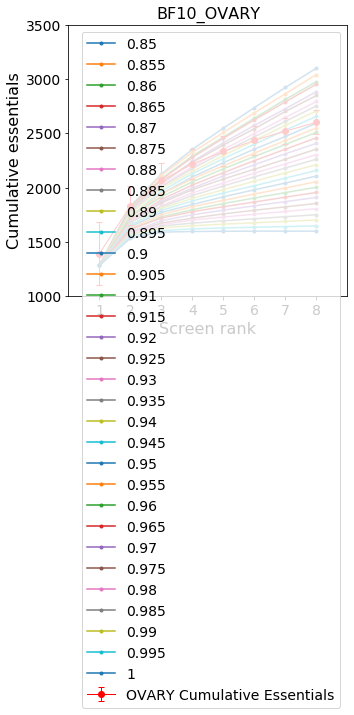

None


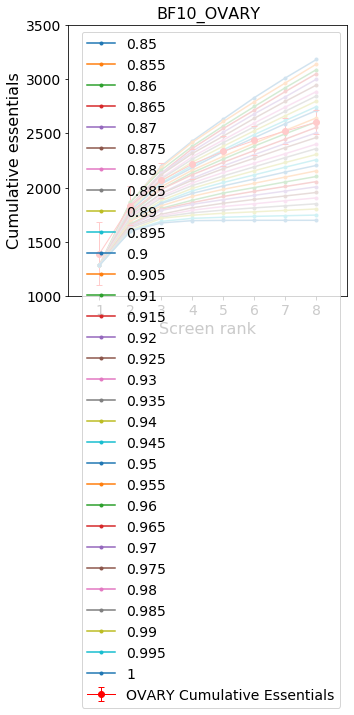

None


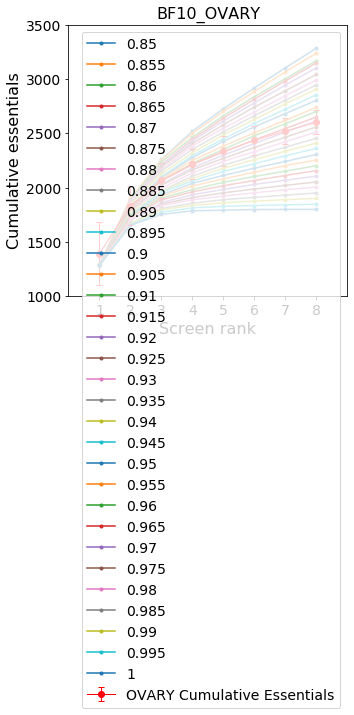

None


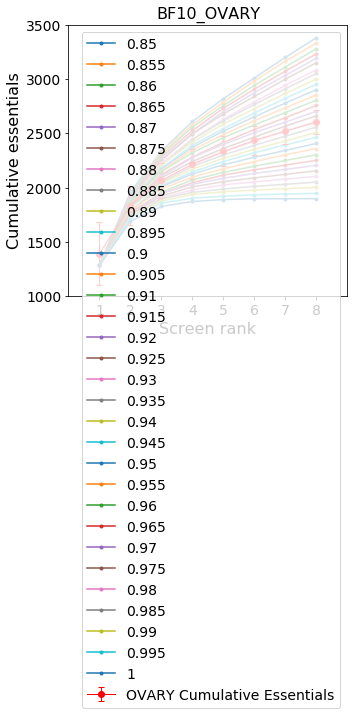

None


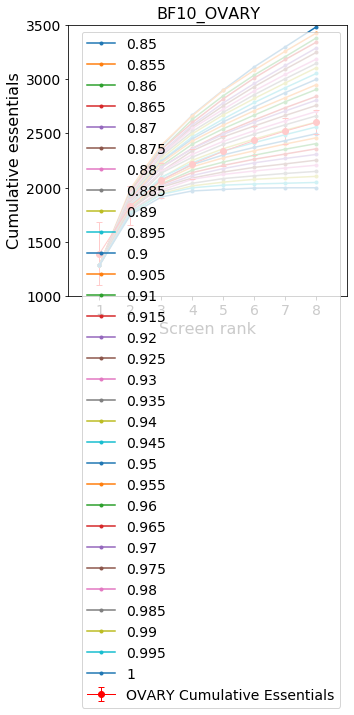

None


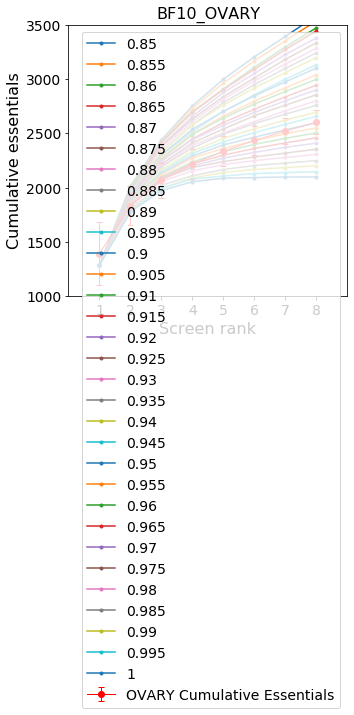

None


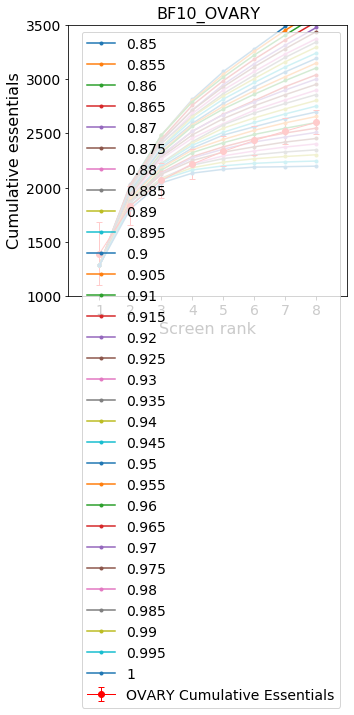

None


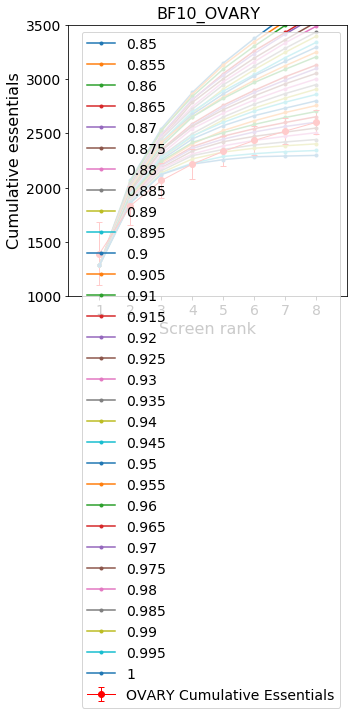

None


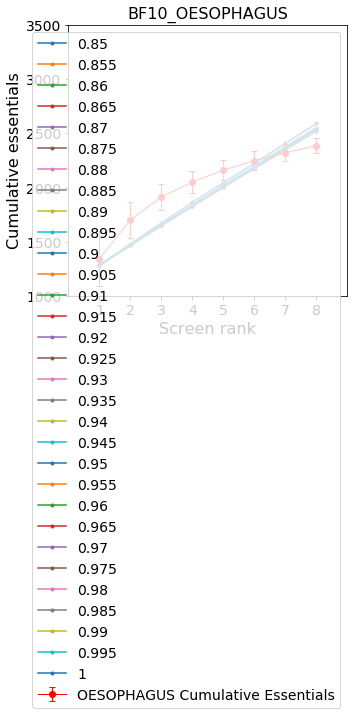

None


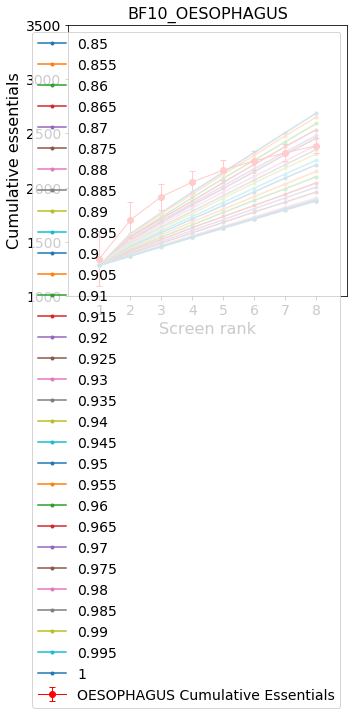

None


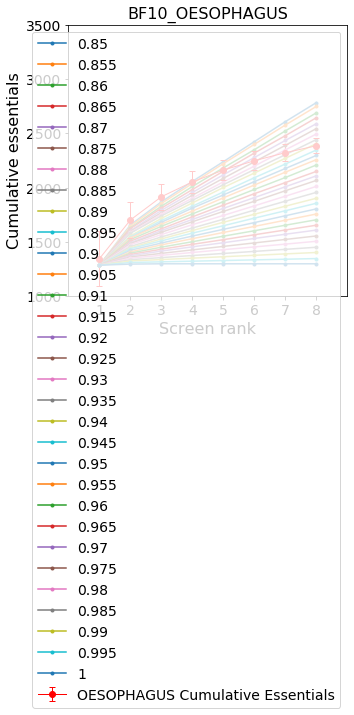

None


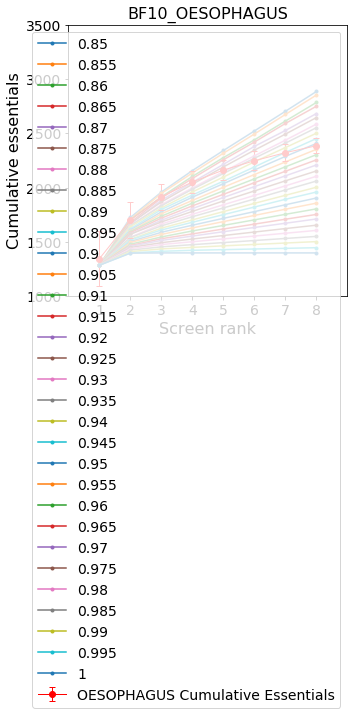

None


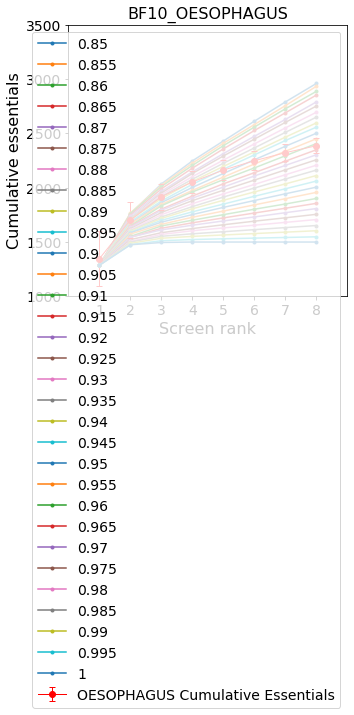

None


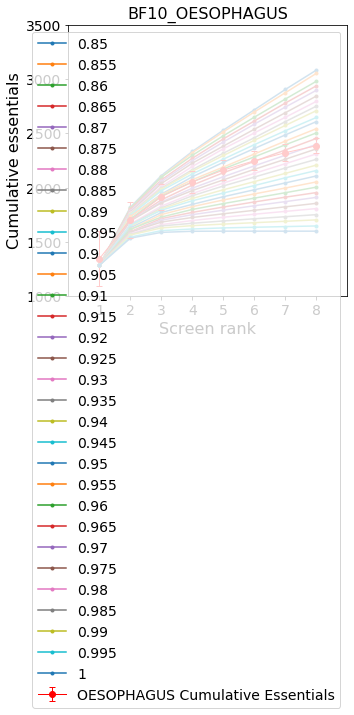

None


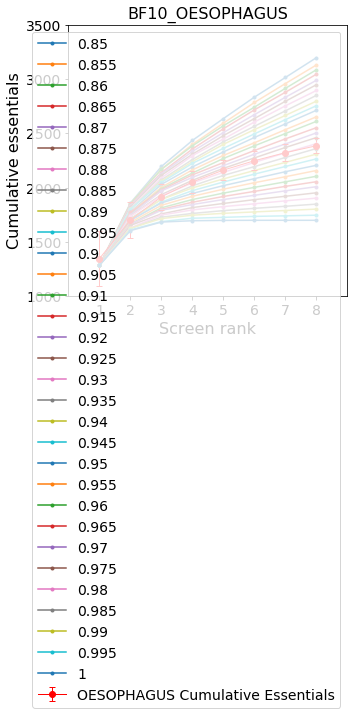

None


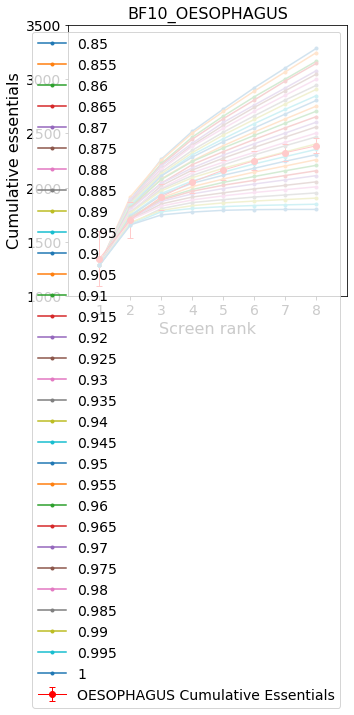

None


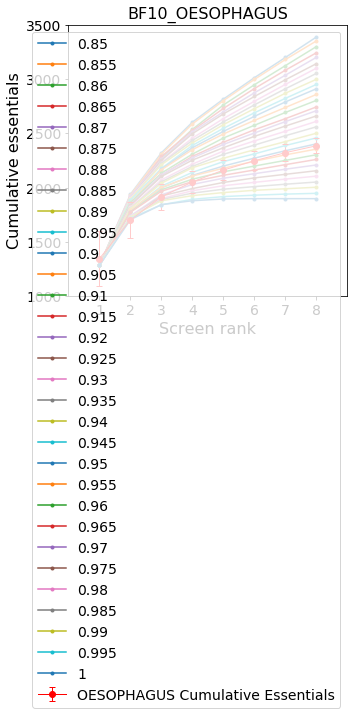

None


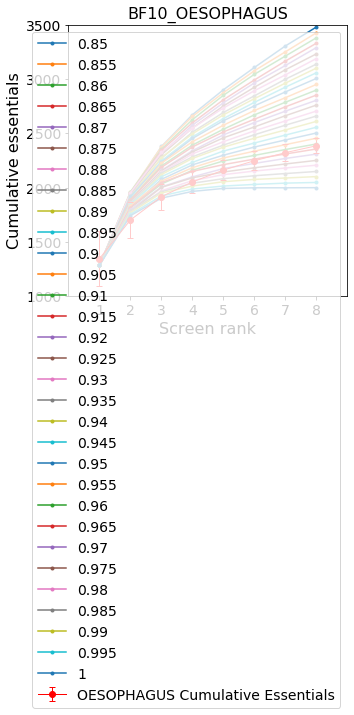

None


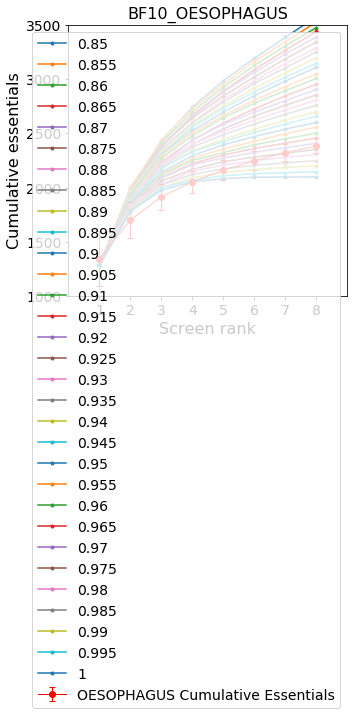

None


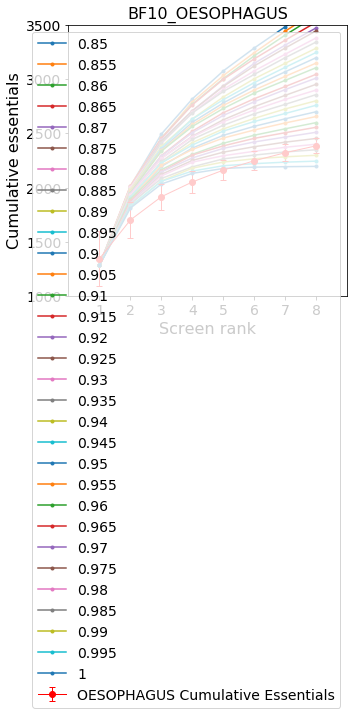

None


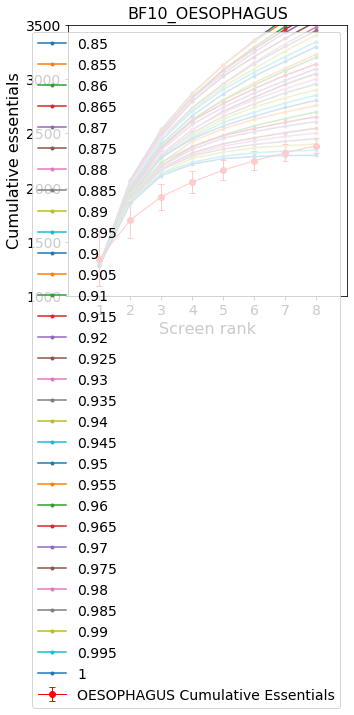

None


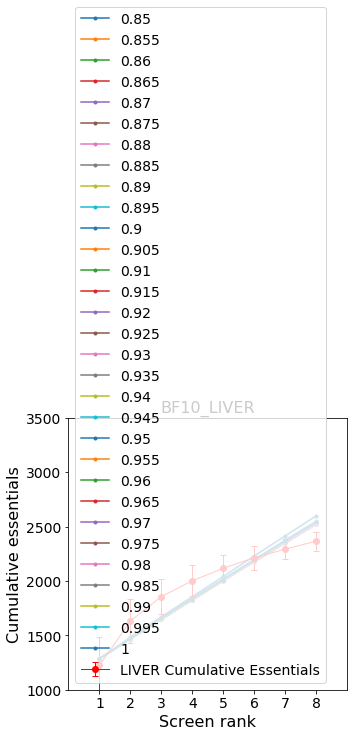

None


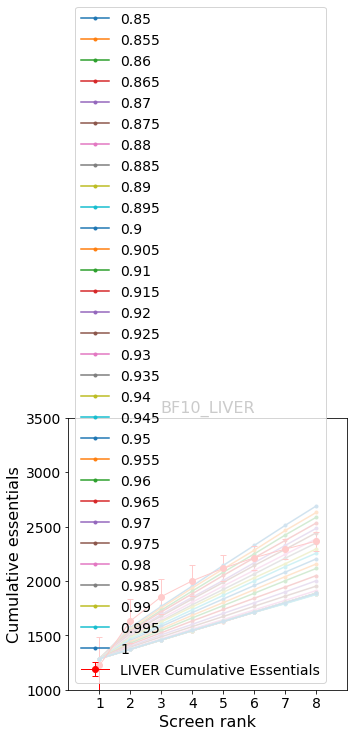

None


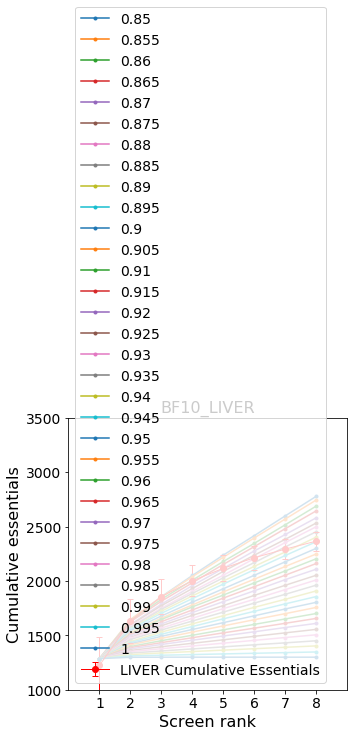

None


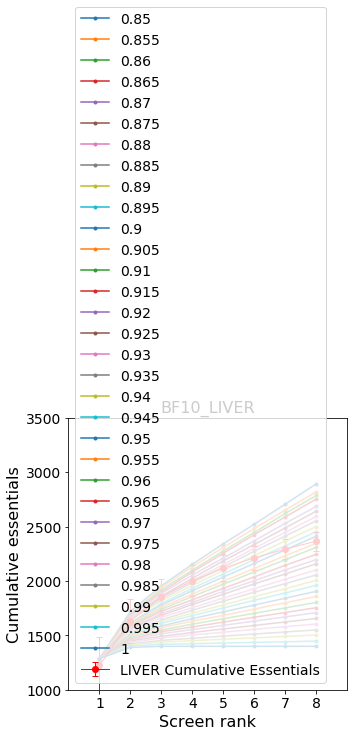

None


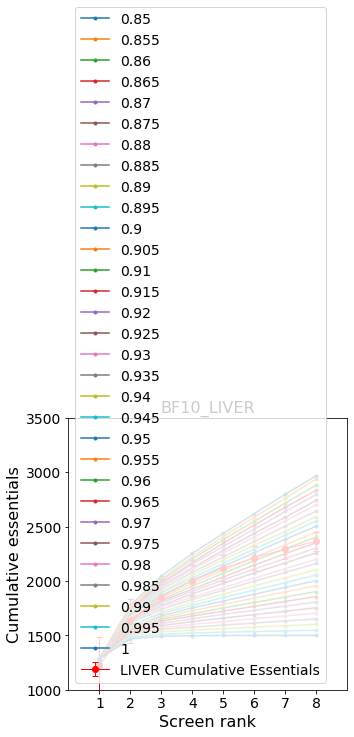

None


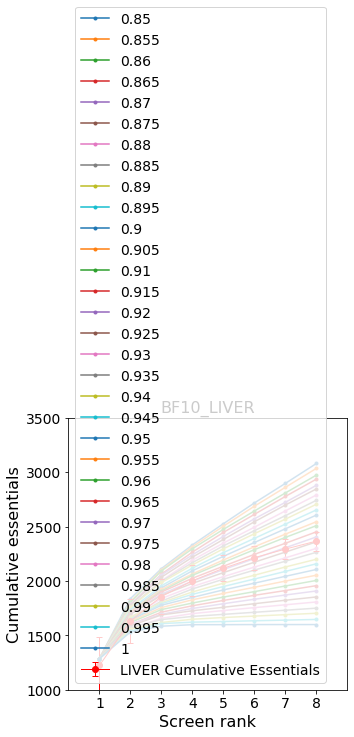

None


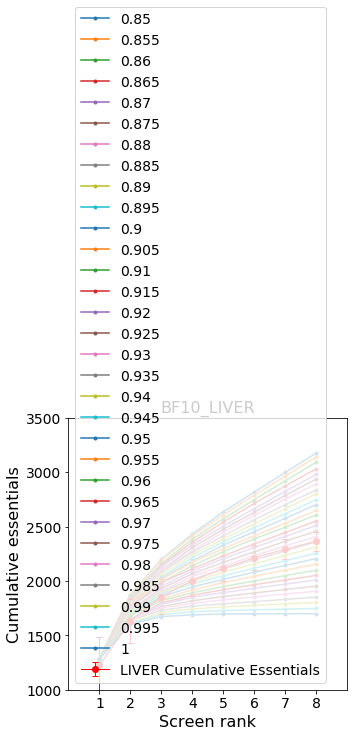

None


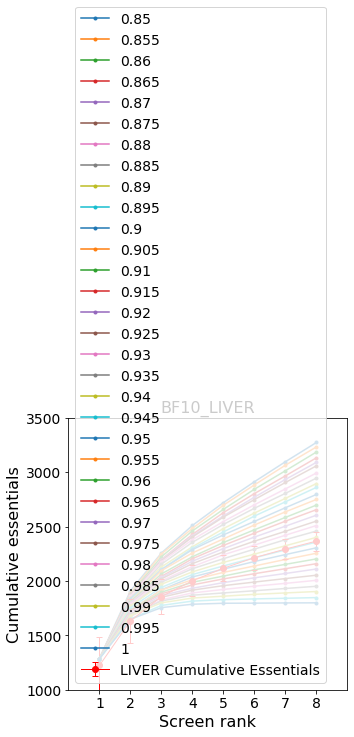

None


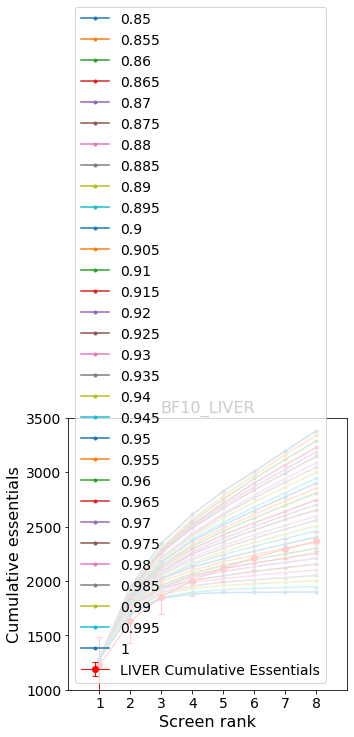

None


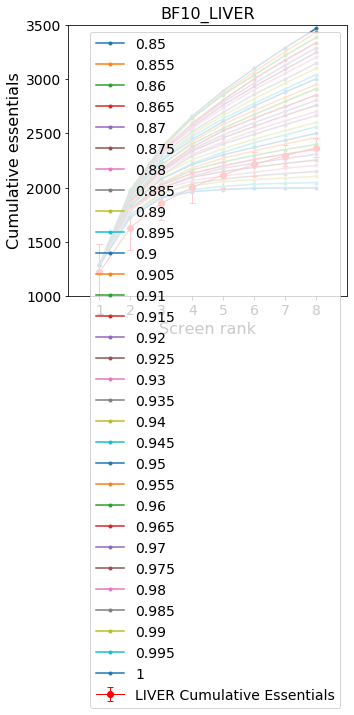

None


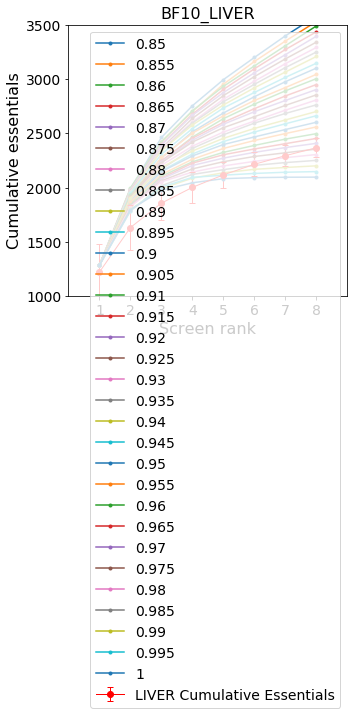

None


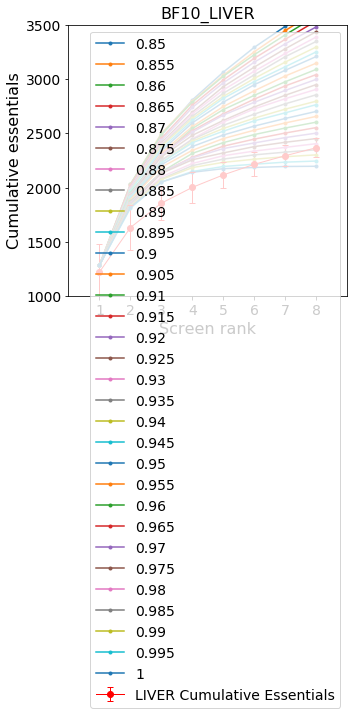

None


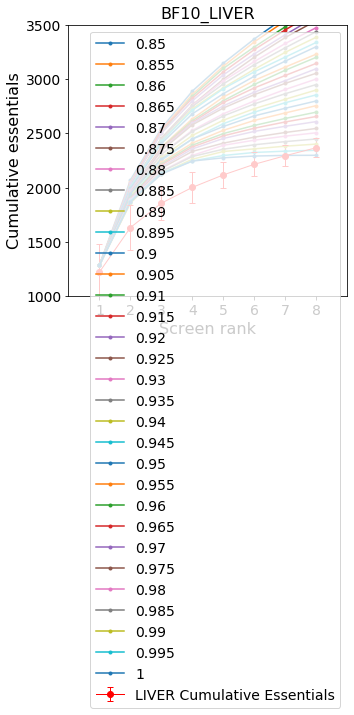

None


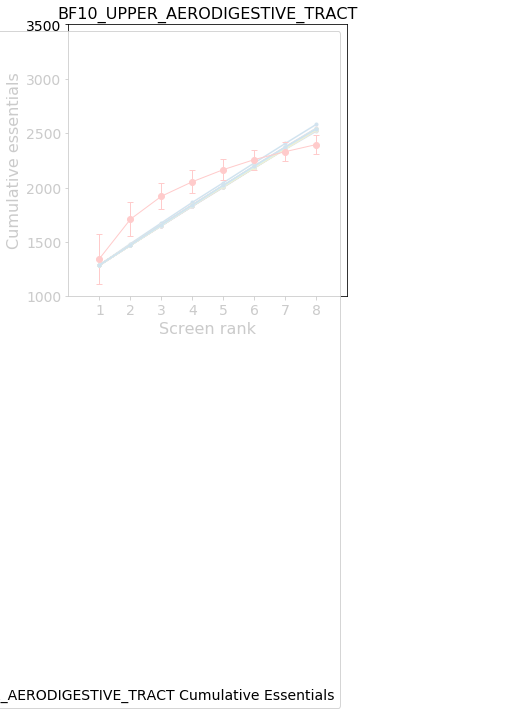

None


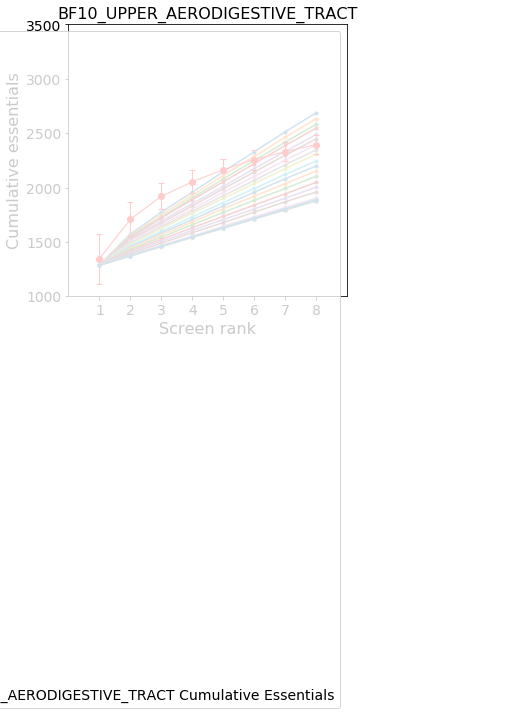

None


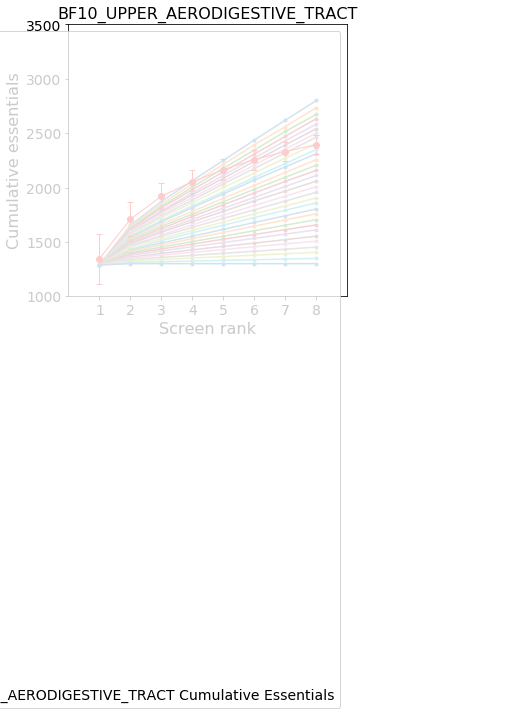

None


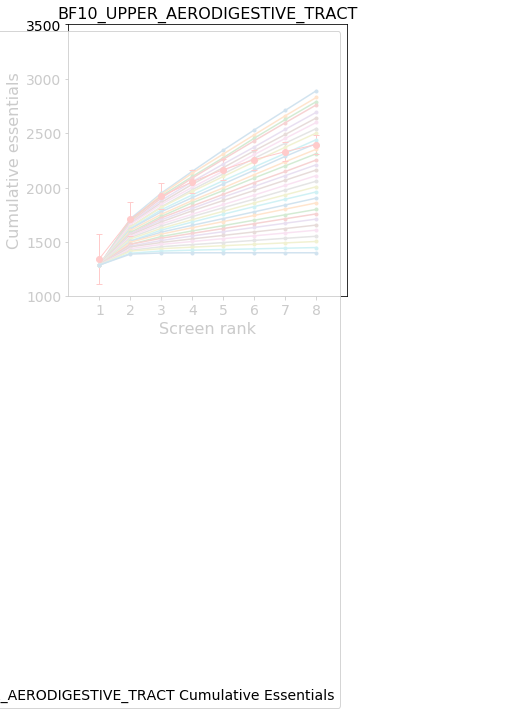

None


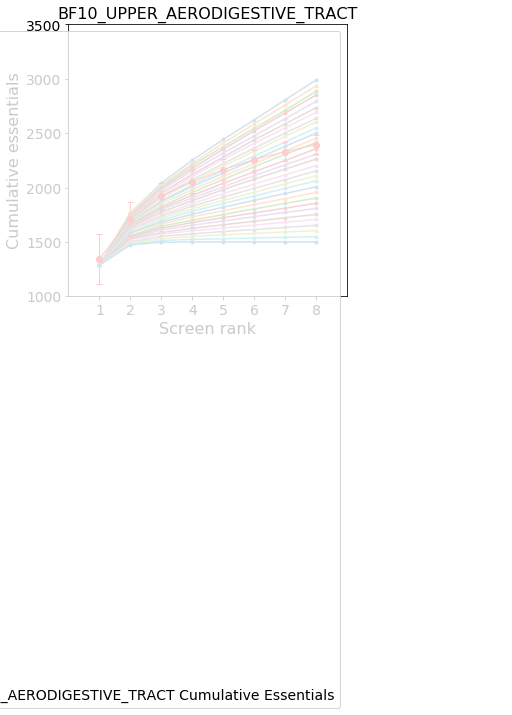

None


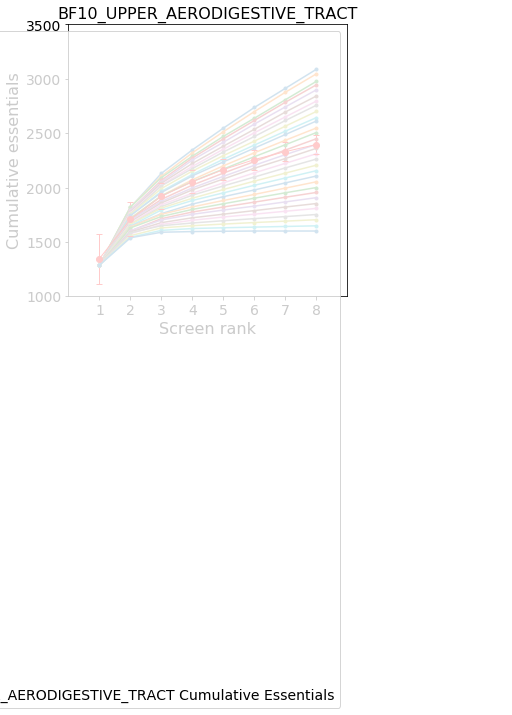

None


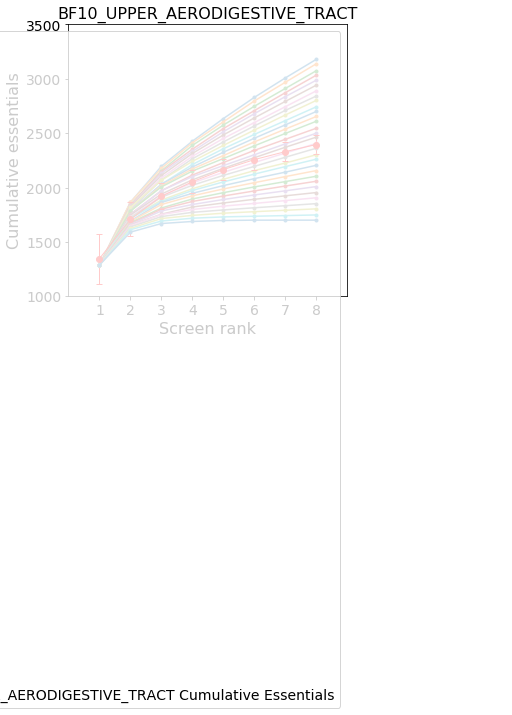

None


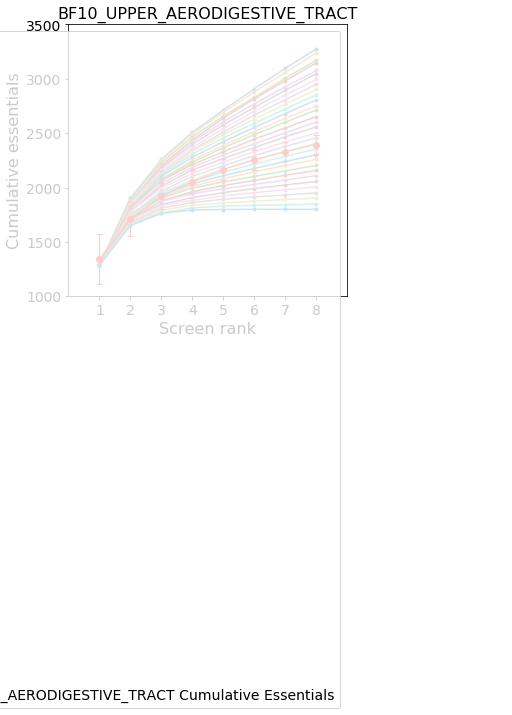

None


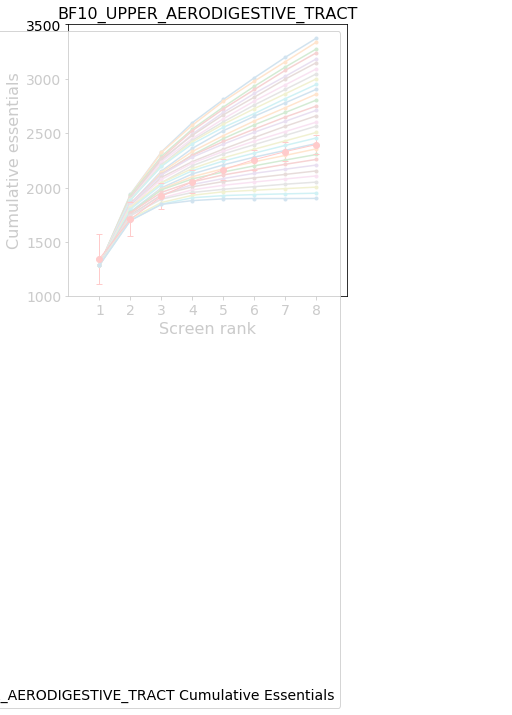

None


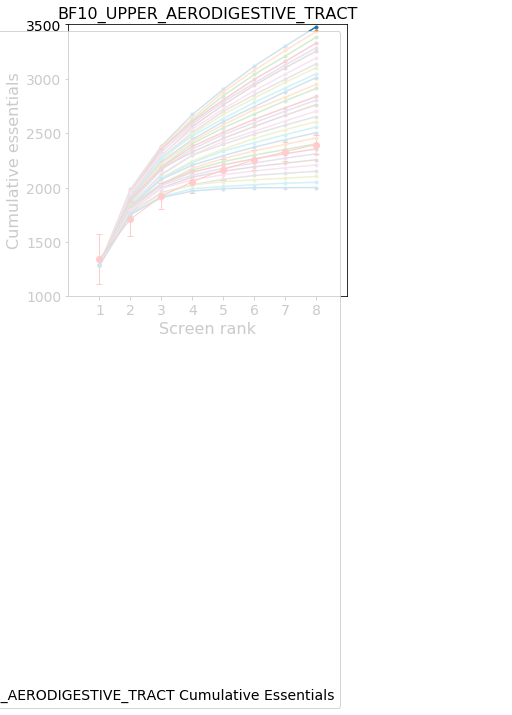

None


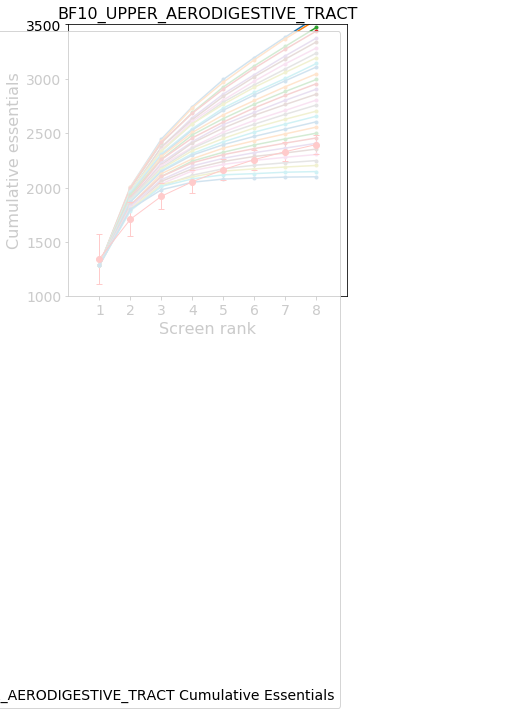

None


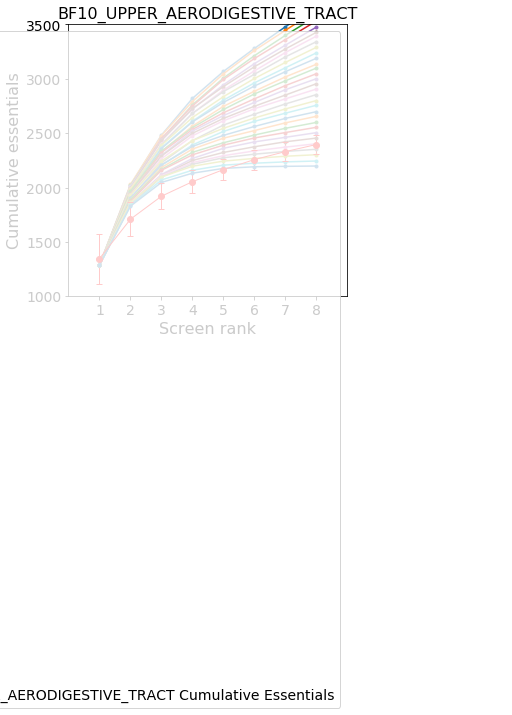

None


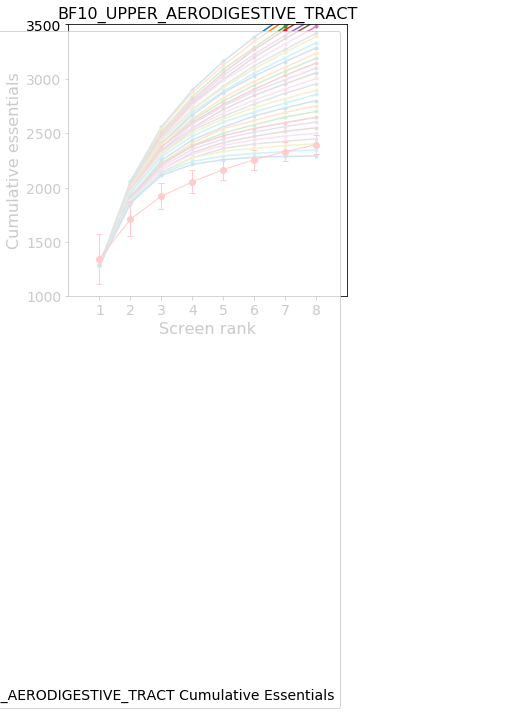

None


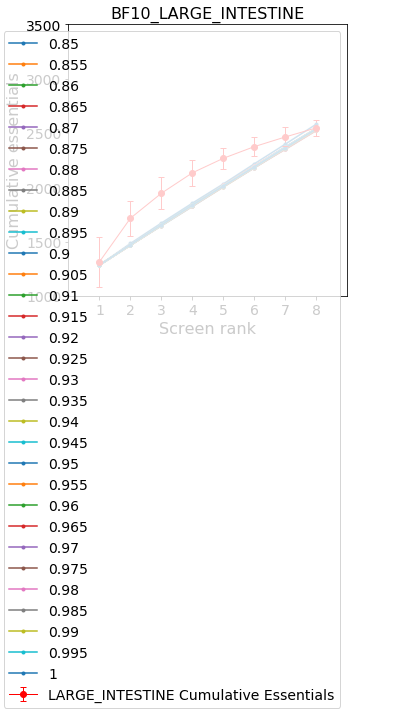

None


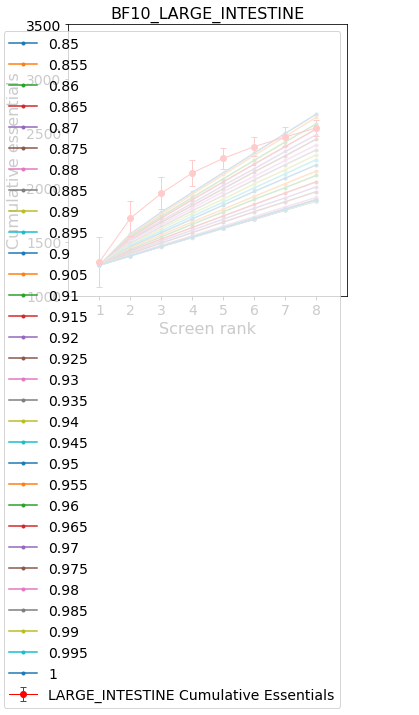

None


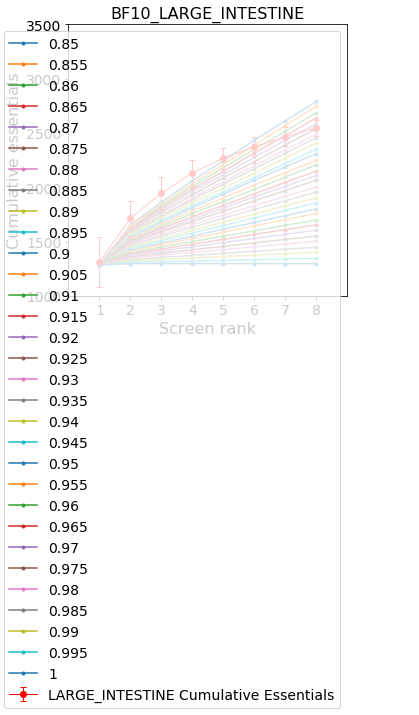

None


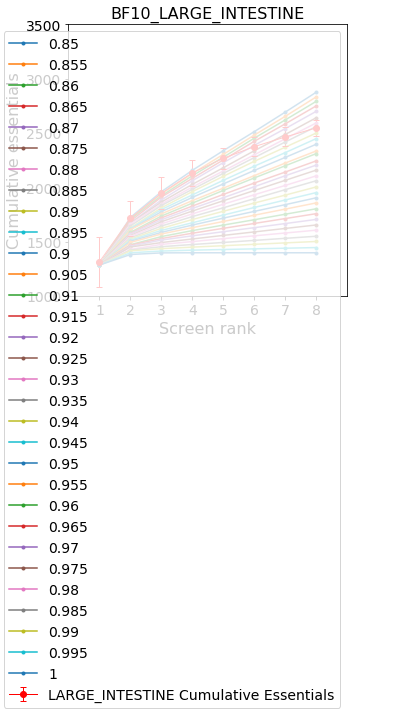

None


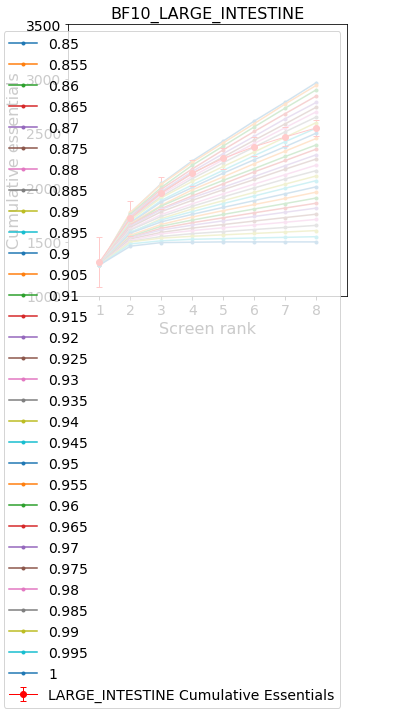

None


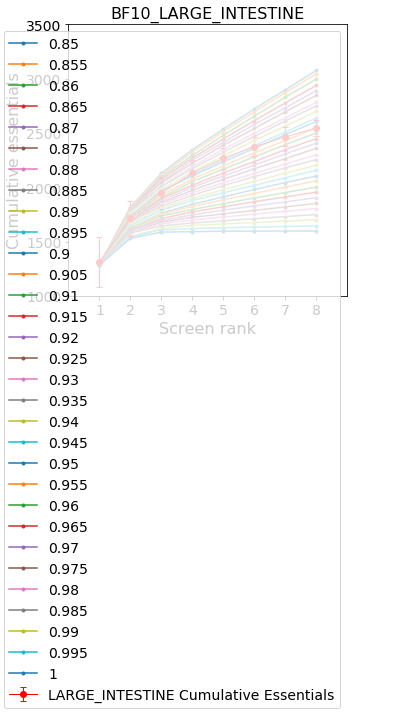

None


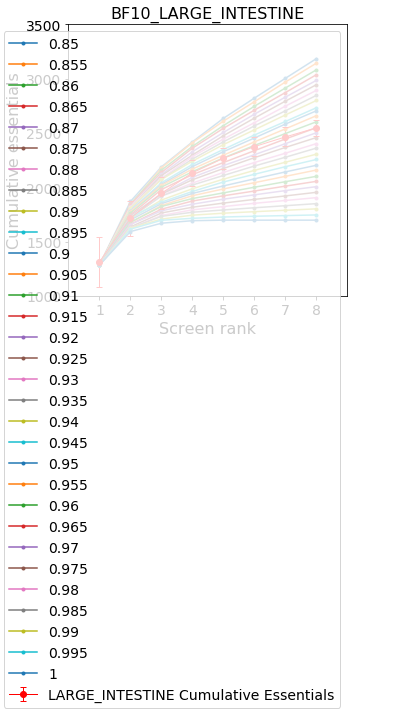

None


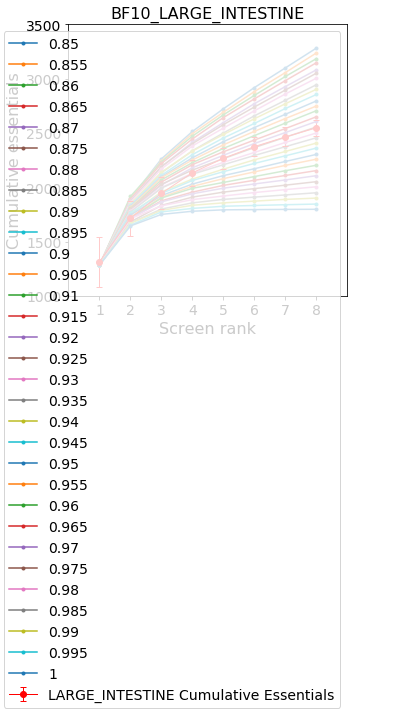

None


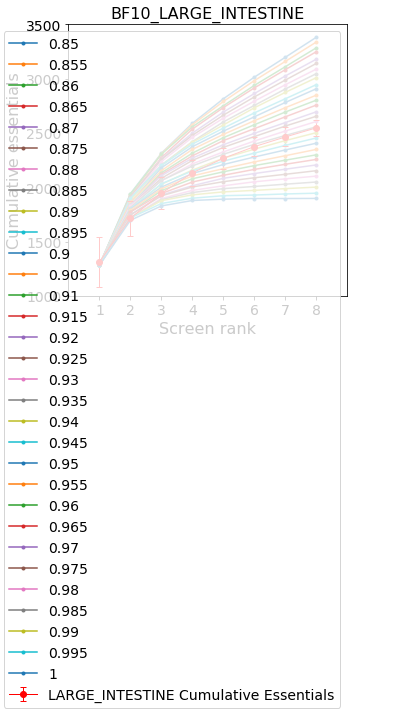

None


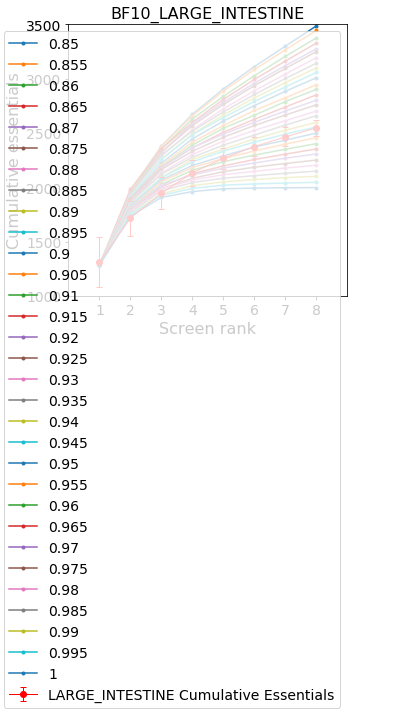

None


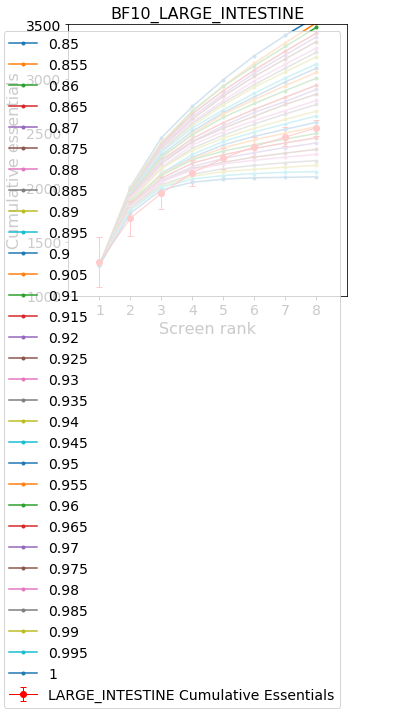

None


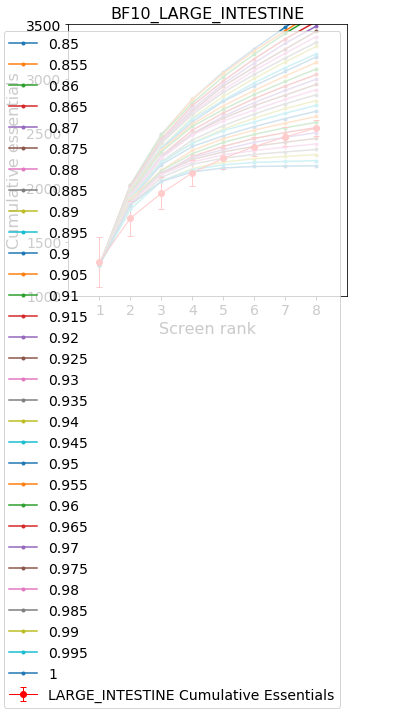

None


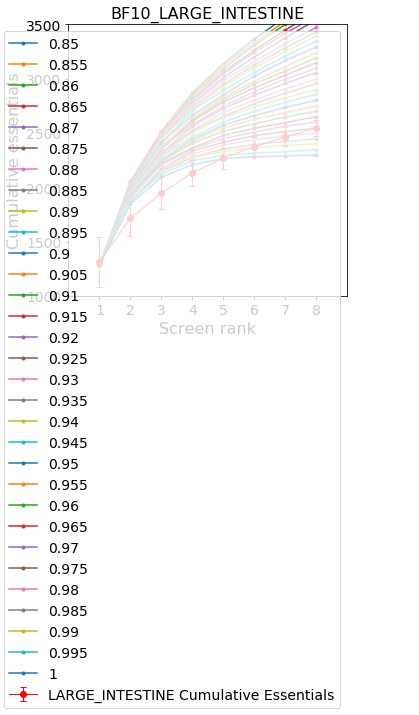

None


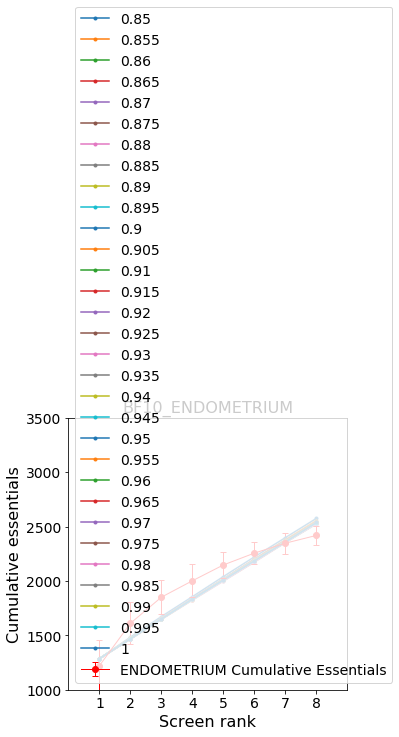

None


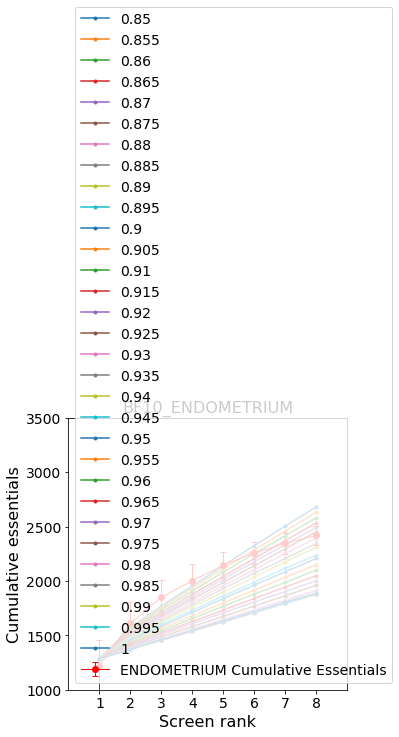

None


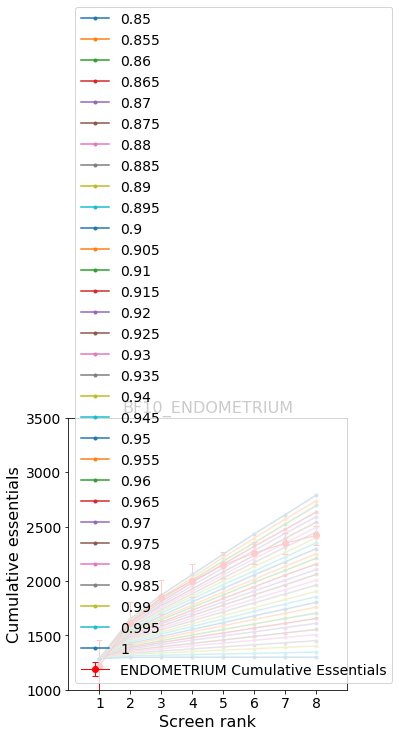

None


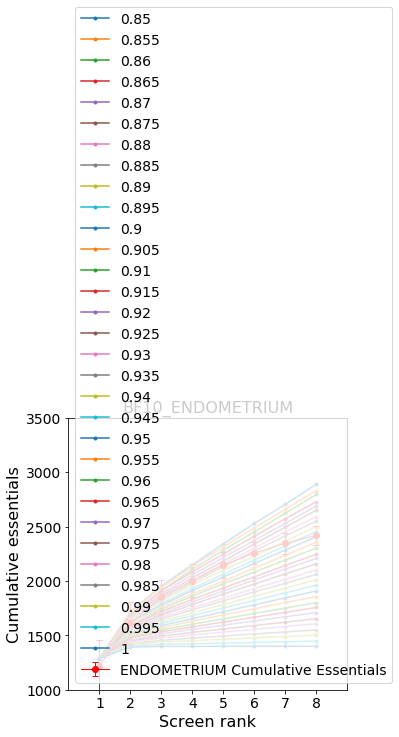

None


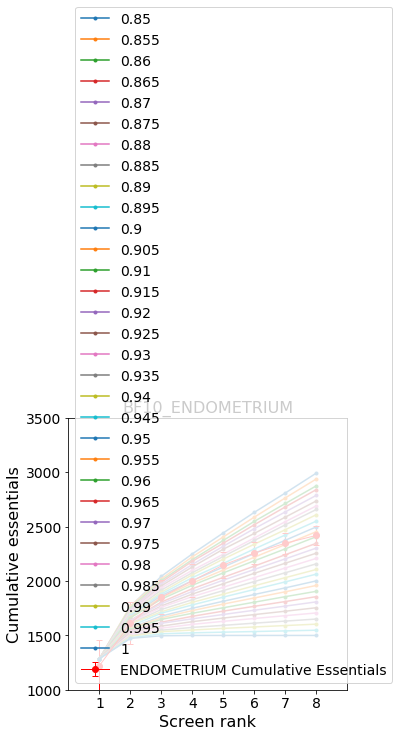

None


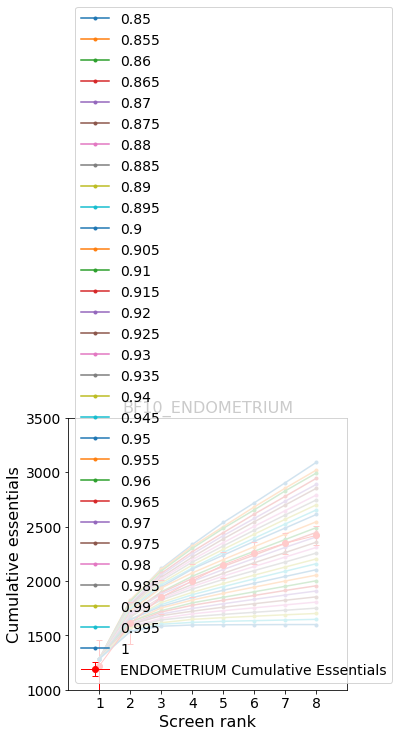

None


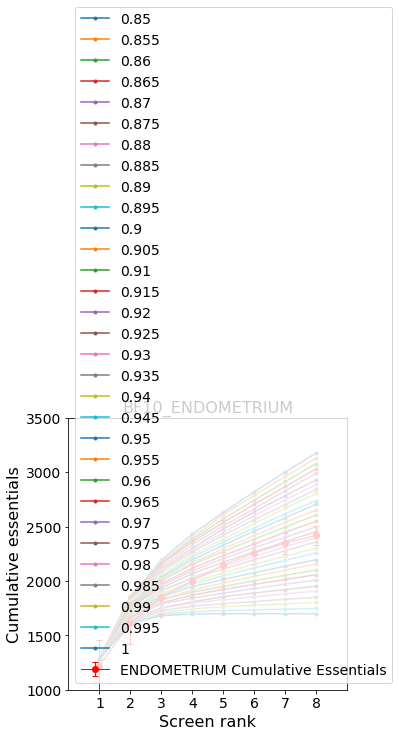

None


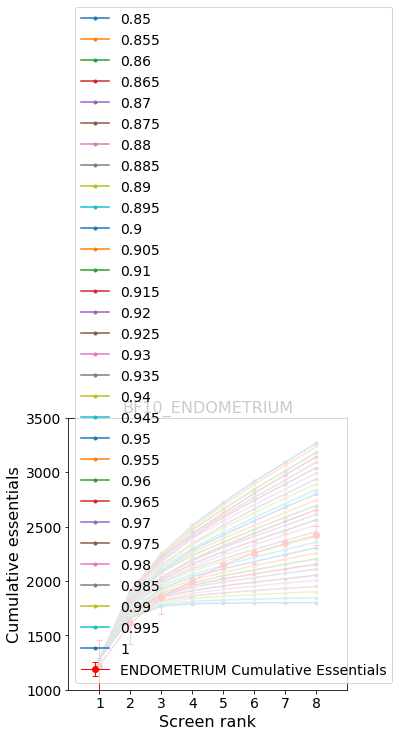

None


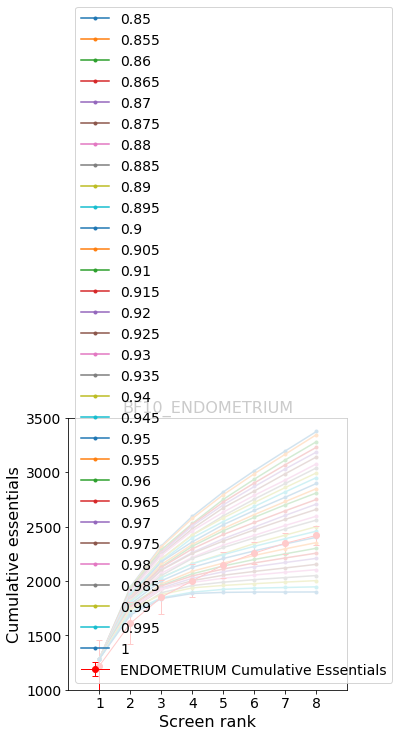

None


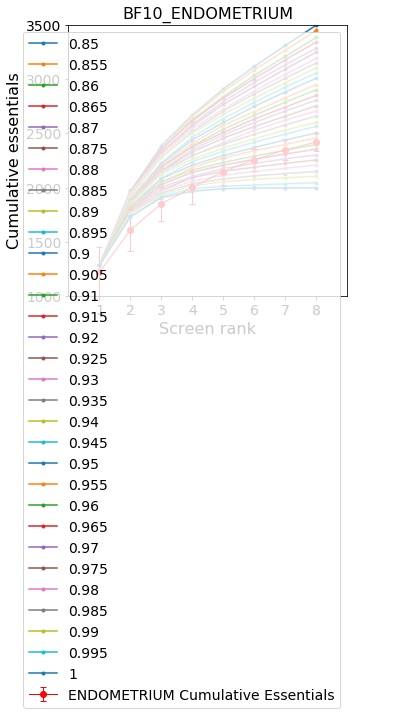

None


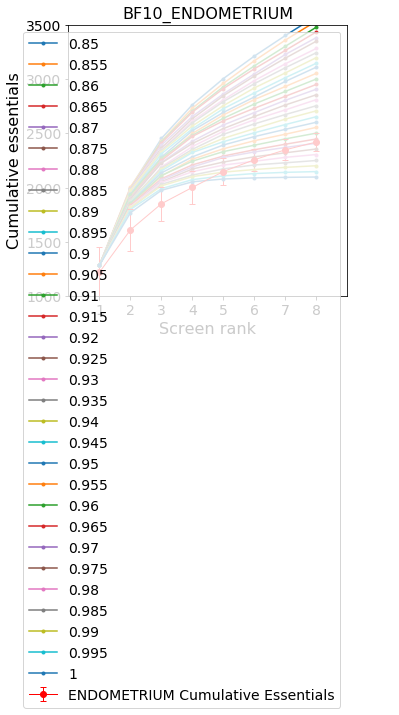

None


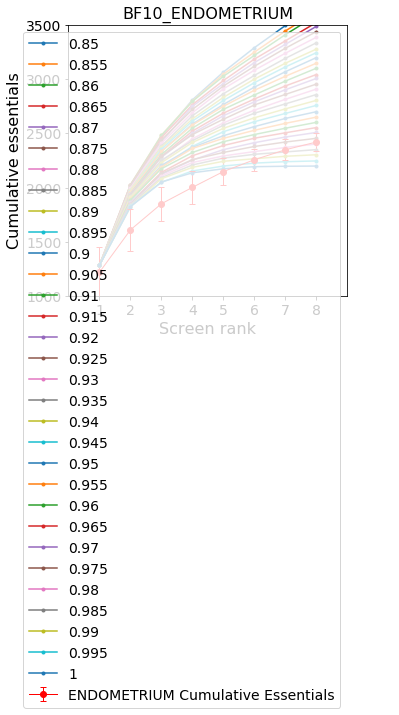

None


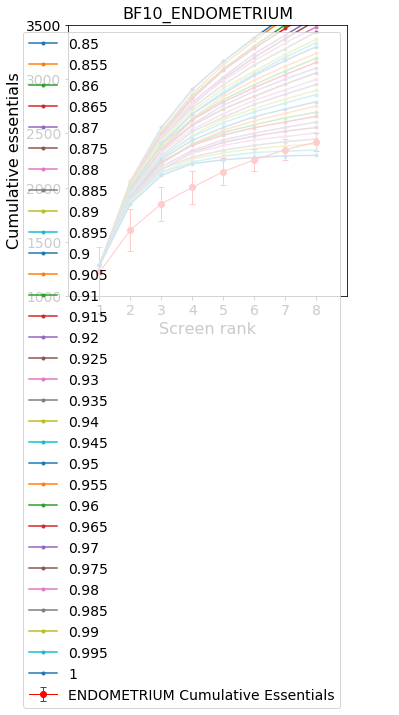

None


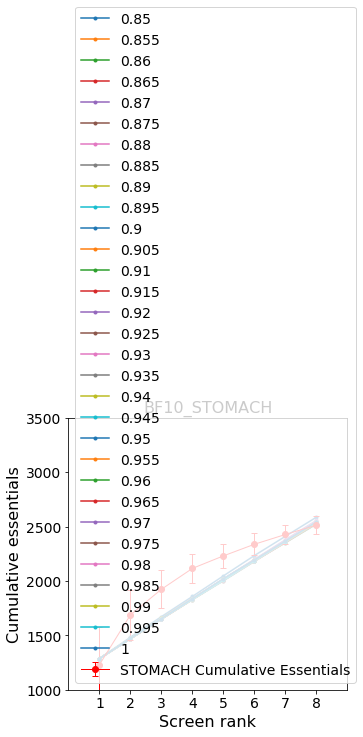

None


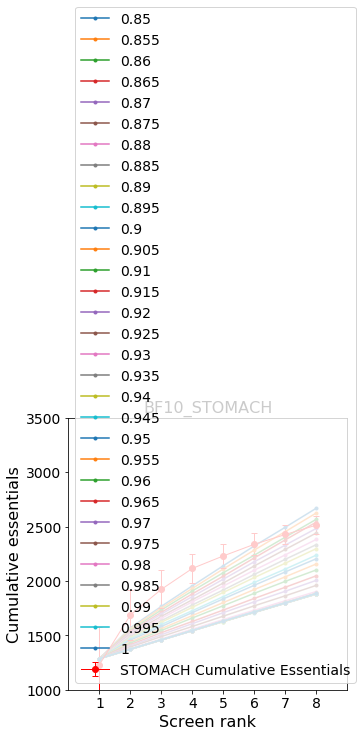

None


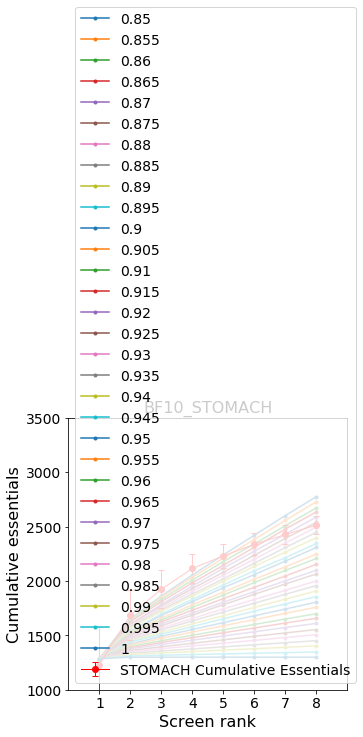

None


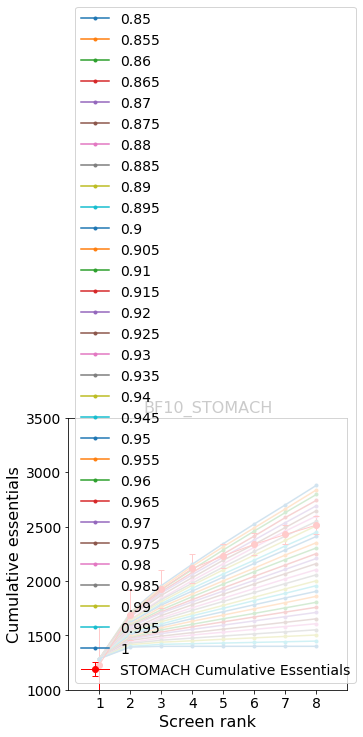

None


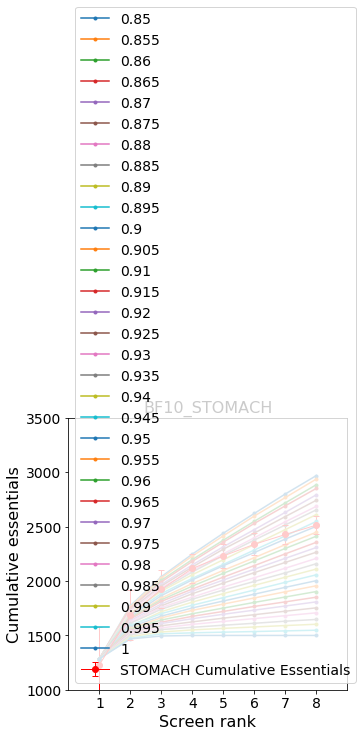

None


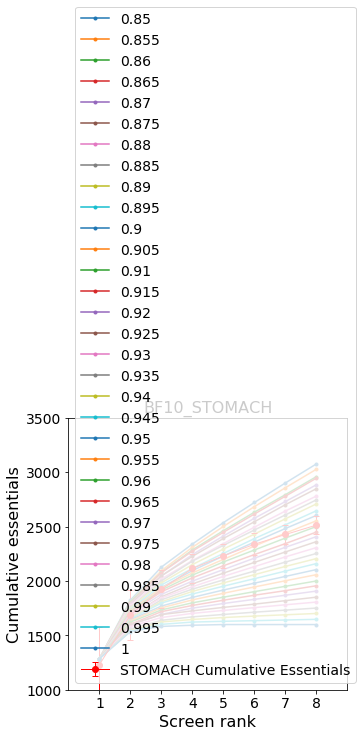

None


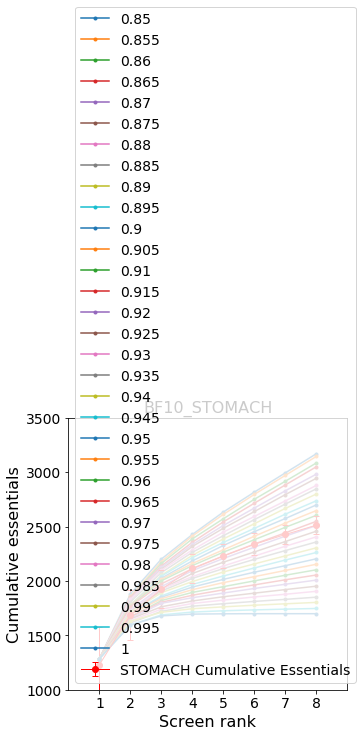

None


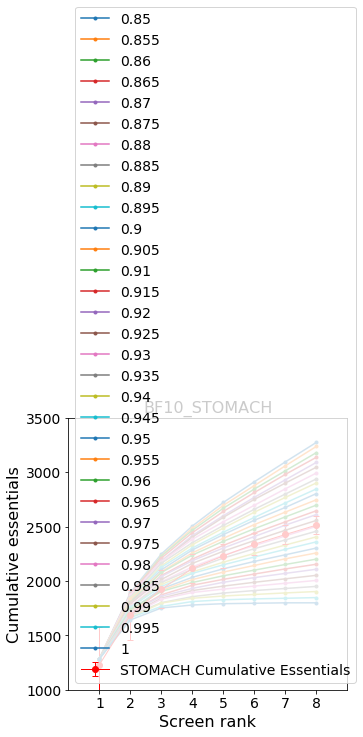

None


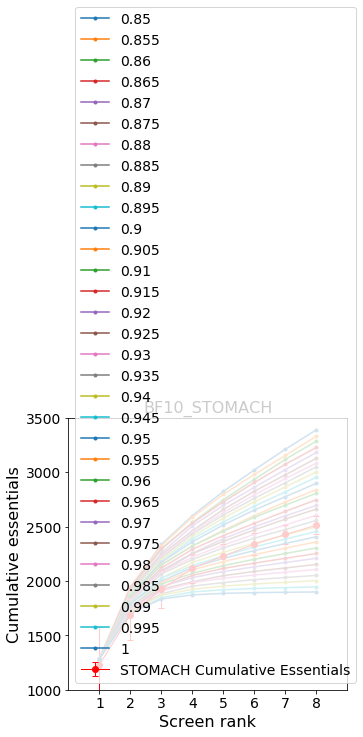

None


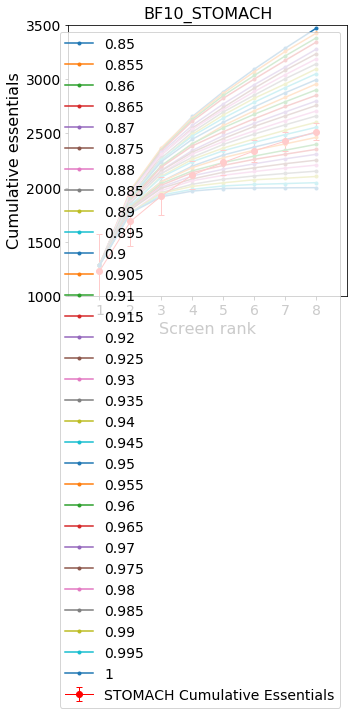

None


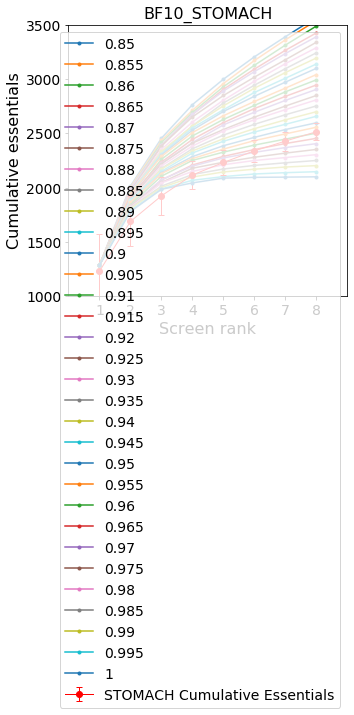

None


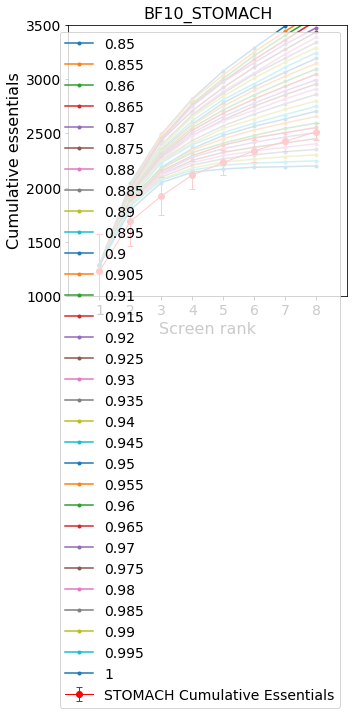

None


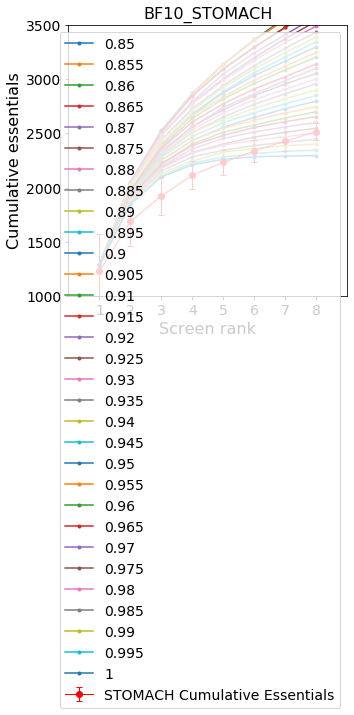

None


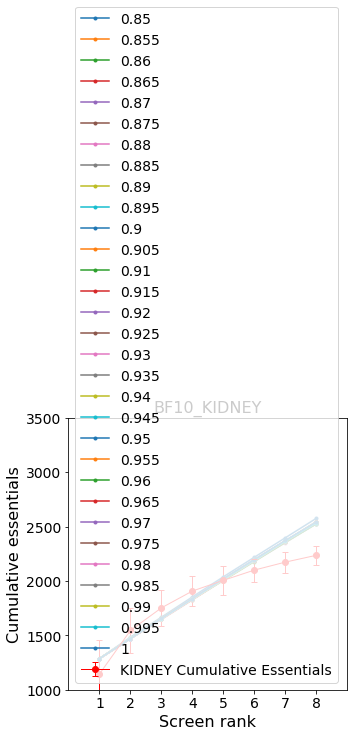

None


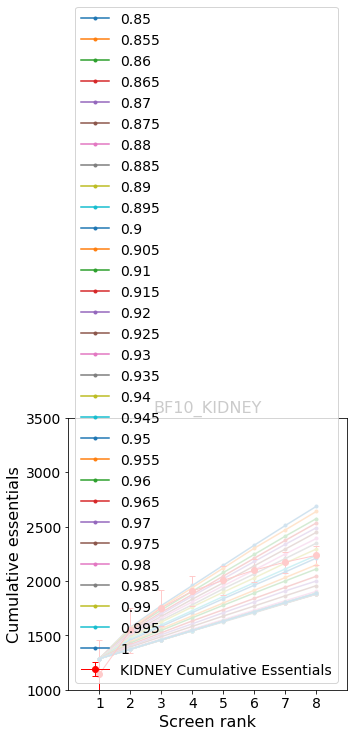

None


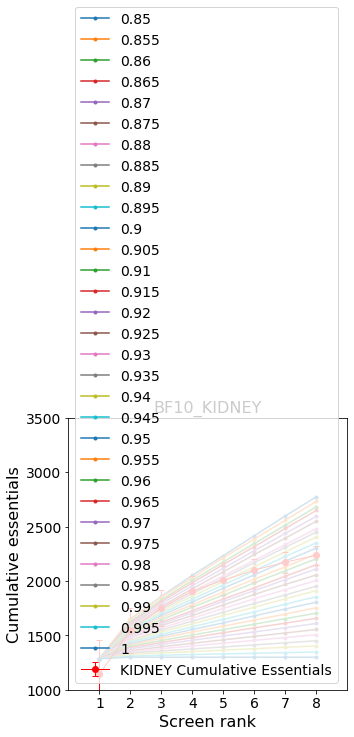

None


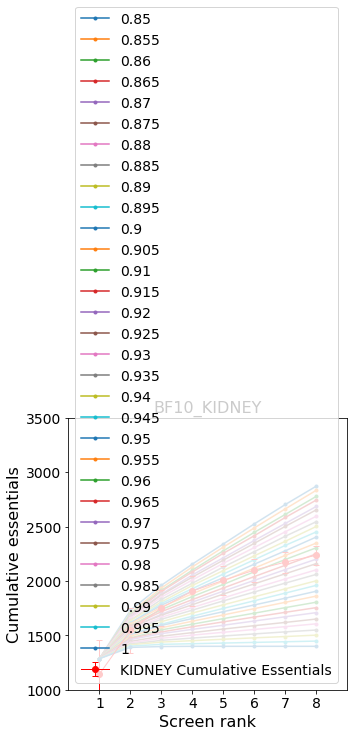

None


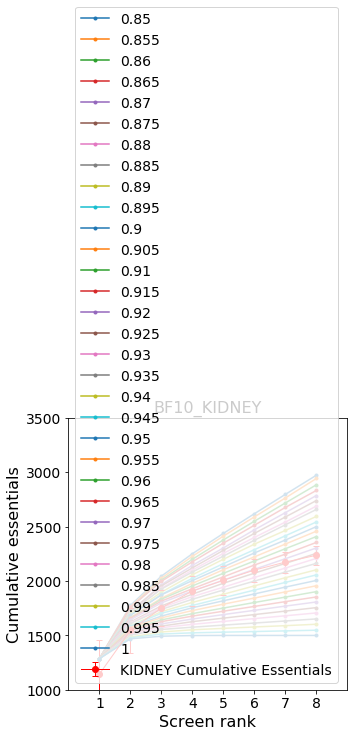

None


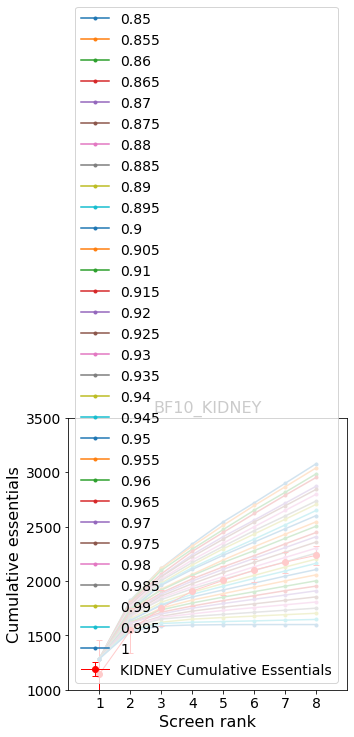

None


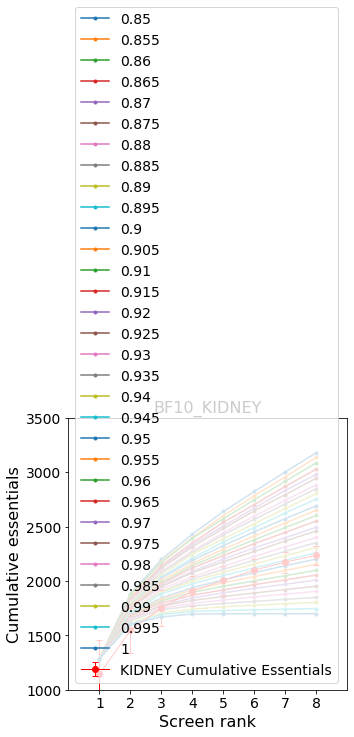

None


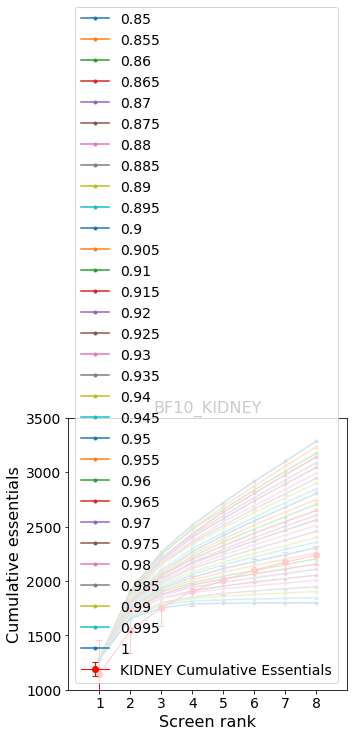

None


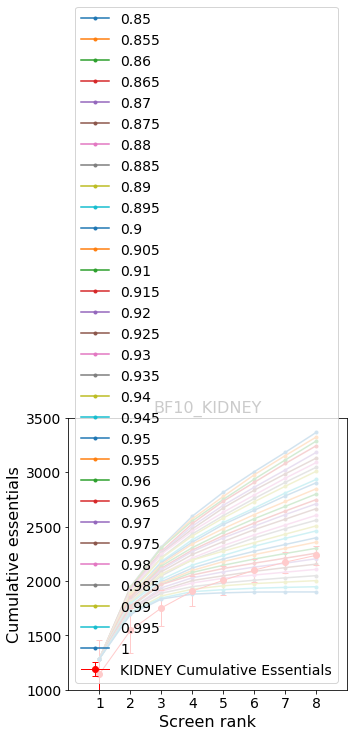

None


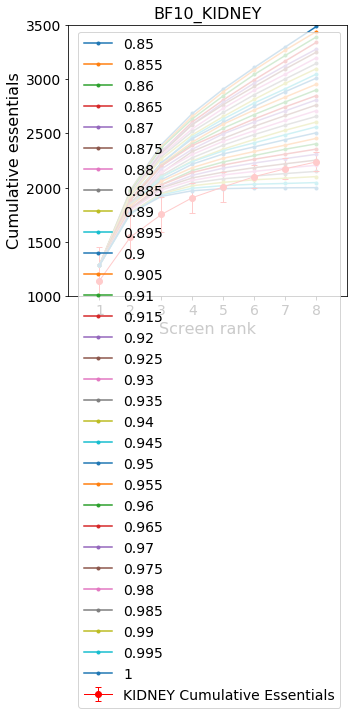

None


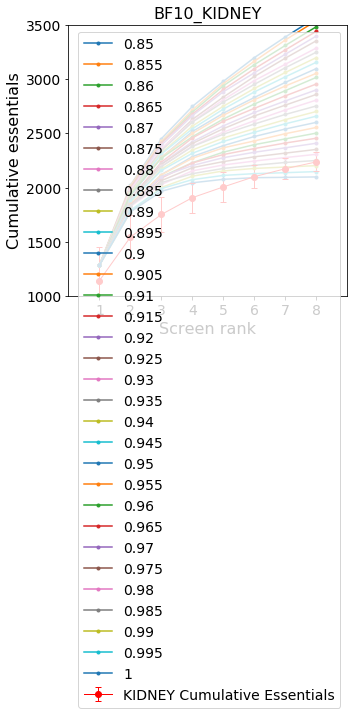

None


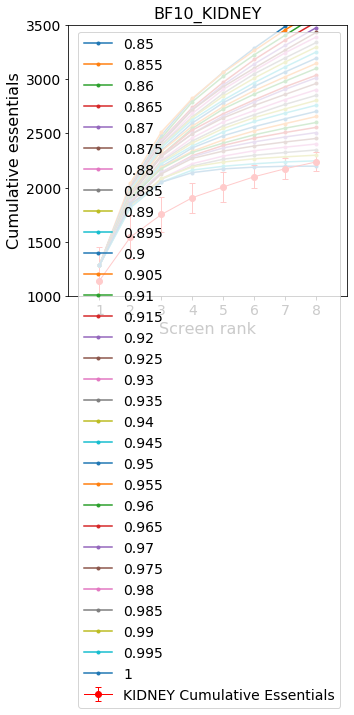

None


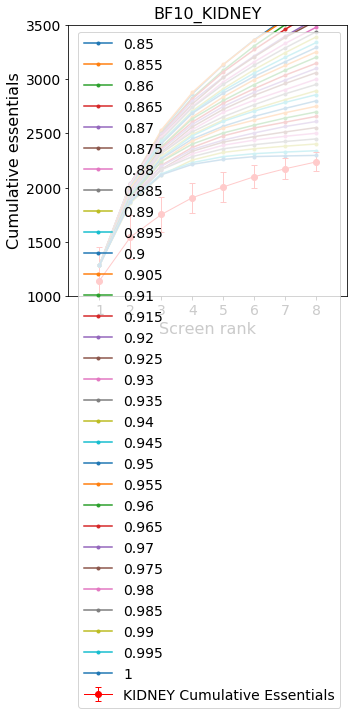

None


In [41]:
BF10_rmse_tissue_FDR_main=dict()

different_n=(1100,1200,1300,1400, 1500,1600,1700,1800,1900,2000,2100,2200,2300)
different_precision=(0.850,0.855,0.860,0.865,0.870,0.875,0.880,0.885,0.890,0.895,0.900,0.905,0.910, 0.915,0.920,0.925, 0.930,0.935, 0.940,0.945, 0.950,0.955, 0.960, 0.965,  0.970, 0.975, 0.980,0.985, 0.990, 0.995,1)

for j in tissue_names:
    BF10_rmse_tissue_FDR=dict()
    for i in different_n:
    
        
        BF10_rmse_tissue_FDR[i]=get_rmse_from_beginning_8_screens_MEAN_tissues(18111,i,different_precision, j, 1287) #sample 1287 hits
    
    BF10_rmse_tissue_FDR_main[j]=BF10_rmse_tissue_FDR
 



In [42]:
BF10_rmse_tissue_FDR_main

{'BILIARY_TRACT': {1100: {0.85: 204.14968077981405,
   0.855: 220.72428426093032,
   0.86: 225.2052778300277,
   0.865: 221.02878695432403,
   0.87: 221.33790267936482,
   0.875: 221.40726537875844,
   0.88: 224.95401677342855,
   0.885: 219.33286840439573,
   0.89: 221.87112737465407,
   0.895: 218.82539766329677,
   0.9: 223.7078556119565,
   0.905: 219.94292364724984,
   0.91: 224.6456980725426,
   0.915: 217.4499532363711,
   0.92: 219.84645133024088,
   0.925: 224.17471905301892,
   0.93: 222.85087987822703,
   0.935: 222.36109633319396,
   0.94: 225.48910652734418,
   0.945: 222.6869768587736,
   0.95: 227.33975051121166,
   0.955: 221.29049835566818,
   0.96: 223.41141905126509,
   0.965: 219.97395791888633,
   0.97: 222.25087100504234,
   0.975: 218.37831774812256,
   0.98: 228.92323421291246,
   0.985: 220.98447832936134,
   0.99: 223.04780241576015,
   0.995: 219.11742208802104,
   1: 221.022769556668},
  1200: {0.85: 147.2463315756966,
   0.855: 153.1999009872395,
   0.86: 1

In [43]:
import seaborn as sns

In [44]:
for i,j in zip(BF10_rmse_tissue_FDR_main, tissue_names):
    globals()['BF10_df_rmse_FDR_%s' % j]= pd.DataFrame([(k,l,BF10_rmse_tissue_FDR_main[i][k][l]) for k in BF10_rmse_tissue_FDR_main[i].keys() for l in BF10_rmse_tissue_FDR_main[i][k].keys()], columns=["n", "Precision", "Rmse"])
    globals()['BF10_df_rmse_FDR_%s' % j]=globals()['BF10_df_rmse_FDR_%s' % j].pivot("Precision", "n", "Rmse")



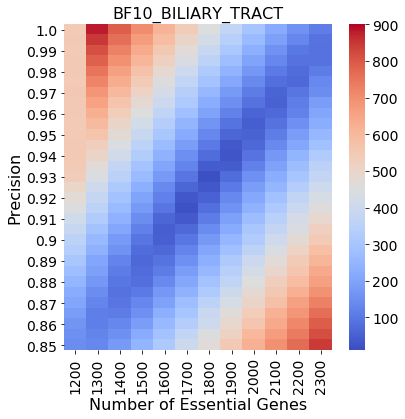

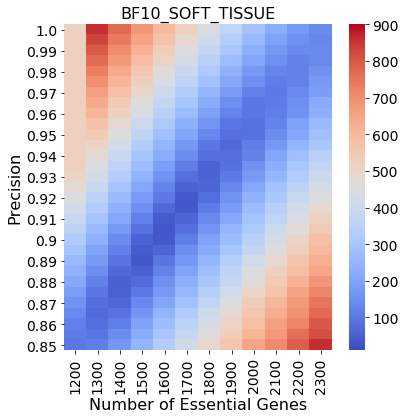

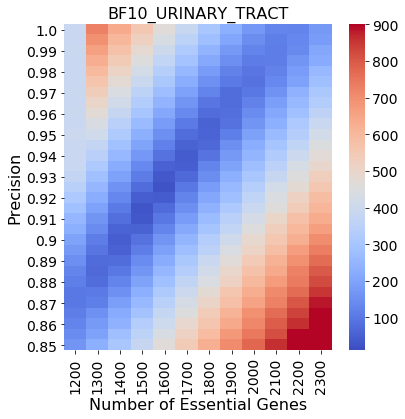

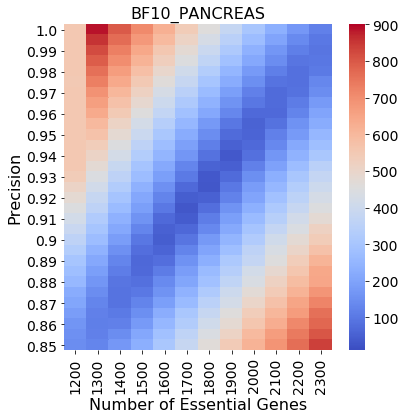

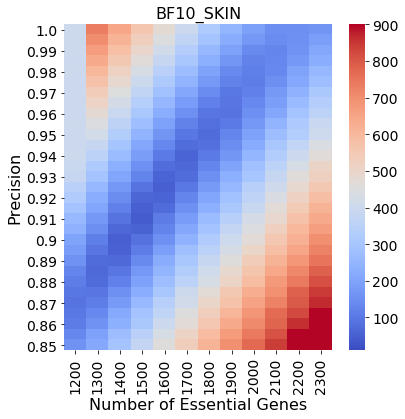

...

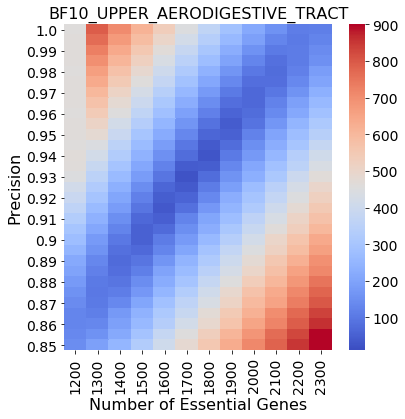

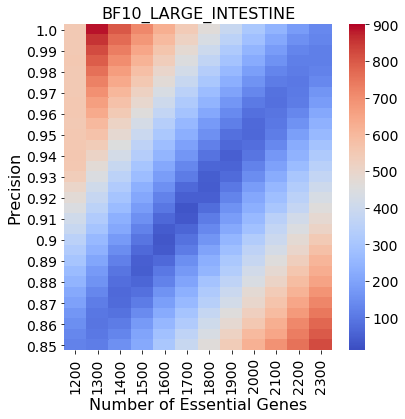

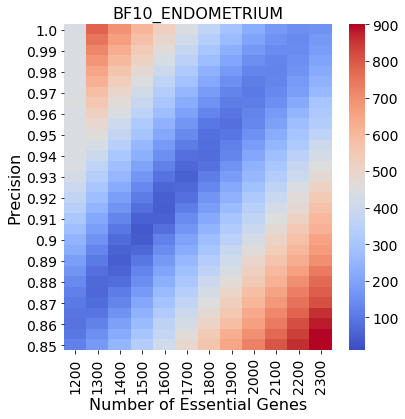

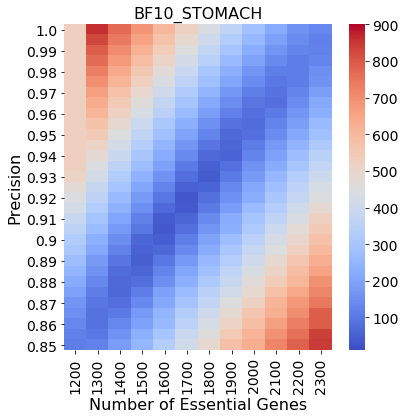

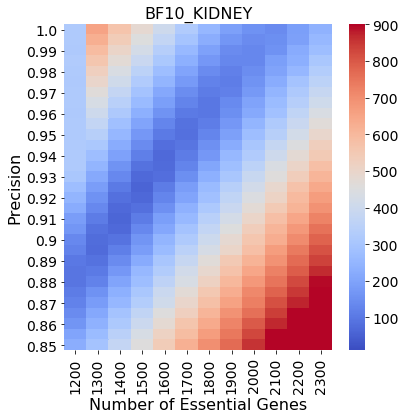

In [57]:
figsize(6,6)
for i in tissue_names:
    
    sns.heatmap(globals()['BF10_df_rmse_FDR_%s' % i].sort_index( ascending=False).iloc[:,1:], cmap="coolwarm", vmin=10, vmax=900)
    
    title('BF10_%s' % i, size=16)
    xticks(rotation=90, size=14)
    ylabel('Precision', size=16)
    xlabel('Number of Essential Genes', size=16)
    yticks(size=14)
    savefig("./model_figs_FIG1/BF10_"+ i + ".png", format="png", dpi=350, bbox_inches='tight')
    savefig("./model_figs_FIG1/BF10_"+ i + ".pdf", format="pdf", bbox_inches='tight')
    plt.show()



In [58]:
color = plt.cm.coolwarm
color.set_under('white',1.0)

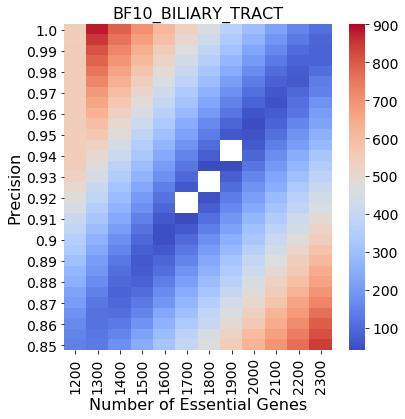

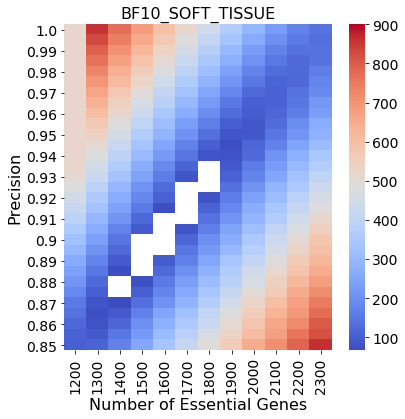

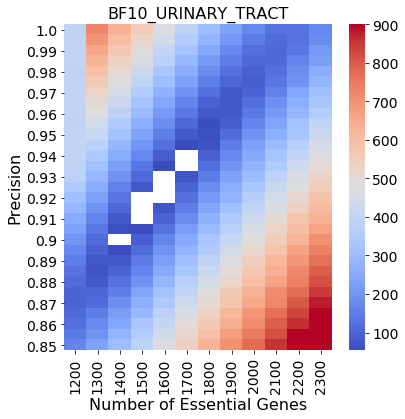

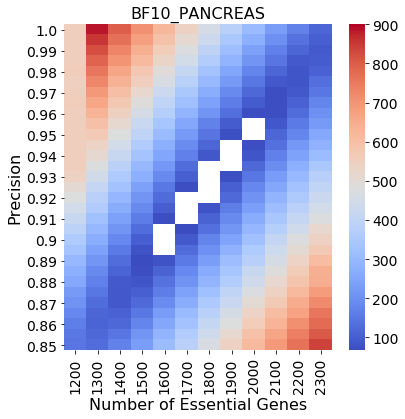

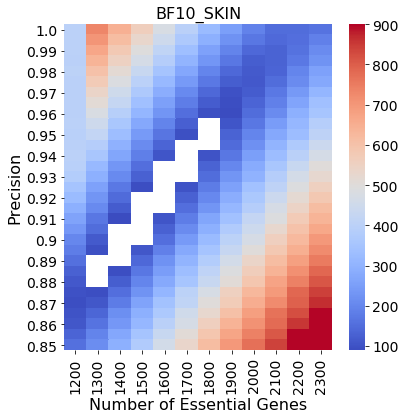

...

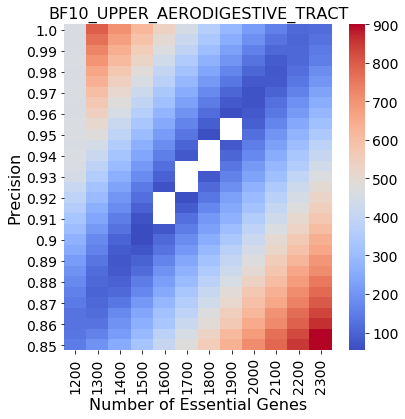

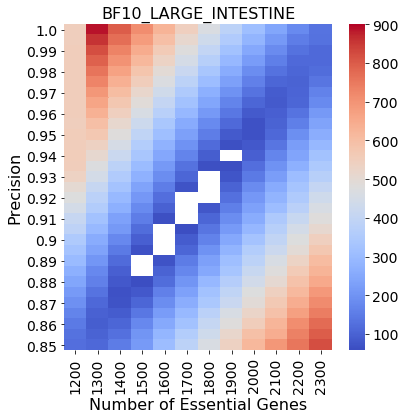

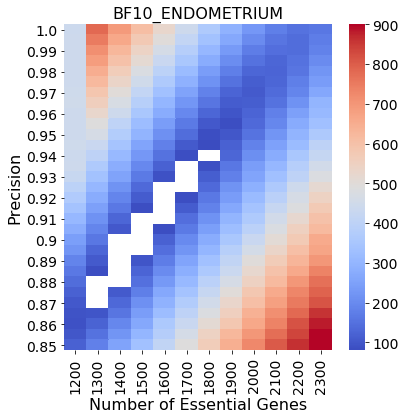

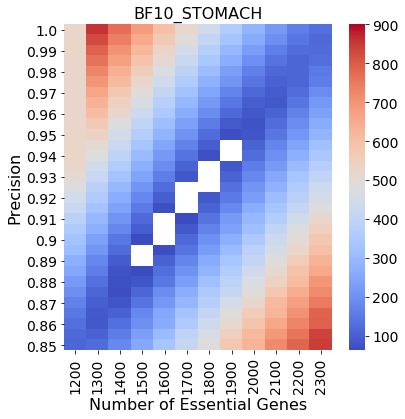

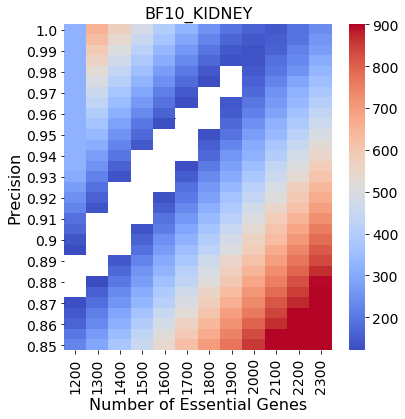

In [59]:
figsize(6,6)
for i in tissue_names:
    
    sns.heatmap(globals()['BF10_df_rmse_FDR_%s' % i].sort_index( ascending=False).iloc[:,1:], cmap="coolwarm", 
                vmin=globals()['BF10_df_rmse_FDR_%s' % i].iloc[:,1:].min().min()*2, vmax=900)
    
    title('BF10_%s' % i, size=16)
    xticks(rotation=90, size=14)
    ylabel('Precision', size=16)
    xlabel('Number of Essential Genes', size=16)
    yticks(size=14)
    savefig("./model_figs_FIG1/BF10_"+ i + "_2xRMSE"+ ".png", format="png", dpi=350, bbox_inches='tight')
    savefig("./model_figs_FIG1/BF10_"+ i + "_2xRMSE"+ ".pdf", format="pdf", bbox_inches='tight')
    plt.show()

In [60]:
best_BF10=dict()
for i in tissue_names:
    
    best_BF10[i]=(globals()['BF10_df_rmse_FDR_%s' % i].min().idxmin() , globals()['BF10_df_rmse_FDR_%s' % i][globals()['BF10_df_rmse_FDR_%s' % i].min().idxmin()].idxmin(), globals()['BF10_df_rmse_FDR_%s' % i].min().min() )




In [61]:
best_BF10

{'BILIARY_TRACT': (1800, 0.93, 20.092714164592078),
 'SOFT_TISSUE': (1600, 0.905, 33.239979693134636),
 'URINARY_TRACT': (1600, 0.925, 26.840856916275975),
 'PANCREAS': (1800, 0.925, 33.317026240347445),
 'SKIN': (1500, 0.91, 44.543060767082395),
 'CENTRAL_NERVOUS_SYSTEM': (1600, 0.93, 21.188138485954806),
 'BREAST': (1700, 0.92, 36.50808609061836),
 'LUNG': (1700, 0.915, 30.859418740475363),
 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE': (1800, 0.905, 22.492639629443246),
 'BONE': (1400, 0.905, 80.83307336727957),
 'OVARY': (1900, 0.93, 38.326844541391594),
 'OESOPHAGUS': (1700, 0.93, 27.352859768221663),
 'LIVER': (1600, 0.92, 36.015504300231555),
 'UPPER_AERODIGESTIVE_TRACT': (1700, 0.93, 26.756957039244945),
 'LARGE_INTESTINE': (1700, 0.915, 28.767616993765703),
 'ENDOMETRIUM': (1500, 0.905, 39.76378455957131),
 'STOMACH': (1700, 0.92, 31.18746543084256),
 'KIDNEY': (1500, 0.925, 60.48902204119355)}

In [62]:
#saves image
def cumulative_plot_zoomed_8_screens_BEST_FIT(numSamples, cumulative_counts, labels, tissue_names):
    
    numSamples=arange(numSamples)
    figure( figsize(5,5))
    for i, j in zip(cumulative_counts,labels):
        plot( arange(1,9), i , label= j, marker='o', markersize=3) 
    plt.errorbar(arange(1,9), globals()['%s_cumulatives_means' % tissue_names], yerr=globals()['%s_cumulatives_stds' % tissue_names],  color='r', marker='o', lw=1, capsize=3, capthick=1, ecolor='red', label="Avana " +tissue_names )
    #plot( numSamples, breast_cumulatives.mean(axis=0) , color= 'r', marker='o', markersize=2, label='Avana Top 8 Screens') #bu eklendi
    title("BF10_" + tissue_names , size=16)
    xlim(0,9)
    
    xticks(arange(1,9),[1,2,3,4,5,6,7,8],size=14)
   
    ylim(850,3200) 
    yticks(size=14)
    xlabel('Screen rank', size=16) 
    ylabel('Cumulative essentials', size=16) 
    #title('Cumulative essentials with FDR 10%')
    
    legend()
    savefig("./model_figs_FIG1/BF10_" + tissue_names+ "best_fit"+".png", format='png', dpi=350, bbox_inches='tight')
    savefig("./model_figs_FIG1/BF10_" + tissue_names+ "best_fit"+".pdf", format='pdf', bbox_inches='tight')
    show()



In [63]:
def get_rmse_from_beginning_8_screens_MEAN_tissues_BESTFIT(num_genome, num_essential, list_of_precision, tissue_names, sample_num):
    
    list_cumulatives=list()
    labelss=list()
    names=list()
    
    for i in list_of_precision:
        #synthetic_genome_test = synthetic_gen_precision(num_genome, num_essential)
        list_cumulatives.append(cumulative_essential_genes_8_screens(synthetic_gen_precision_tissue_sample(num_genome, num_essential, i, sample_num))) #make list of cumul. essentials
        labelss.append(i)
        
        rms=dict()
        names.append(i)
        
        our_data_mean=globals()['%s_cumulatives_means' % tissue_names]
        for j,k in zip(list(list_cumulatives), names):
            rmse=sqrt(mean_squared_error(j, our_data_mean))
            rms[k]=rmse   
        
    
    print (cumulative_plot_zoomed_8_screens_BEST_FIT(8, list_cumulatives, labelss, tissue_names))
    return rms

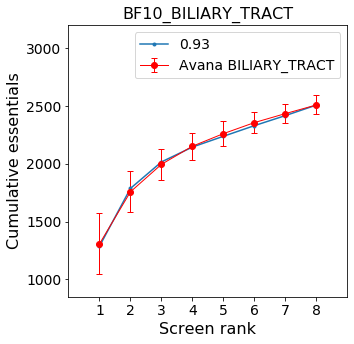

None


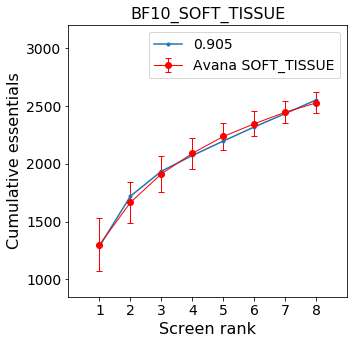

None


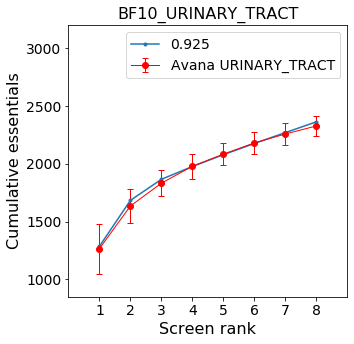

None


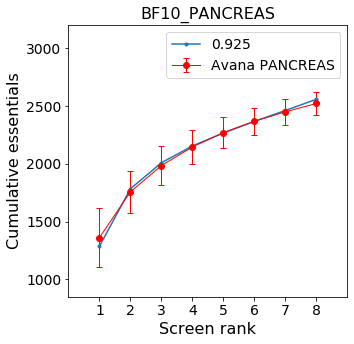

None


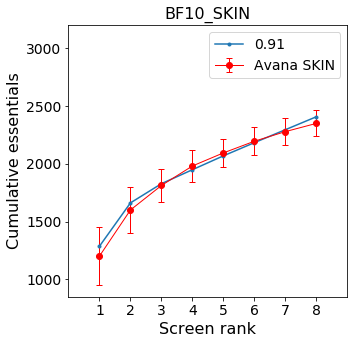

None


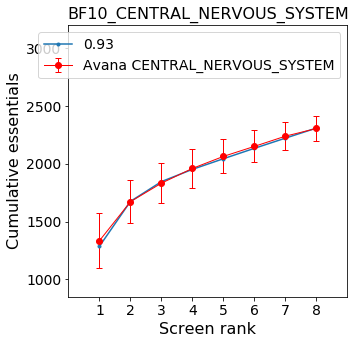

None


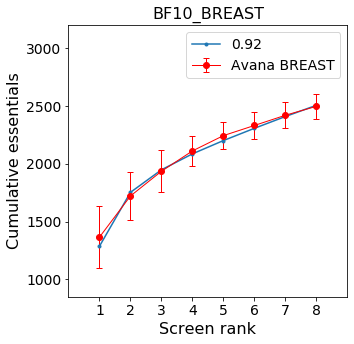

None


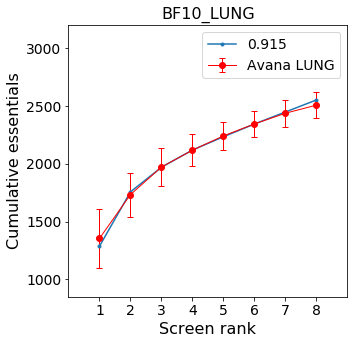

None


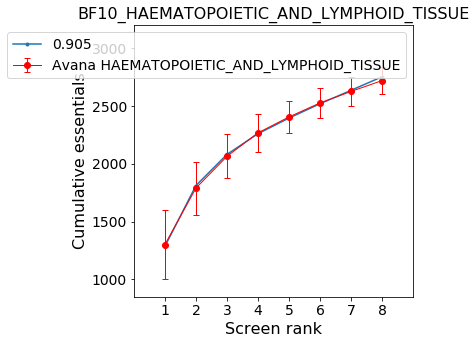

None


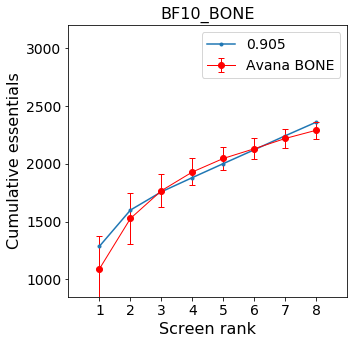

None


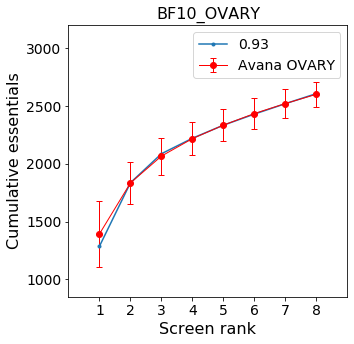

None


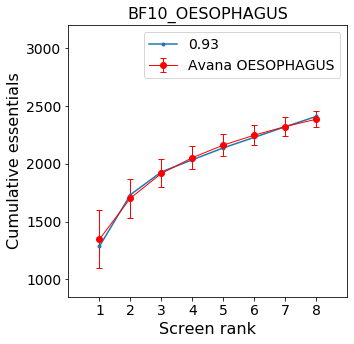

None


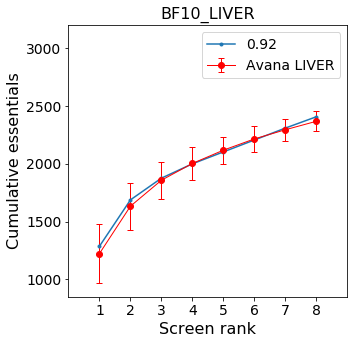

None


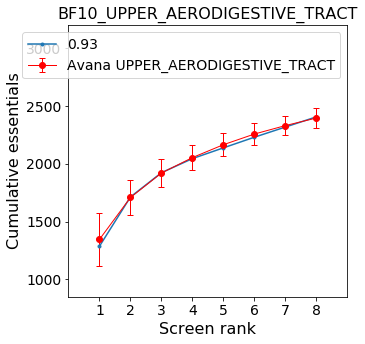

None


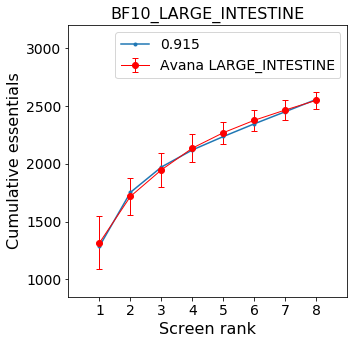

None


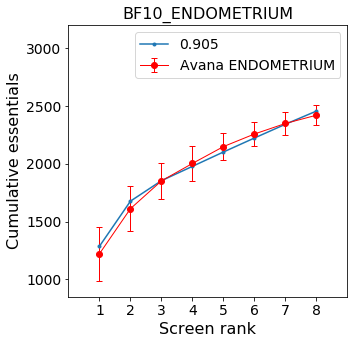

None


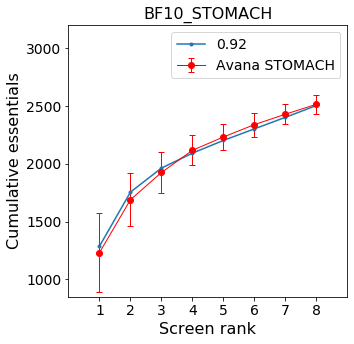

None


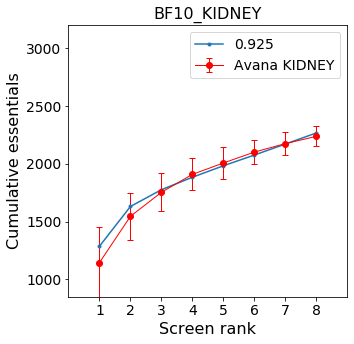

None


In [64]:
for i in best_BF10 :
      get_rmse_from_beginning_8_screens_MEAN_tissues_BESTFIT(18111, best_BF10[i][0], (float(best_BF10[i][1]), ), i, 1287)
        
        

In [65]:
best_BF10

{'BILIARY_TRACT': (1800, 0.93, 20.092714164592078),
 'SOFT_TISSUE': (1600, 0.905, 33.239979693134636),
 'URINARY_TRACT': (1600, 0.925, 26.840856916275975),
 'PANCREAS': (1800, 0.925, 33.317026240347445),
 'SKIN': (1500, 0.91, 44.543060767082395),
 'CENTRAL_NERVOUS_SYSTEM': (1600, 0.93, 21.188138485954806),
 'BREAST': (1700, 0.92, 36.50808609061836),
 'LUNG': (1700, 0.915, 30.859418740475363),
 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE': (1800, 0.905, 22.492639629443246),
 'BONE': (1400, 0.905, 80.83307336727957),
 'OVARY': (1900, 0.93, 38.326844541391594),
 'OESOPHAGUS': (1700, 0.93, 27.352859768221663),
 'LIVER': (1600, 0.92, 36.015504300231555),
 'UPPER_AERODIGESTIVE_TRACT': (1700, 0.93, 26.756957039244945),
 'LARGE_INTESTINE': (1700, 0.915, 28.767616993765703),
 'ENDOMETRIUM': (1500, 0.905, 39.76378455957131),
 'STOMACH': (1700, 0.92, 31.18746543084256),
 'KIDNEY': (1500, 0.925, 60.48902204119355)}

In [66]:
BREAST_cumulatives_means[0]

1365.49

In [67]:
import ast

In [68]:
best_BF10['BREAST'][0]

1700

In [69]:
'''tissue_names=['BILIARY_TRACT', 'SOFT_TISSUE', 'URINARY_TRACT', 'PANCREAS', 'SKIN',
             'CENTRAL_NERVOUS_SYSTEM', 'BREAST', 'LUNG', 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE',
             'BONE', 'OVARY', 'OESOPHAGUS', 'LIVER','UPPER_AERODIGESTIVE_TRACT',
             'LARGE_INTESTINE', 'ENDOMETRIUM', 'STOMACH', 'KIDNEY']
'''

"tissue_names=['BILIARY_TRACT', 'SOFT_TISSUE', 'URINARY_TRACT', 'PANCREAS', 'SKIN',\n             'CENTRAL_NERVOUS_SYSTEM', 'BREAST', 'LUNG', 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE',\n             'BONE', 'OVARY', 'OESOPHAGUS', 'LIVER','UPPER_AERODIGESTIVE_TRACT',\n             'LARGE_INTESTINE', 'ENDOMETRIUM', 'STOMACH', 'KIDNEY']\n"

In [70]:
false_neg_rate_bf10=dict()
for i in tissue_names:
    FN=(best_BF10[i][0]- globals()['%s_cumulatives_means' % i][0]) #FNR= FN / (TP +FN)
    false_neg_rate_bf10[i]=(FN / (globals()['%s_cumulatives_means' % i][0] + FN))

In [71]:
false_neg_rate_bf10

{'BILIARY_TRACT': 0.27376666666666666,
 'SOFT_TISSUE': 0.18769374999999996,
 'URINARY_TRACT': 0.20847499999999997,
 'PANCREAS': 0.24322777777777774,
 'SKIN': 0.19885999999999998,
 'CENTRAL_NERVOUS_SYSTEM': 0.16573125000000005,
 'BREAST': 0.1967705882352941,
 'LUNG': 0.2032647058823529,
 'HAEMATOPOIETIC_AND_LYMPHOID_TISSUE': 0.27658888888888883,
 'BONE': 0.22012142857142863,
 'OVARY': 0.2665368421052632,
 'OESOPHAGUS': 0.2074352941176471,
 'LIVER': 0.23518749999999997,
 'UPPER_AERODIGESTIVE_TRACT': 0.20817647058823535,
 'LARGE_INTESTINE': 0.22543529411764707,
 'ENDOMETRIUM': 0.1853066666666667,
 'STOMACH': 0.2757352941176471,
 'KIDNEY': 0.23636666666666664}

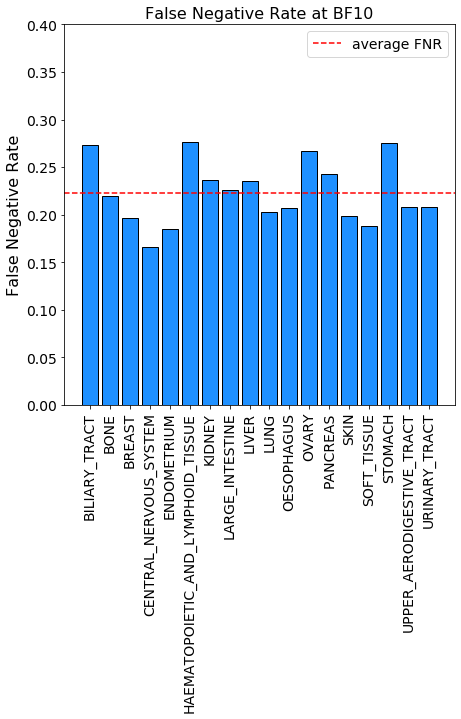

In [72]:
figsize(7,7)




lists = sorted(false_neg_rate_bf10.items()) # sorted by key, return a list of tuples

x, y = zip(*lists) # unpack a list of pairs into two tuples

plt.bar(x, y, align='center', color='dodgerblue', edgecolor='k')
xticks( size=14, rotation=90)
plt.axhline(y= asarray(y).mean(), color='r', linestyle='--', label='average FNR')

title('False Negative Rate at BF10', size=16)
ylim(0,0.4)
ylabel('False Negative Rate', size=16)
legend()
savefig("./model_figs_FIG1/FNR_BF10.png", format='png', dpi=350, bbox_inches='tight')
savefig("./model_figs_FIG1/FNR_BF10.pdf", format='pdf', bbox_inches='tight')
    

In [73]:
asarray(y).mean()

0.22303778246678785

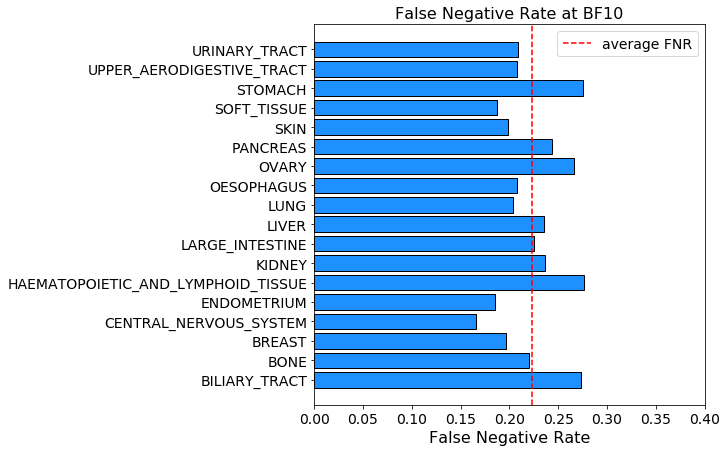

In [74]:
figsize(7,7)




lists = sorted(false_neg_rate_bf10.items()) # sorted by key, return a list of tuples

x, y = zip(*lists) # unpack a list of pairs into two tuples

barh(x, y, align='center', color='dodgerblue', edgecolor='k')
xticks( size=14)
plt.axvline(x= asarray(y).mean(), color='r', linestyle='--', label='average FNR')

title('False Negative Rate at BF10', size=16)
xlim(0,0.4)
xlabel('False Negative Rate', size=16)
legend()
    
savefig("./model_figs_FIG1/FNR_BF10_horizontal.png", format='png', dpi=350, bbox_inches='tight')
savefig("./model_figs_FIG1/FNR_BF10_horizontal.pdf", format='pdf', bbox_inches='tight')
    

In [75]:
# sort alphabetically

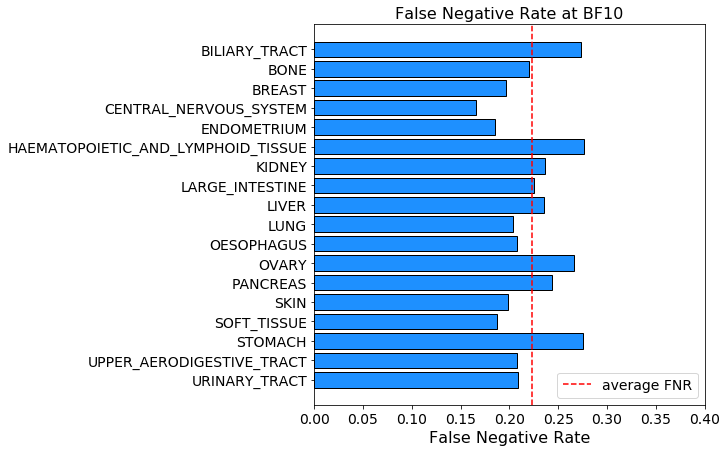

In [77]:
figsize(7,7)




lists = sorted(false_neg_rate_bf10.items()) # sorted by key, return a list of tuples

x, y = zip(*reversed(lists) )# unpack a list of pairs into two tuples

barh(x, y, align='center', color='dodgerblue', edgecolor='k')
xticks( size=14)
plt.axvline(x= asarray(y).mean(), color='r', linestyle='--', label='average FNR')

title('False Negative Rate at BF10', size=16)
xlim(0,0.4)
xlabel('False Negative Rate', size=16)
legend()
    
savefig("./model_figs_FIG1/FNR_BF10_horizontal_sorted.png", format='png', dpi=350, bbox_inches='tight')
savefig("./model_figs_FIG1/FNR_BF10_horizontal_sorted.pdf", format='pdf', bbox_inches='tight')
    

In [76]:
lists

[('BILIARY_TRACT', 0.27376666666666666),
 ('BONE', 0.22012142857142863),
 ('BREAST', 0.1967705882352941),
 ('CENTRAL_NERVOUS_SYSTEM', 0.16573125000000005),
 ('ENDOMETRIUM', 0.1853066666666667),
 ('HAEMATOPOIETIC_AND_LYMPHOID_TISSUE', 0.27658888888888883),
 ('KIDNEY', 0.23636666666666664),
 ('LARGE_INTESTINE', 0.22543529411764707),
 ('LIVER', 0.23518749999999997),
 ('LUNG', 0.2032647058823529),
 ('OESOPHAGUS', 0.2074352941176471),
 ('OVARY', 0.2665368421052632),
 ('PANCREAS', 0.24322777777777774),
 ('SKIN', 0.19885999999999998),
 ('SOFT_TISSUE', 0.18769374999999996),
 ('STOMACH', 0.2757352941176471),
 ('UPPER_AERODIGESTIVE_TRACT', 0.20817647058823535),
 ('URINARY_TRACT', 0.20847499999999997)]